In [1]:
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvas
from scipy.spatial import distance
import random
import pickle
from scipy import stats

# allow us to re-use the framework from the src directory
import sys, os
sys.path.append(os.path.abspath(os.path.join('../')))

save_path="/Users/aloreggia/Documents/img_experiment_neurips"

In [2]:
import max_ent.examples.grid_9_by_9 as G
from max_ent.gridworld import Directions
%matplotlib notebook
random.seed(123)
np.random.seed(123)

In [3]:
def conf_interval(array):
    mean, sigma = np.mean(array), np.std(array)
    N = len(array)
    conf_int_a = stats.norm.interval(0.7, loc=mean, scale=sigma/math.sqrt(N))
    #print(f"N: {N} \t Mean: {mean} \t Sigma: {sigma} \t conf_int: {conf_int_a}")
    return (conf_int_a[1] - conf_int_a[0])/2


In [4]:
def create_world(title, blue, green, cs=[], ca=[], cc=[], start=0, goal=8, vmin=-50, vmax=10):
    n_cfg = G.config_world(blue, green, cs, ca, cc, goal, start=start)
    n = n_cfg.mdp

    # Generate demonstrations and plot the world
    demo = G.generate_trajectories(n.world, n.reward, n.start, n.terminal)
    vmin = -50
    vmax = 10
    fig = G.plot_world(title, n, n_cfg.state_penalties,
           n_cfg.action_penalties, n_cfg.color_penalties,
           demo, n_cfg.blue, n_cfg.green, vmin=vmin, vmax=vmax)   
    return n, n_cfg, demo, fig

In [5]:
def total_reward(trajectory, world, nominal, constraints):
    grid = world.mdp
    grid_n =nominal.mdp
    reward = 0
    reward_n = 0
    count_cs = 0
    count_ca = 0
    count_cb = 0
    count_cg = 0
    for state in trajectory.transitions():
        #check for action constraints violation
        reward += grid.reward[state]
        reward_n += grid_n.reward[state]
        for constraint in constraints['ca']:
            if (state[1] == constraint.idx): 
                count_ca += 1
                
        #check for color constraints violation        
        for constraint in constraints['blue']:
            if (state[0] == constraint): 
                count_cb += 1
        
        #check for color constraints violation        
        for constraint in constraints['green']:
            if (state[0] == constraint): 
                count_cg += 1
                
        #check for state constraints violation
        for constraint in constraints['cs']:
            if (state[0] == constraint): 
                count_cs += 1
                
    return reward, reward_n, count_cs, count_ca, count_cb, count_cg
        

# calculate the kl divergence
def kl_divergence(p, q):
    p = np.reshape(p, (-1,1))
    q = np.reshape(q, (-1,1))
    return sum(p[i] * math.log2(p[i]/q[i]) for i in range(len(p)))
    
# calculate the js divergence
def js_divergence(p, q):
    p = np.reshape(p, (-1,1))
    q = np.reshape(q, (-1,1))
    m = 0.5 * (p + q)
    return 0.5 * kl_divergence(p, m) + 0.5 * kl_divergence(q, m)

#count how many times a state is visited, and compute the average length of the trajectories
# add nominal world -> compute the average nominal reward for the constrained trajectory
def count_states(trajectories, world, nominal, constraints):
    grid = world.mdp
    count_matrix = np.ones((9,9,8,9,9)) * 1e-10
    avg_length = 0.0
    avg_reward = 0.0
    avg_reward_n = 0.0
    avg_violated = 0.0
    avg_cs = 0.0
    avg_ca = 0.0
    avg_cb = 0.0
    avg_cg = 0.0
    n = len(trajectories)
    for trajectory in trajectories:
        avg_length += len(trajectory.transitions())
        #print(trajectory)
        #print(list(trajectory.transitions()))
        reward, reward_n, count_cs, count_ca, count_cb, count_cg = total_reward(trajectory, world, nominal, constraints)
        avg_reward += reward
        avg_reward_n += reward_n
        avg_violated += (count_cs + count_ca + count_cb + count_cg)
        avg_cs += count_cs
        avg_ca += count_ca
        avg_cb += count_cb
        avg_cg += count_cg
        for transition in trajectory.transitions():
            #print(state)
            state_s = transition[0]
            action = transition[1]
            state_t = transition[2]
            count_matrix[grid.world.state_index_to_point(state_s)][action][grid.world.state_index_to_point(state_t)] += 1
            
    return count_matrix / np.sum(count_matrix), avg_length / n, avg_reward / n, avg_reward_n / n, avg_violated/n, (avg_cs/n, avg_ca/n, avg_cb/n, avg_cg/n)

In [6]:
# check for distance between start and terminal states
def generate_constraints(size):
    
    list_available = [x for x in range(size ** 2)] #generate the list of non-constrained states

    blue = np.random.choice(list_available, 6) # blue states
    list_available = np.setdiff1d(list_available, blue) # remove blue states from the list of non-constrained states

    green = np.random.choice(list_available, 6) # green states
    list_available = np.setdiff1d(list_available, green) # remove green states from the list of non-constrained states

    cs = np.random.choice(list_available, 6) # constrained states
    list_available = np.setdiff1d(list_available, cs) # remove constrained states from the list of non-constrained states

    #print(blue)
    #print(green)
    #print(cs)
    #print(list_available)
    
    random_ca = np.random.choice(8, 2) # green states
    ca = [Directions.ALL_DIRECTIONS[d] for d in random_ca]
    #print(ca)

    generate = True
    while generate:
        start = random.choice(list_available) # generate start state from the list of non-constrained states 
        goal = random.choice(list_available) # generate terminal state from the list of non-constrained states
        
        start_x = start % size
        start_y = start // size

        goal_x = goal % size
        goal_y = goal // size
        
        if abs(start_x-goal_x) > 2 or abs(start_y-goal_y)>2: generate=False

    return blue, green, cs, ca, start, goal

# Nominal world

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

[LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


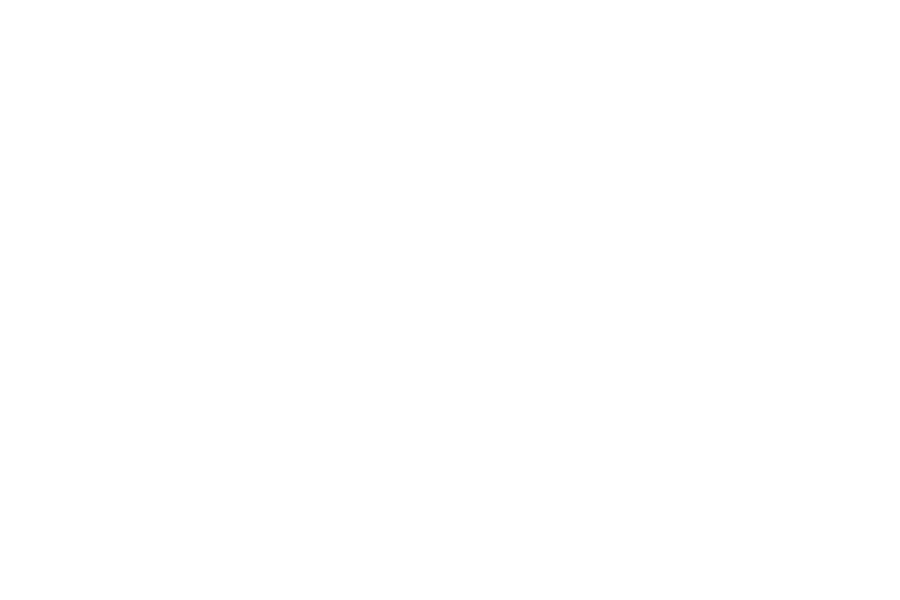

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.070544960865829
MAE(best):  0.011326614594949
MAE(best):  0.011168411053333
MAE(best):  0.010896088831049


<IPython.core.display.Javascript object>


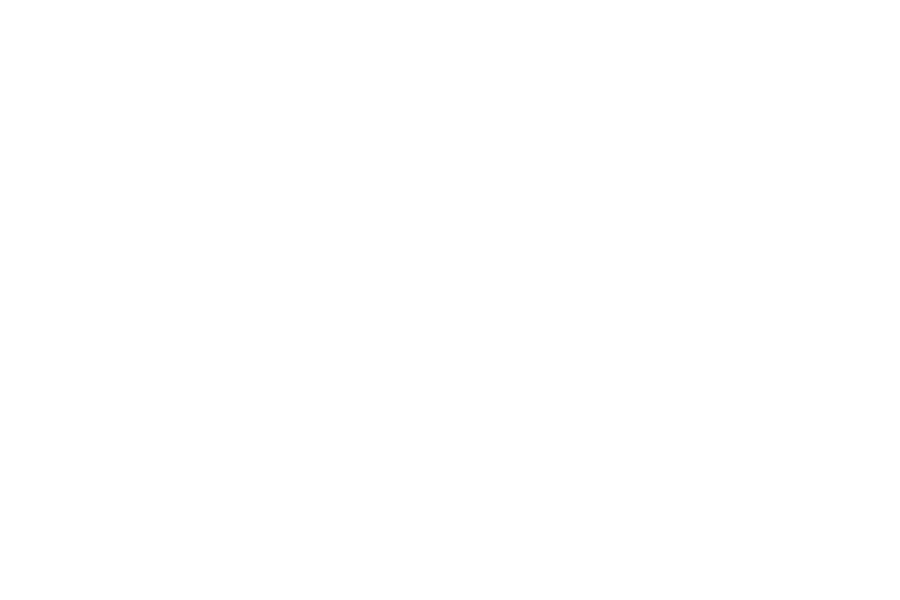

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 0


<IPython.core.display.Javascript object>

[UP, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


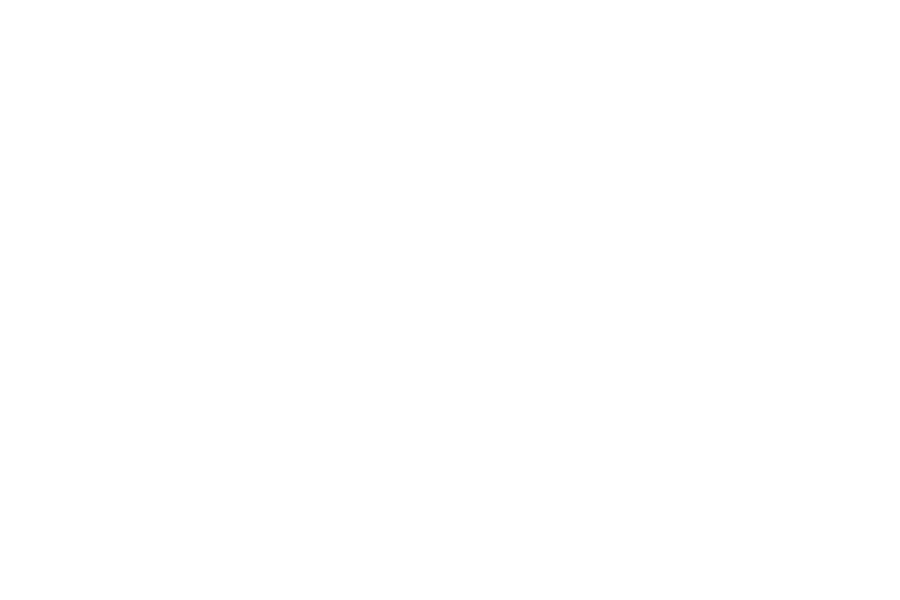

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  6.578431517098765


<IPython.core.display.Javascript object>


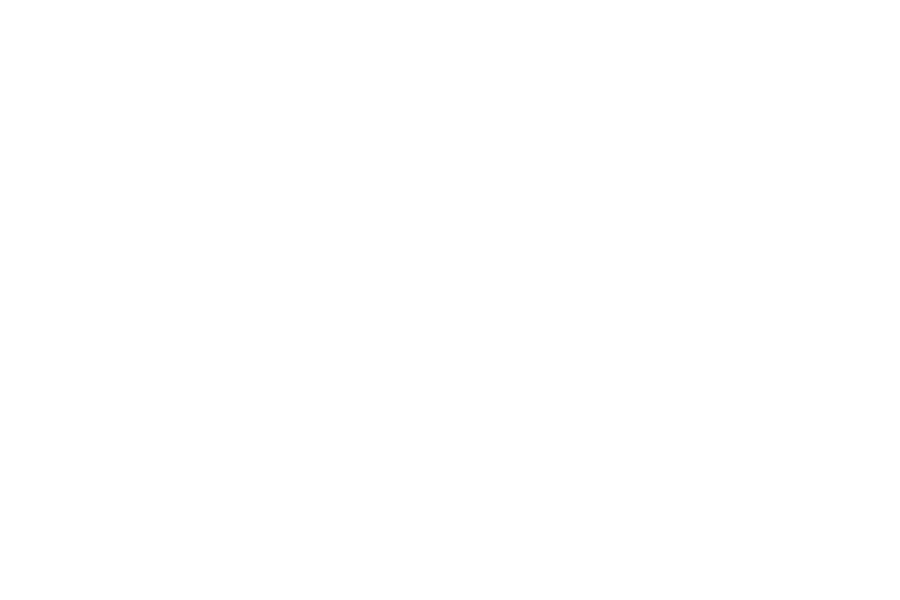

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 1


<IPython.core.display.Javascript object>

[DOWN, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


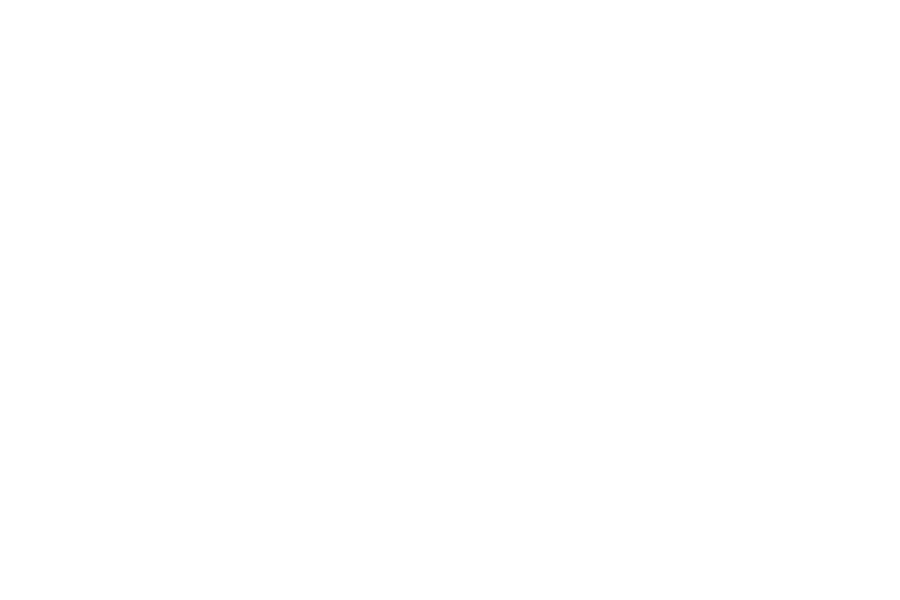

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.151372657244192
MAE(best):  0.096133433817337
MAE(best):  0.023173075689760
MAE(best):  0.014423576922781
MAE(best):  0.011345488683050


<IPython.core.display.Javascript object>


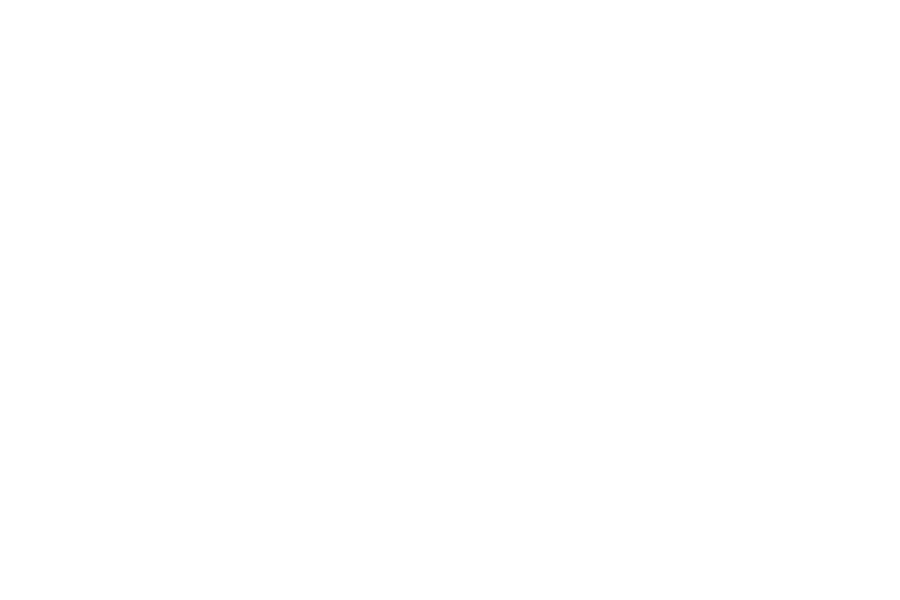

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 2


<IPython.core.display.Javascript object>

[RIGHT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


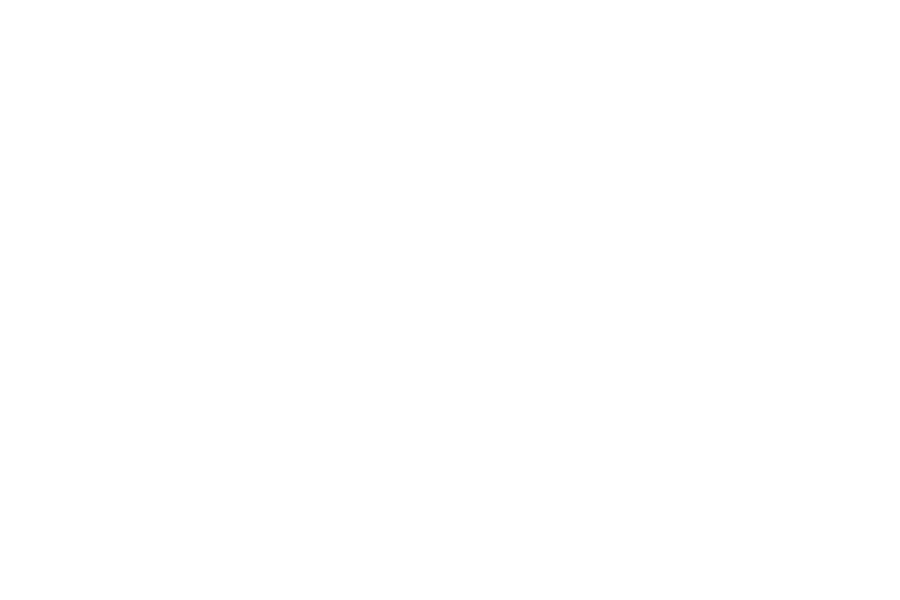

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.064922818283435
MAE(best):  0.036413234858454
MAE(best):  0.020326941020871
MAE(best):  0.015867800996052
MAE(best):  0.014307569390205


<IPython.core.display.Javascript object>


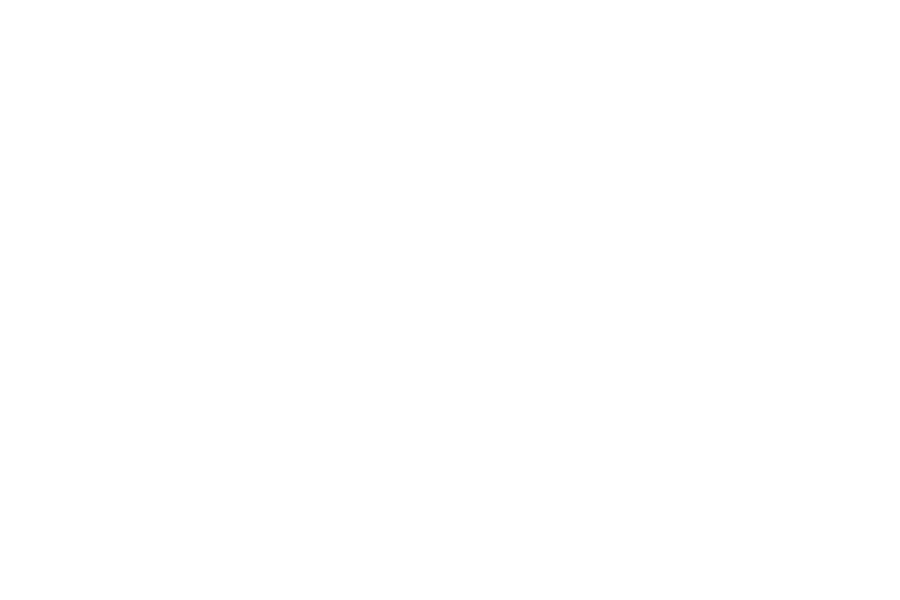

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 3


<IPython.core.display.Javascript object>

[DOWN, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


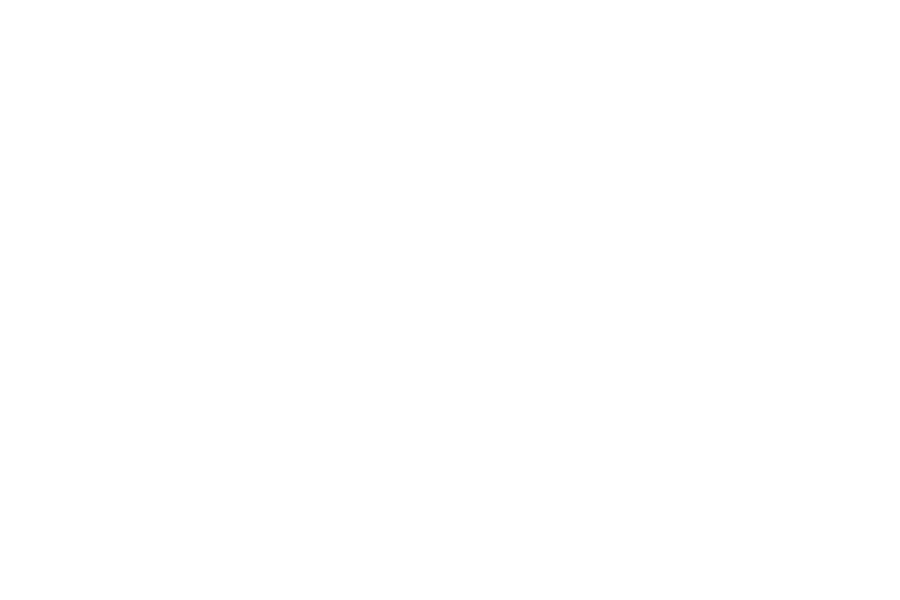

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.116177429180454
MAE(best):  0.026987645063526
MAE(best):  0.018044662304218
MAE(best):  0.012007050715662
MAE(best):  0.010408409339560


<IPython.core.display.Javascript object>


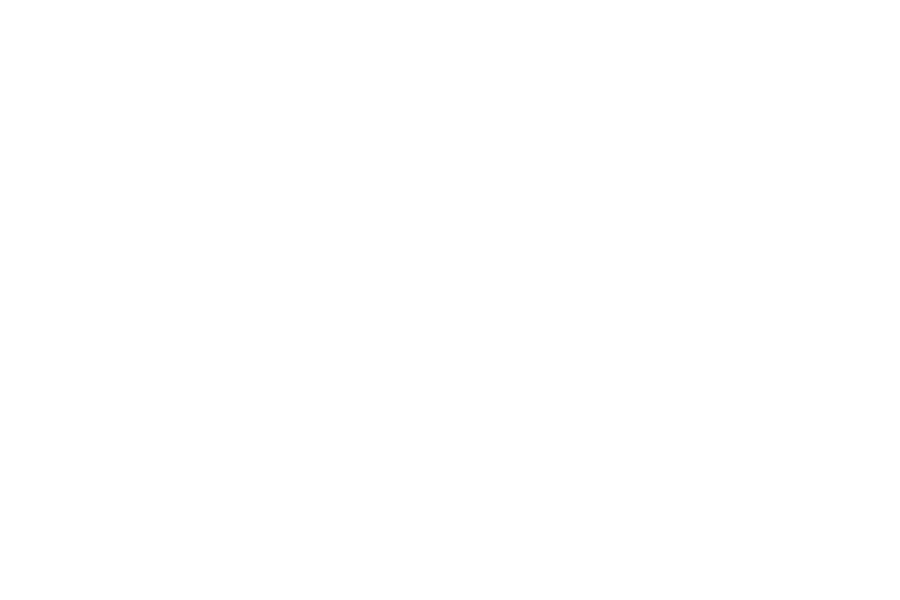

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 4


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


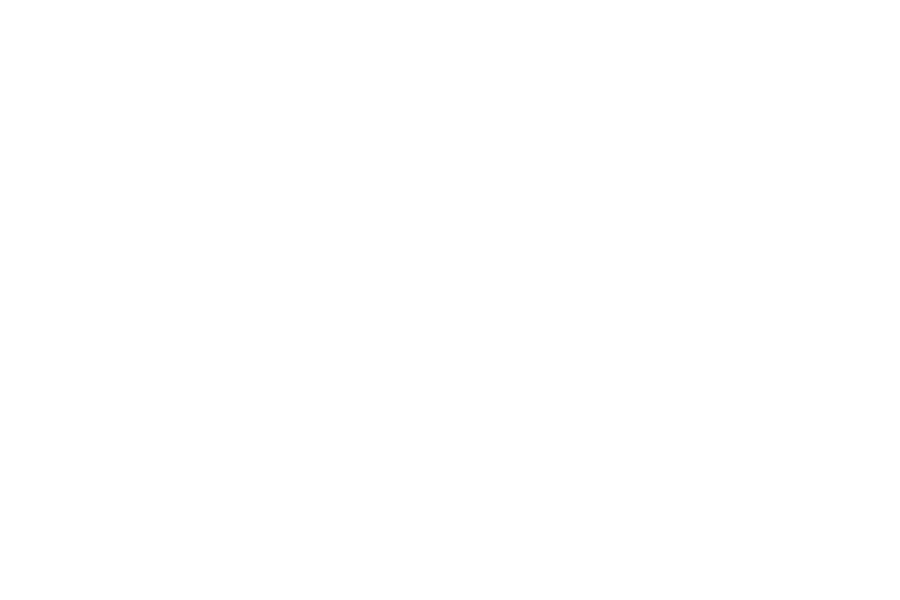

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.051539778403256
MAE(best):  0.031258401455507
MAE(best):  0.012346713530976
MAE(best):  0.011202661912734


<IPython.core.display.Javascript object>


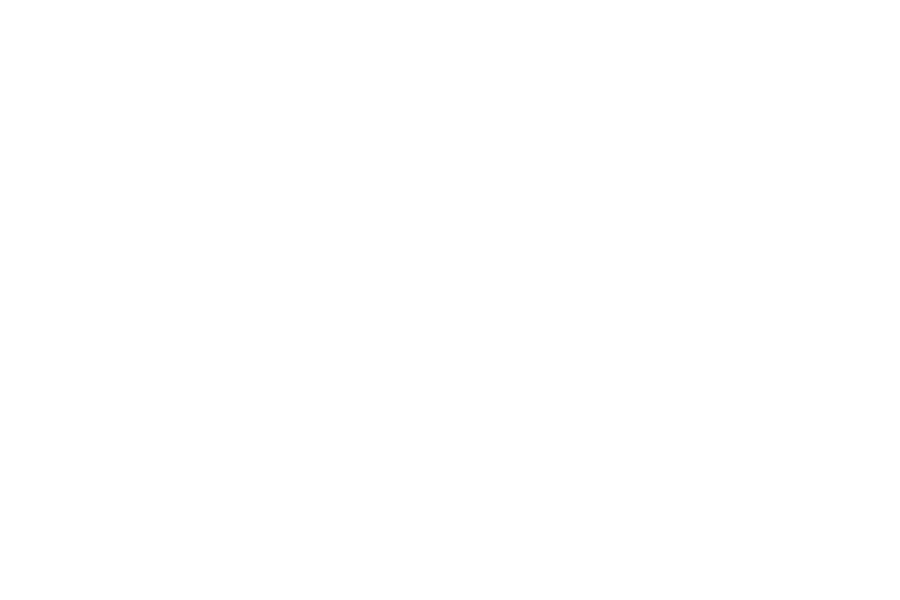

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 5


<IPython.core.display.Javascript object>

[LEFT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


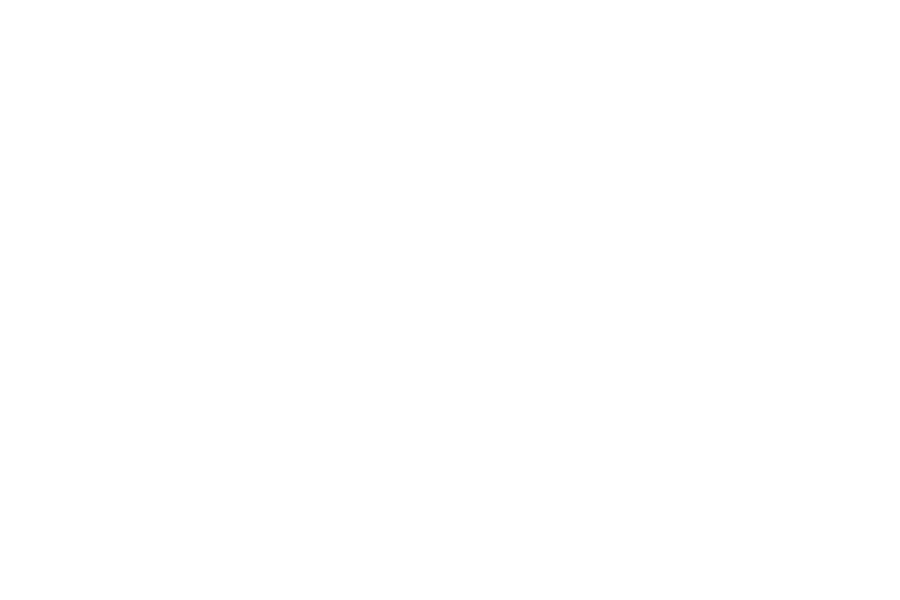

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.025013404217968
MAE(best):  0.024975417429037
MAE(best):  0.013024418046020


<IPython.core.display.Javascript object>


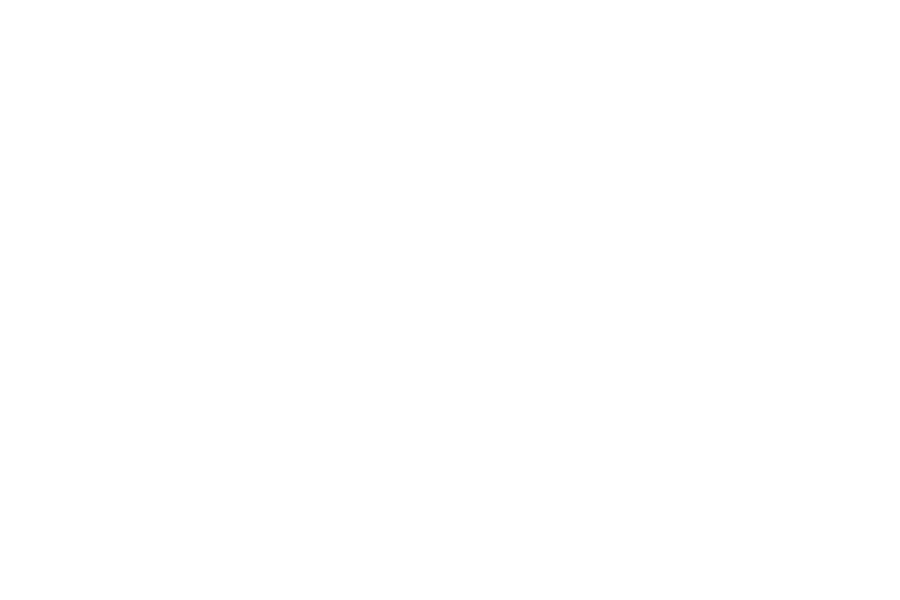

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 6


<IPython.core.display.Javascript object>

[UP_LEFT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


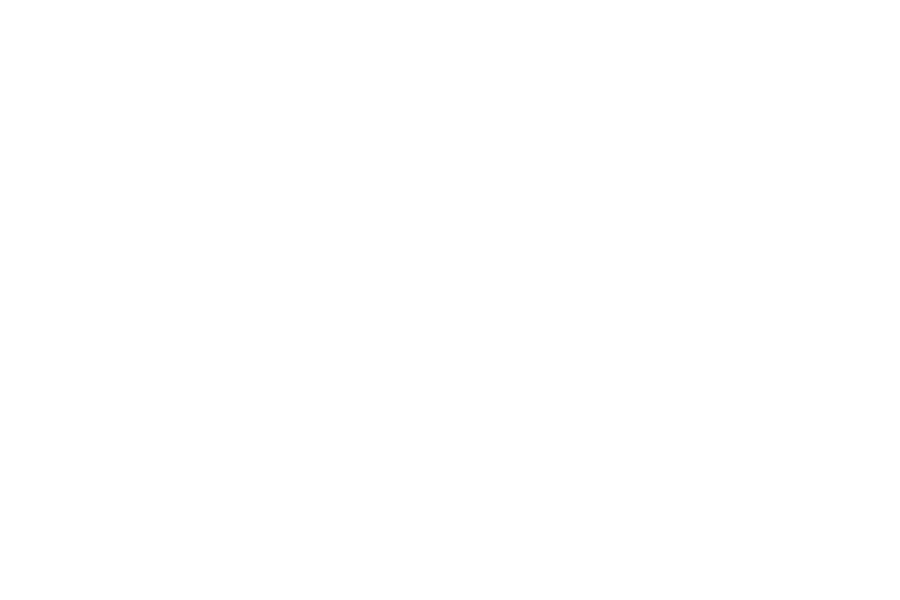

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.123428490831617
MAE(best):  0.061301591466629
MAE(best):  0.048242235888738
MAE(best):  0.035355503338867
MAE(best):  0.017183333941994


<IPython.core.display.Javascript object>


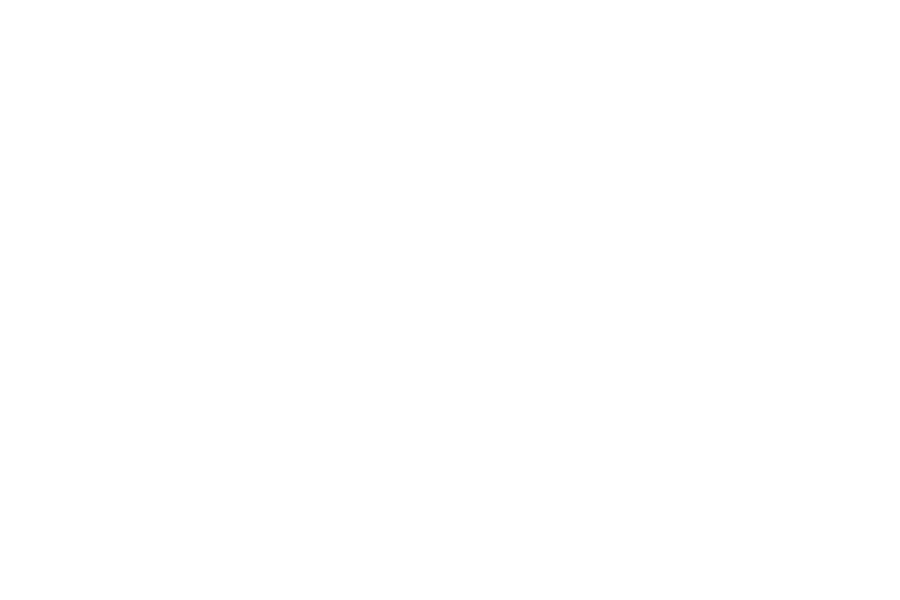

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 7


<IPython.core.display.Javascript object>

[UP_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


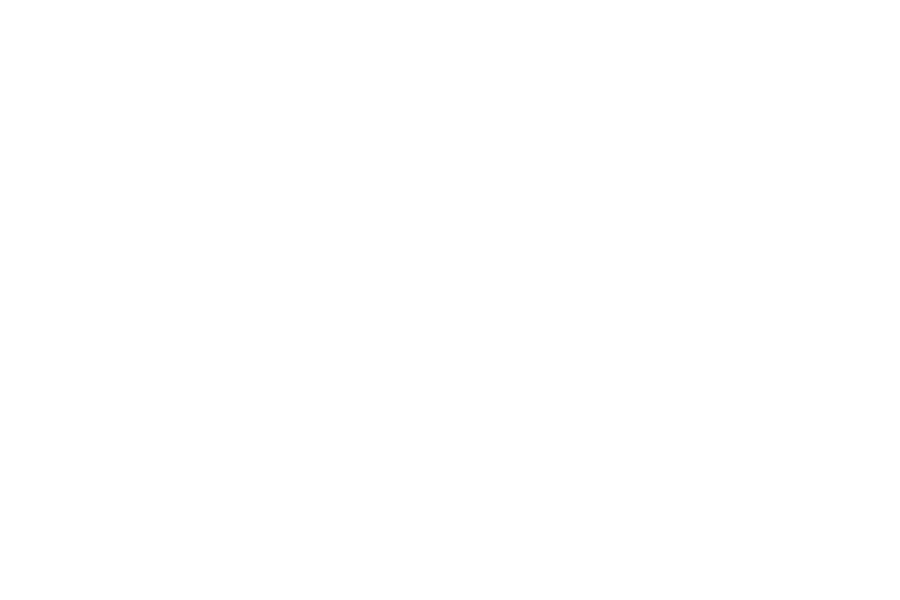

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.007440588876163


<IPython.core.display.Javascript object>


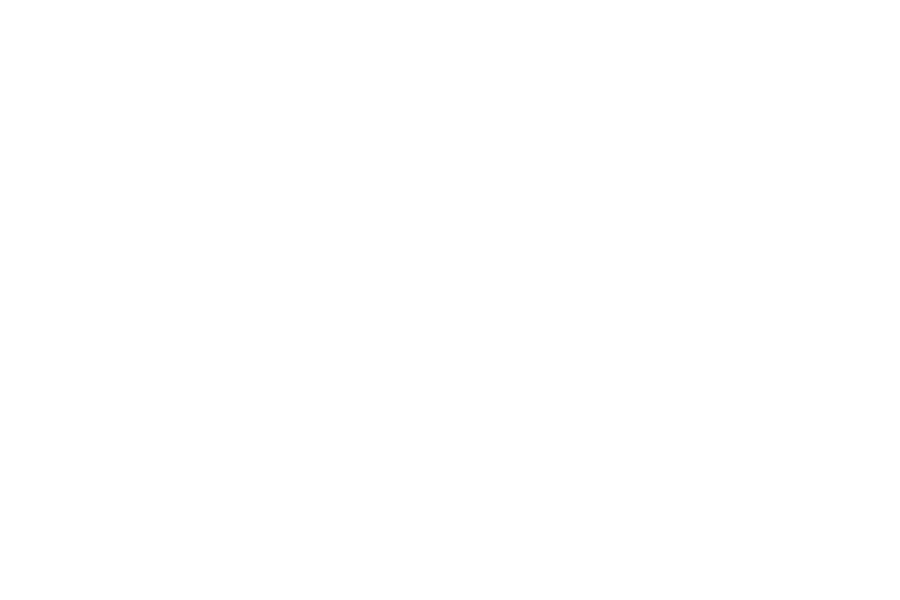

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 8


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


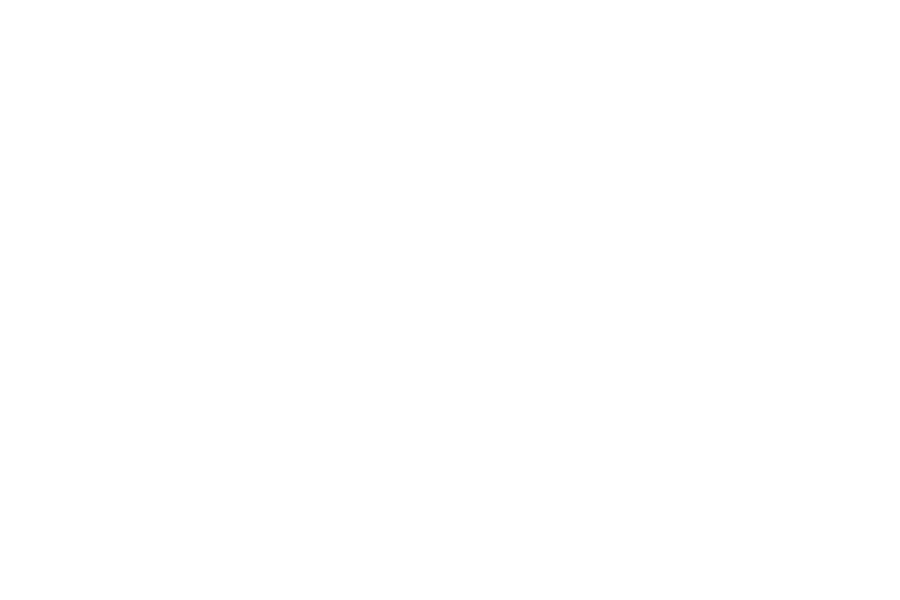

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.020123605174303


<IPython.core.display.Javascript object>


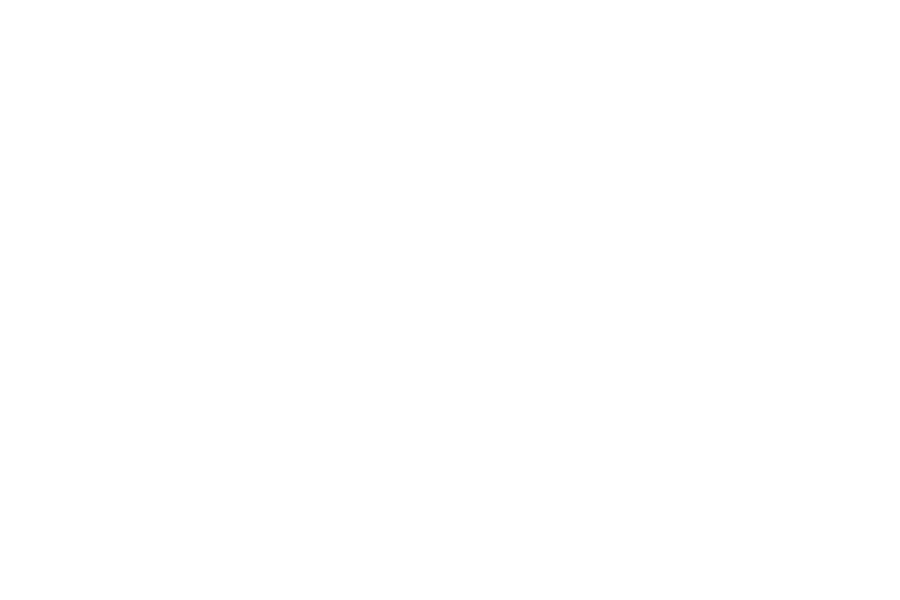

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 9


<IPython.core.display.Javascript object>

[UP, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


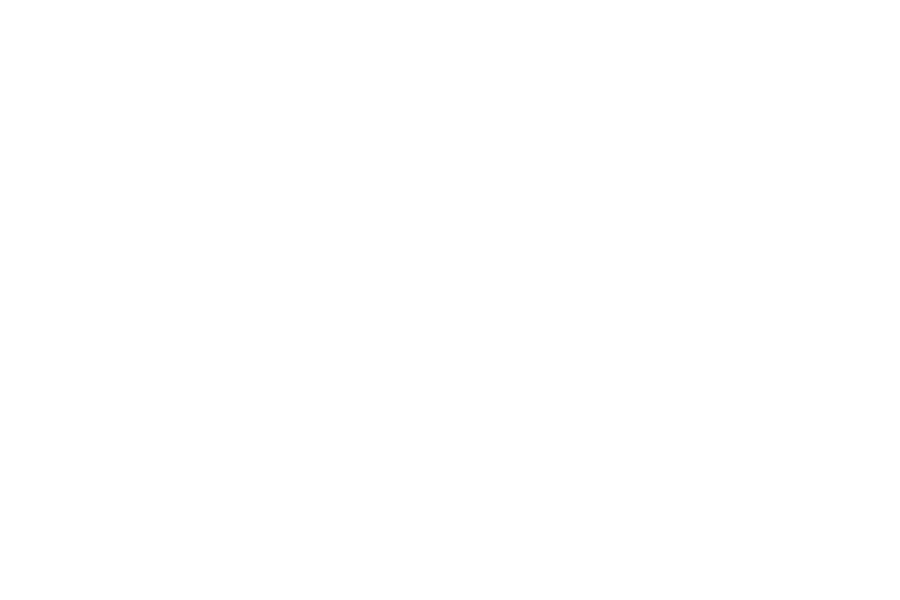

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  4.745923821682799
MAE(best):  4.745872101796474
MAE(best):  4.642011930656626
MAE(best):  4.620681278335445
MAE(best):  4.304816619399764


<IPython.core.display.Javascript object>


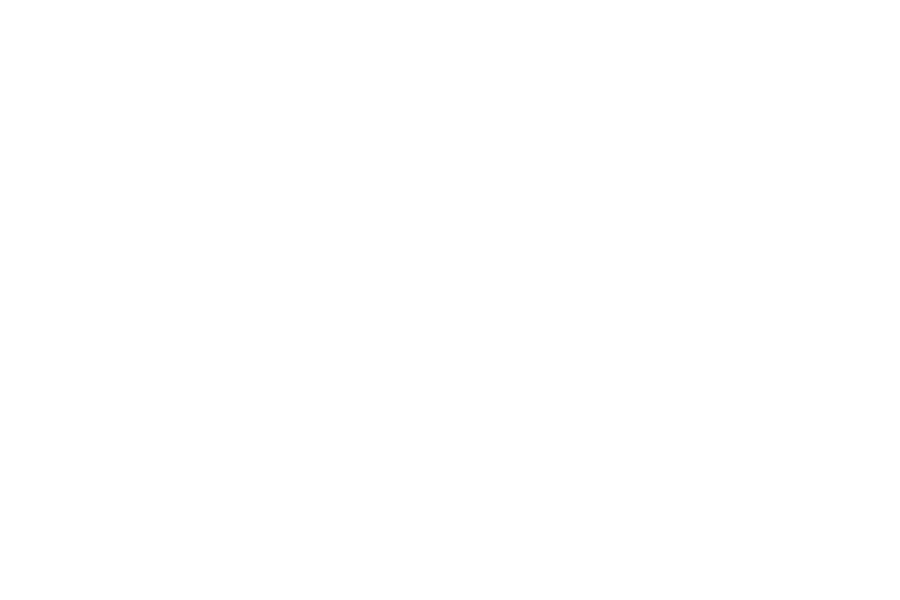

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 10


<IPython.core.display.Javascript object>

[DOWN, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


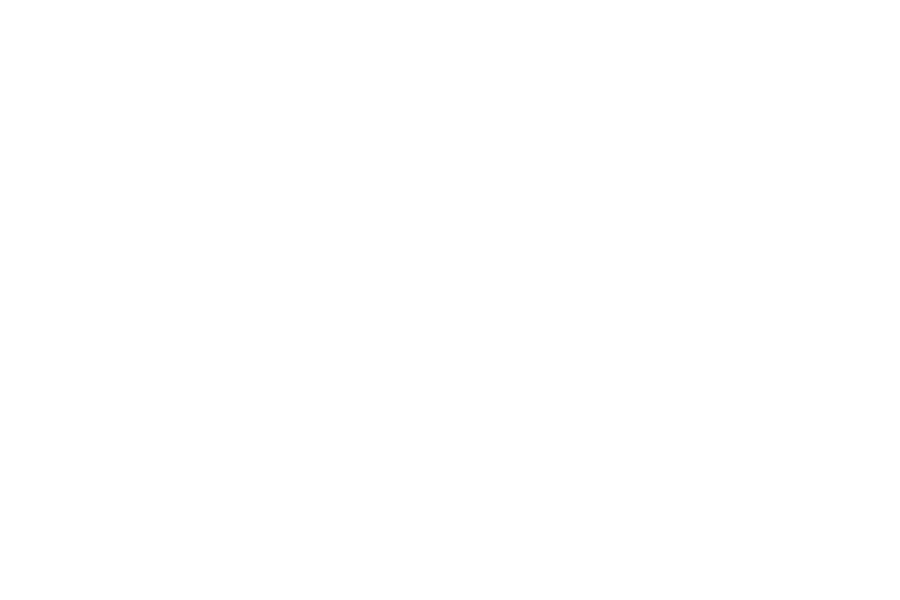

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.308264500226935
MAE(best):  0.077077640138396
MAE(best):  0.062582053322484
MAE(best):  0.040696942280002
MAE(best):  0.040617905847697


<IPython.core.display.Javascript object>


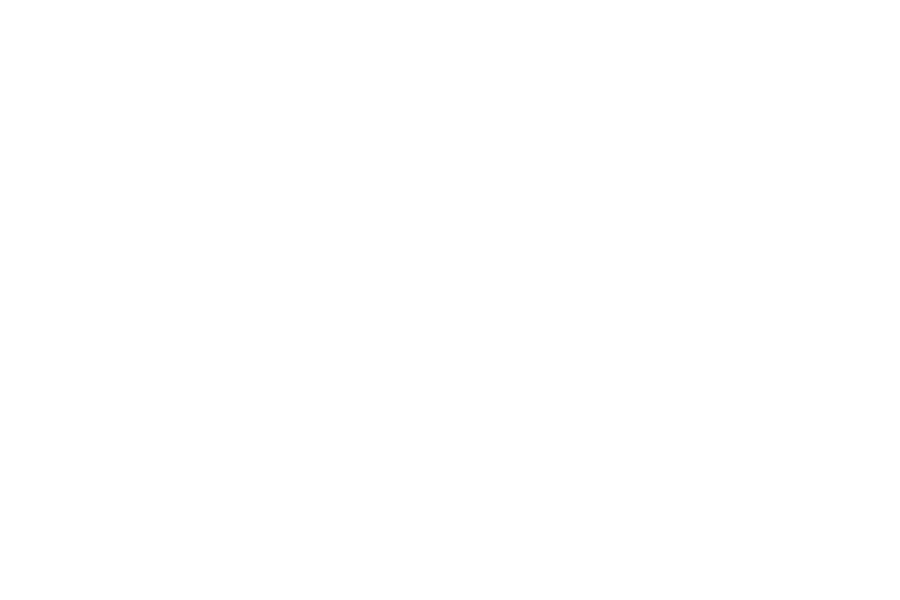

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 11


<IPython.core.display.Javascript object>

[LEFT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


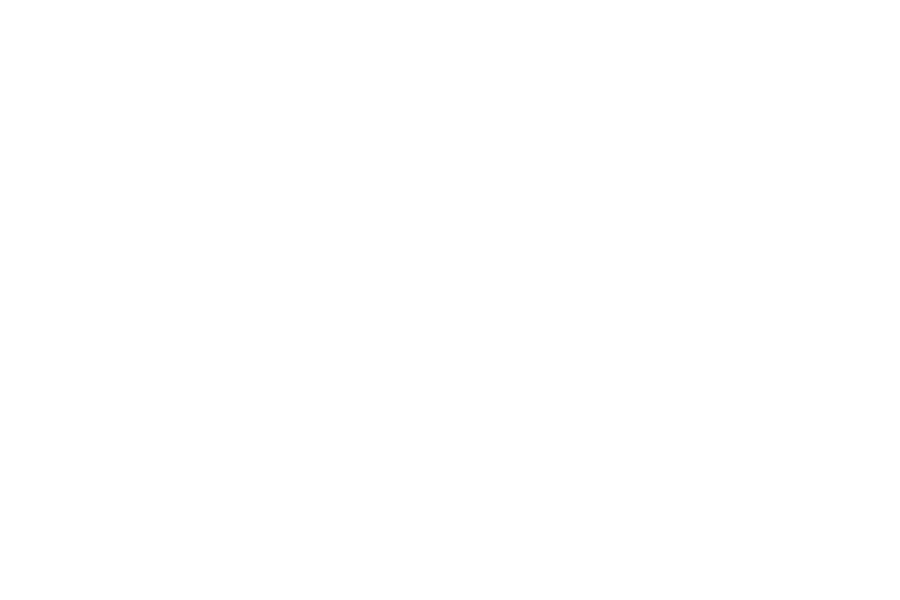

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.124071265300082
MAE(best):  0.052550532623561
MAE(best):  0.028551921203218
MAE(best):  0.016891897108011
MAE(best):  0.015135046849470


<IPython.core.display.Javascript object>


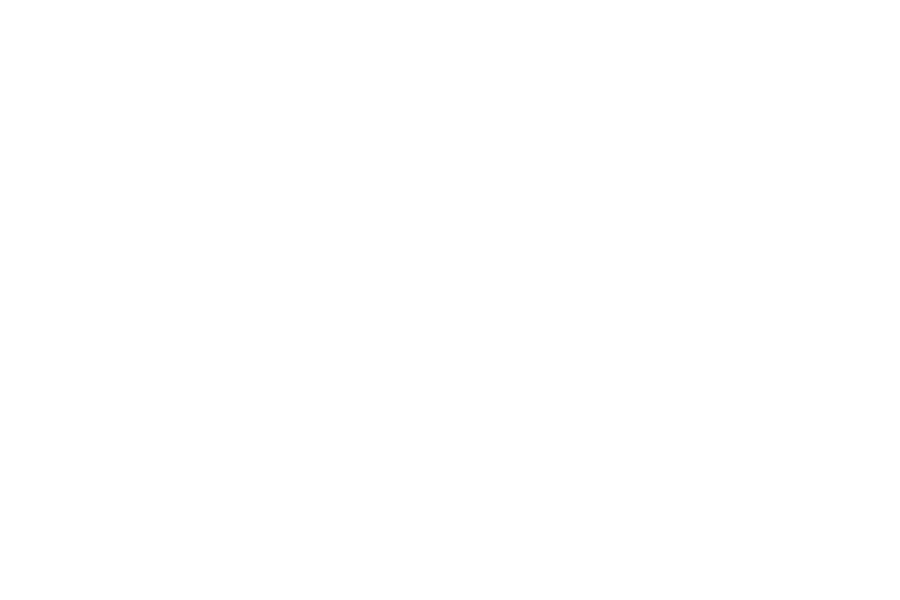

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 12


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


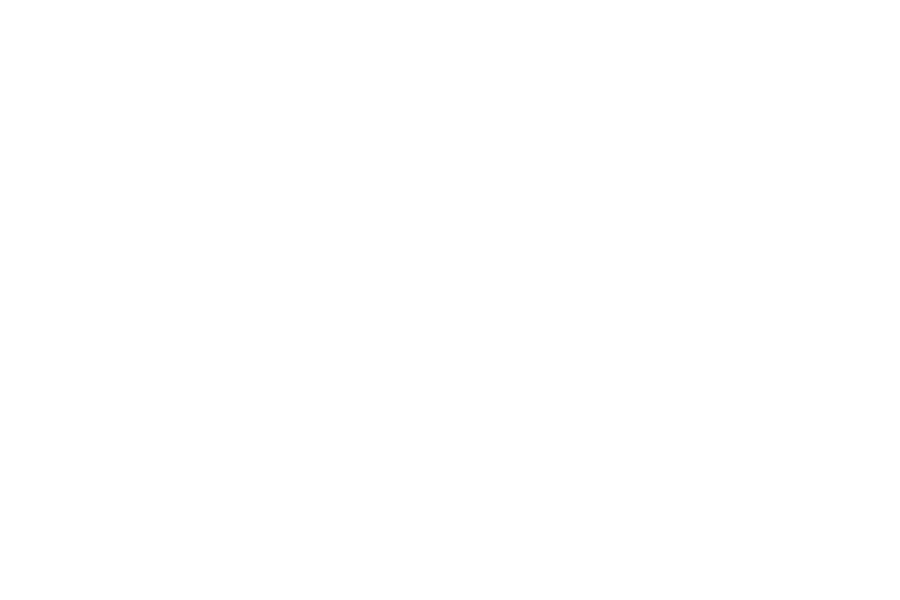

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.078793625644021


<IPython.core.display.Javascript object>


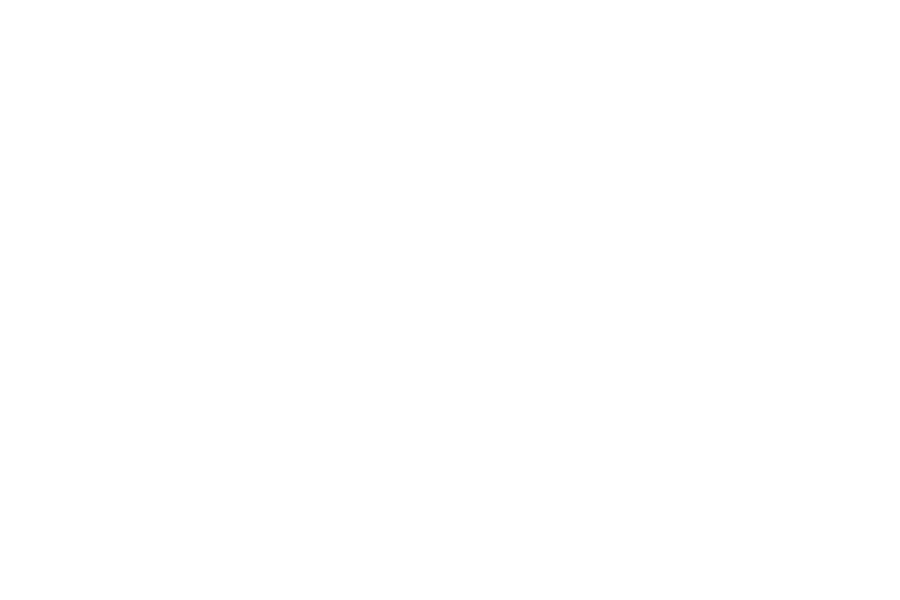

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 13


<IPython.core.display.Javascript object>

[LEFT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


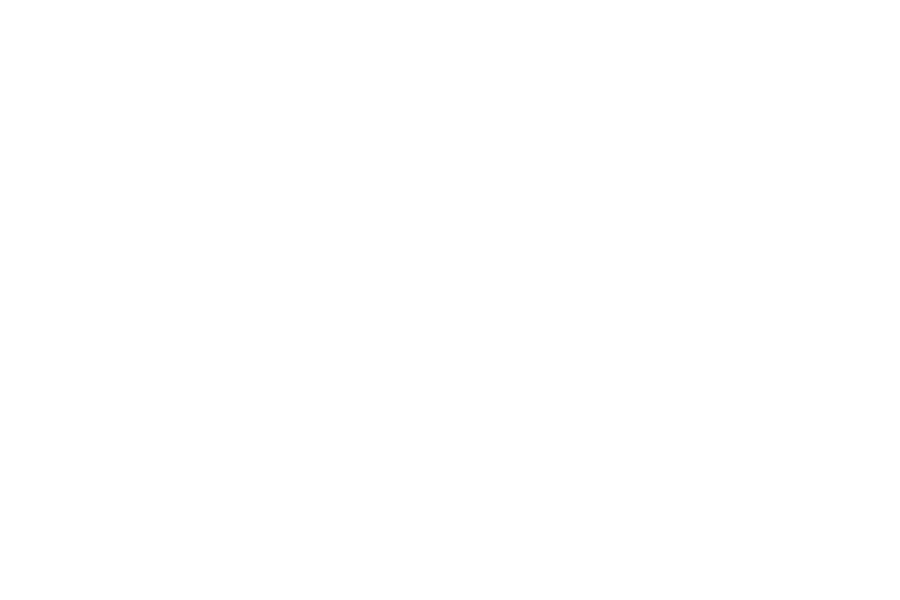

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.153425219040854
MAE(best):  0.030038598041797
MAE(best):  0.017288264784898
MAE(best):  0.010589874529986


<IPython.core.display.Javascript object>


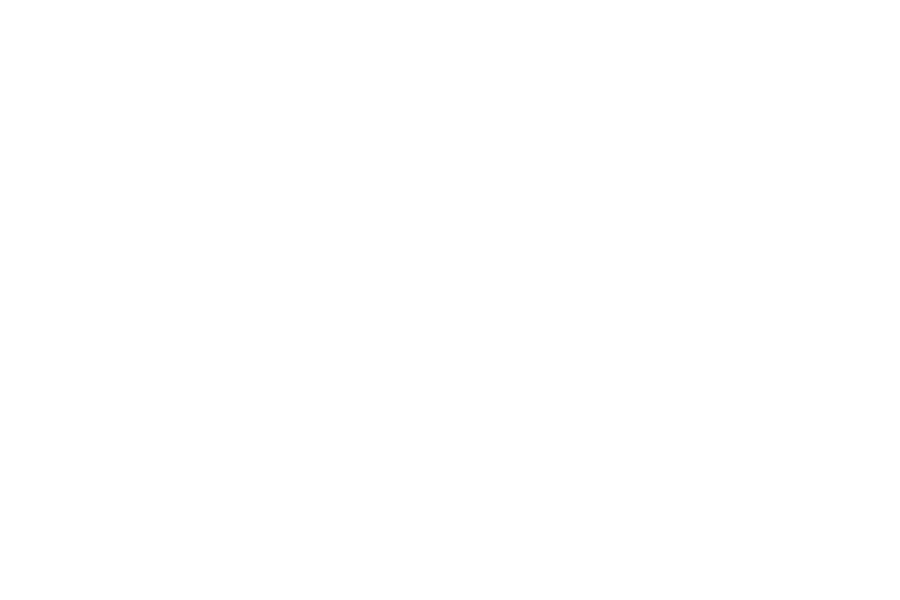

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 14


<IPython.core.display.Javascript object>

[UP_LEFT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


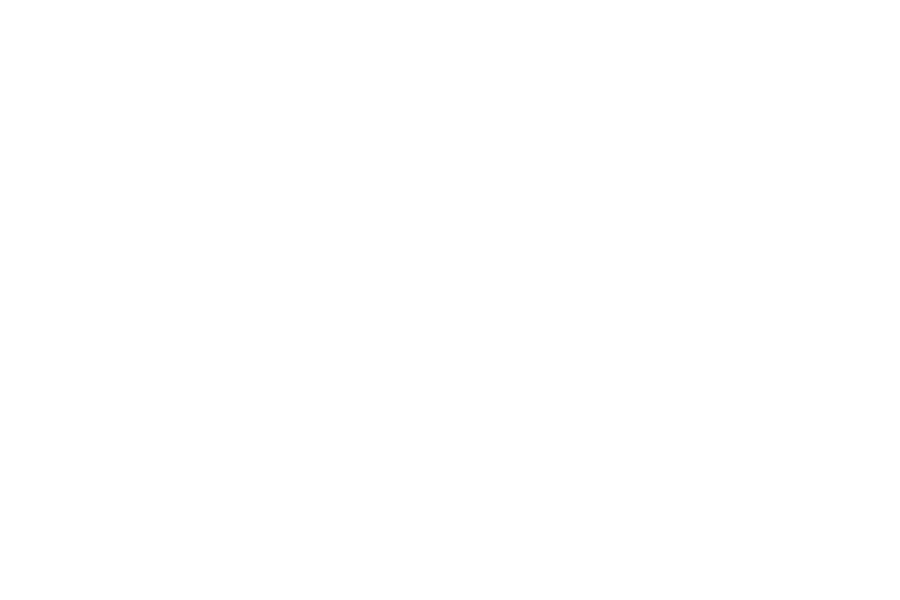

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.148642251478632
MAE(best):  0.105433313067902
MAE(best):  0.013991246729470
MAE(best):  0.012859452015040
MAE(best):  0.012139706510528


<IPython.core.display.Javascript object>


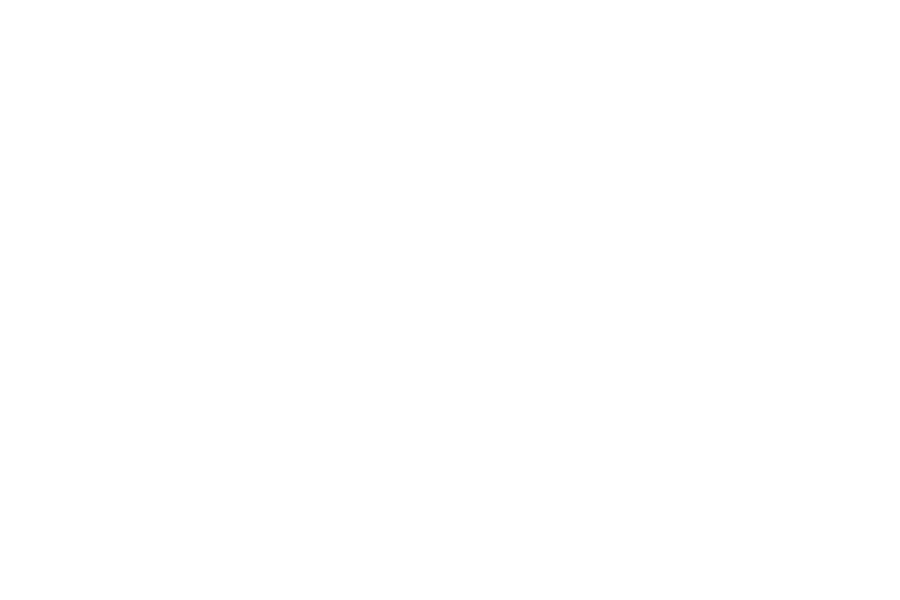

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 15


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


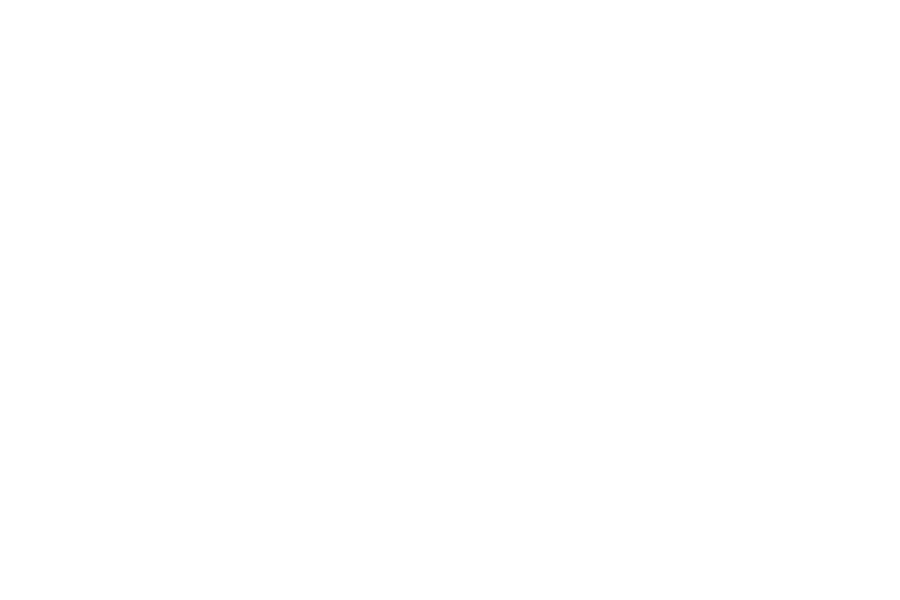

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.151711228177010
MAE(best):  0.054848364040507
MAE(best):  0.030559077470615


<IPython.core.display.Javascript object>


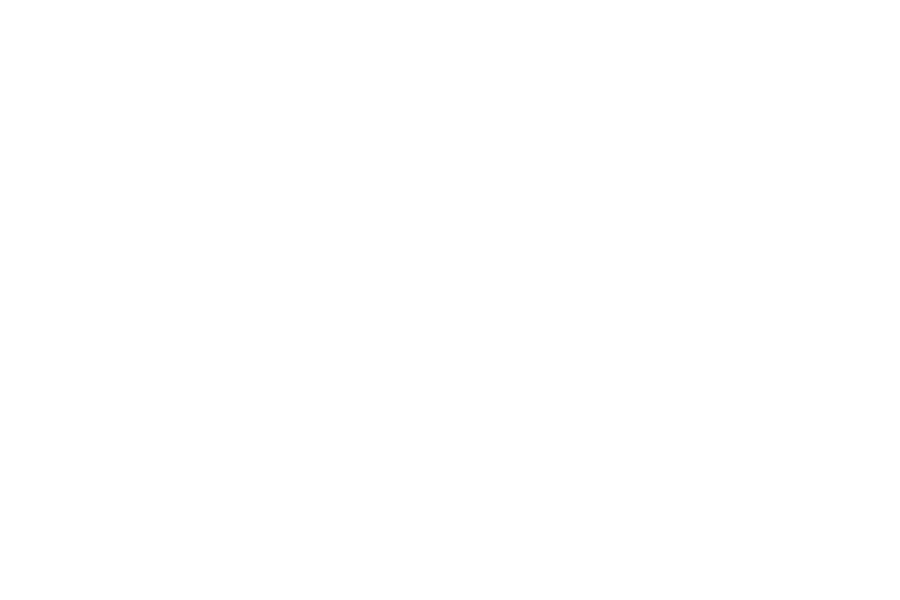

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 16


<IPython.core.display.Javascript object>

[LEFT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


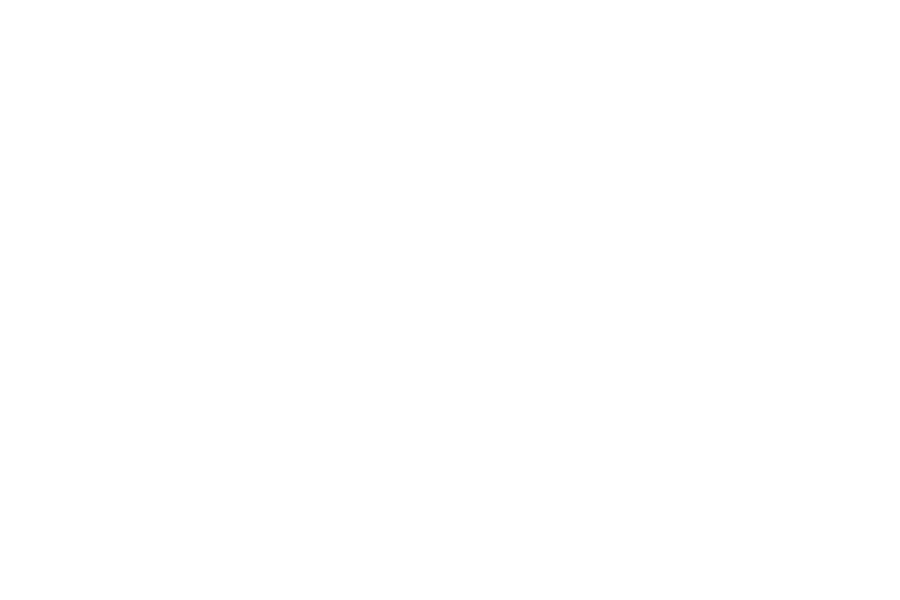

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.103713141587177
MAE(best):  0.078642369855900
MAE(best):  0.019272281563016
MAE(best):  0.016333059979335
MAE(best):  0.014869964097966


<IPython.core.display.Javascript object>


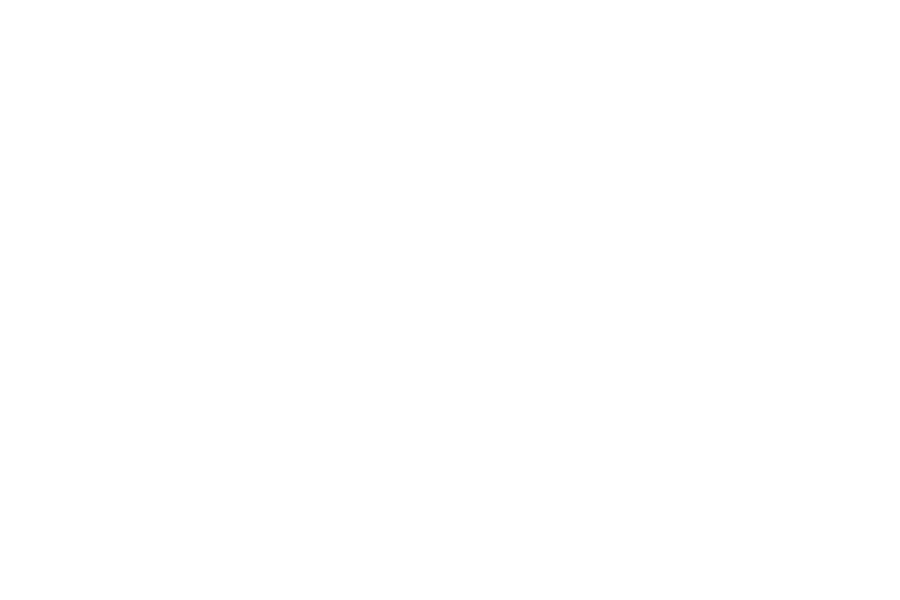

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 17


<IPython.core.display.Javascript object>

[UP_RIGHT, LEFT]


/Users/aloreggia/Documents/GitHub/soft_constraint_irl/max_ent/examples/grid_9_by_9.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(num=title, figsize=fsize)


{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


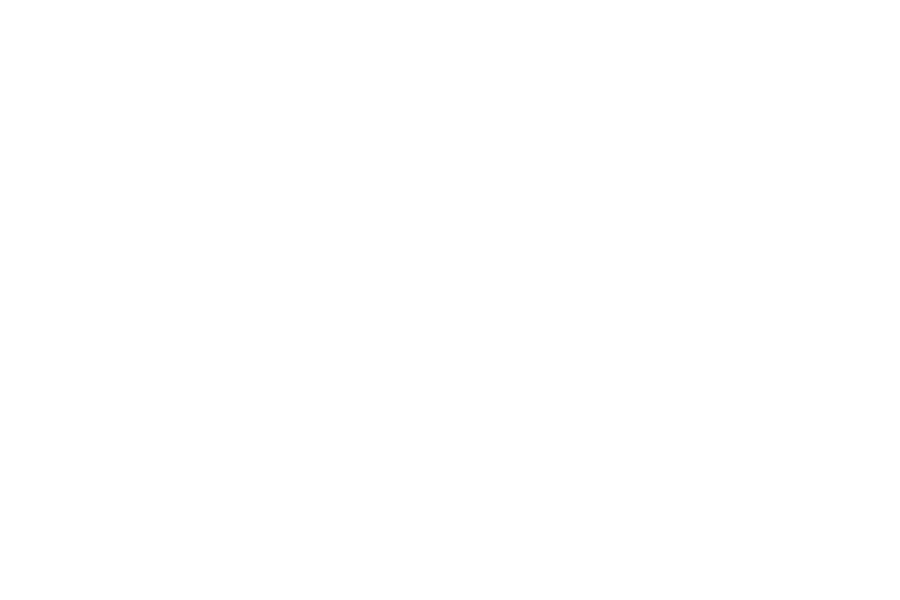

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.109812780863954
MAE(best):  0.093882608132967
MAE(best):  0.032543739591599
MAE(best):  0.024986485965925
MAE(best):  0.021684250493080


<IPython.core.display.Javascript object>


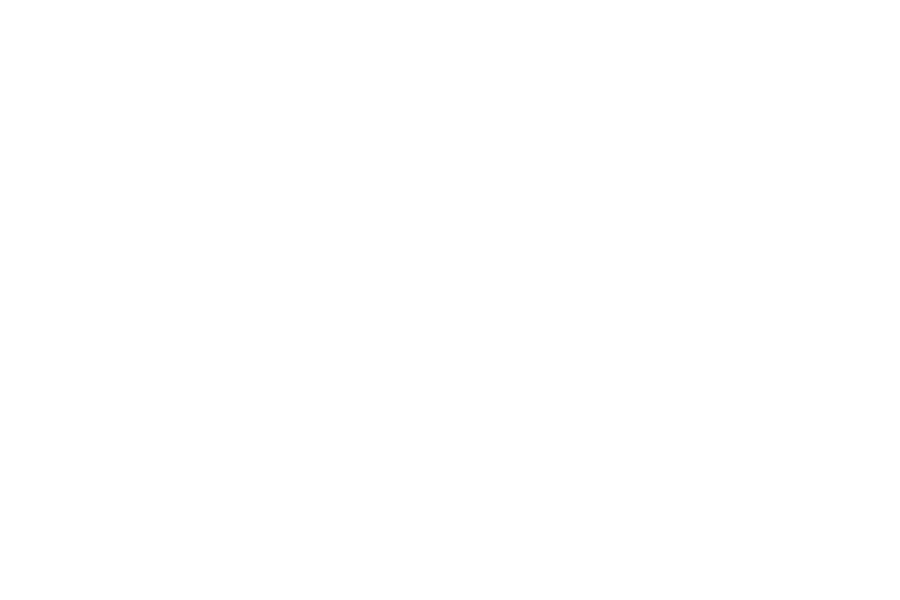

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 18


/Users/aloreggia/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>

[DOWN, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


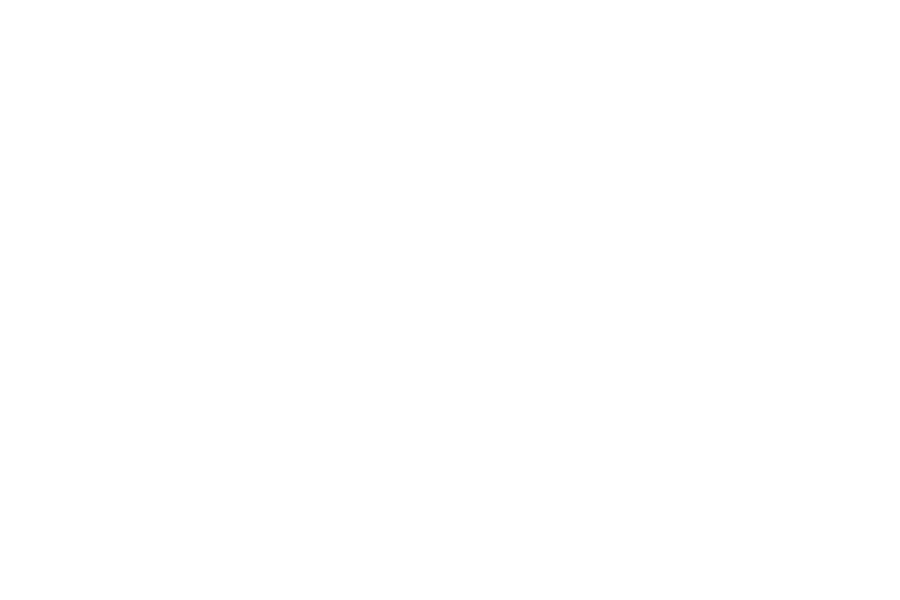

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.133974341874072
MAE(best):  0.109013073208198
MAE(best):  0.029200674441132
MAE(best):  0.027339877972051
MAE(best):  0.023421208780631


<IPython.core.display.Javascript object>


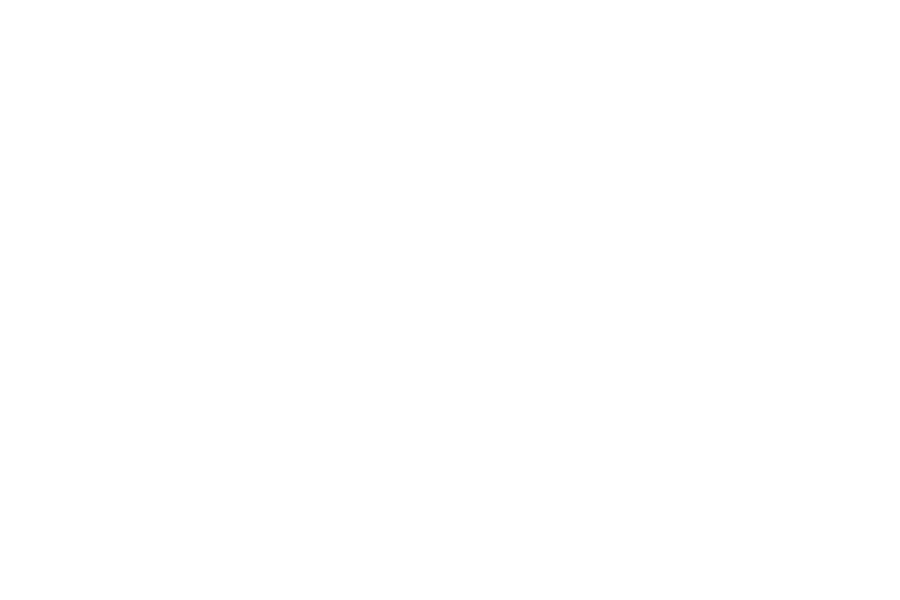

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 19


<IPython.core.display.Javascript object>

[UP_LEFT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


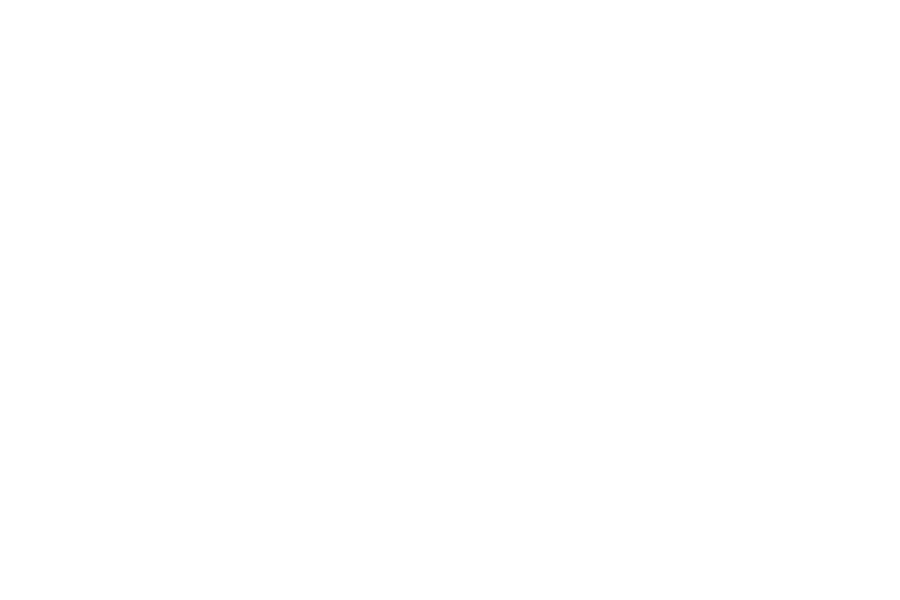

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.225925791547241
MAE(best):  0.139261142781713
MAE(best):  0.029655655859687
MAE(best):  0.020373815487936
MAE(best):  0.020373815487936


<IPython.core.display.Javascript object>


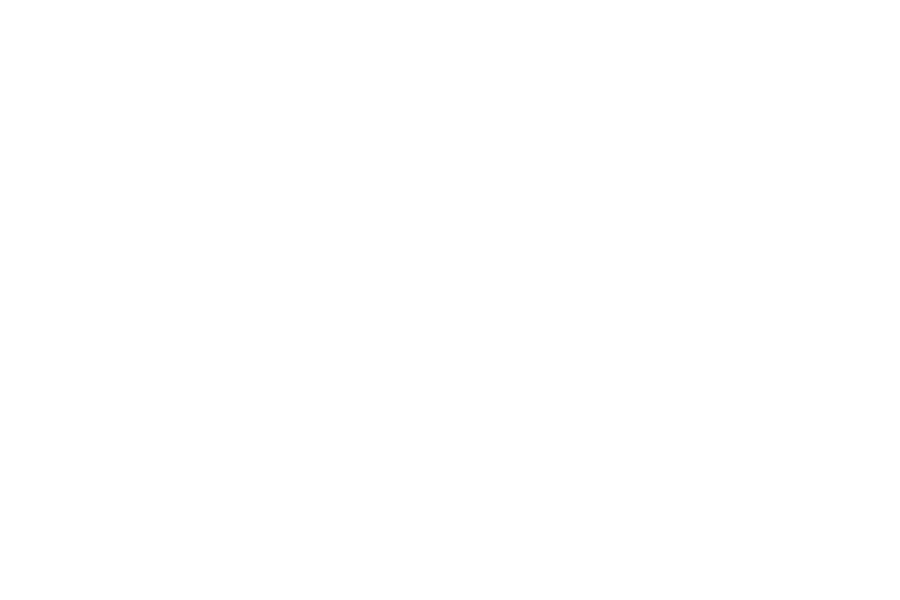

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 20


<IPython.core.display.Javascript object>

[UP, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


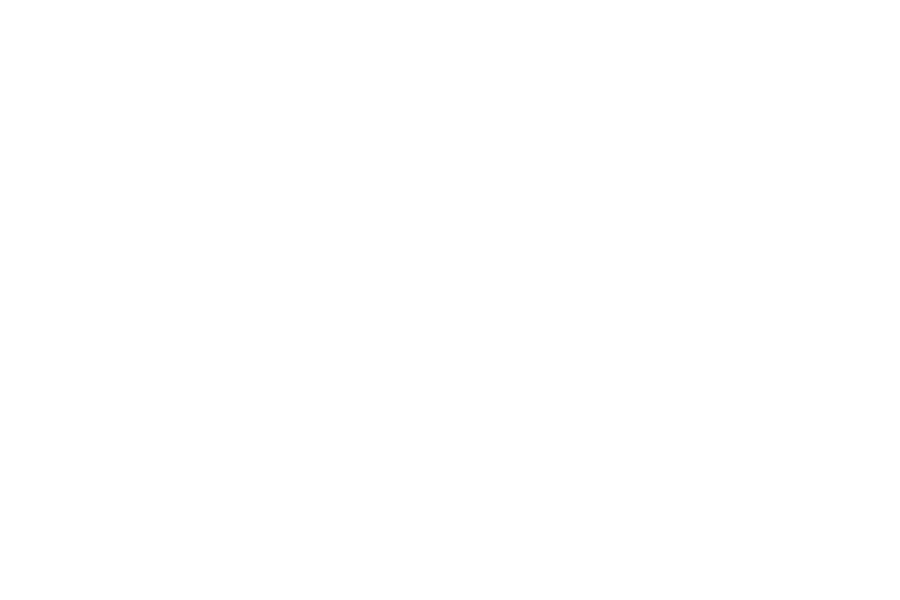

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.180308713209679
MAE(best):  0.062575886252744
MAE(best):  0.012359134373617
MAE(best):  0.011427321460839
MAE(best):  0.010437998880213


<IPython.core.display.Javascript object>


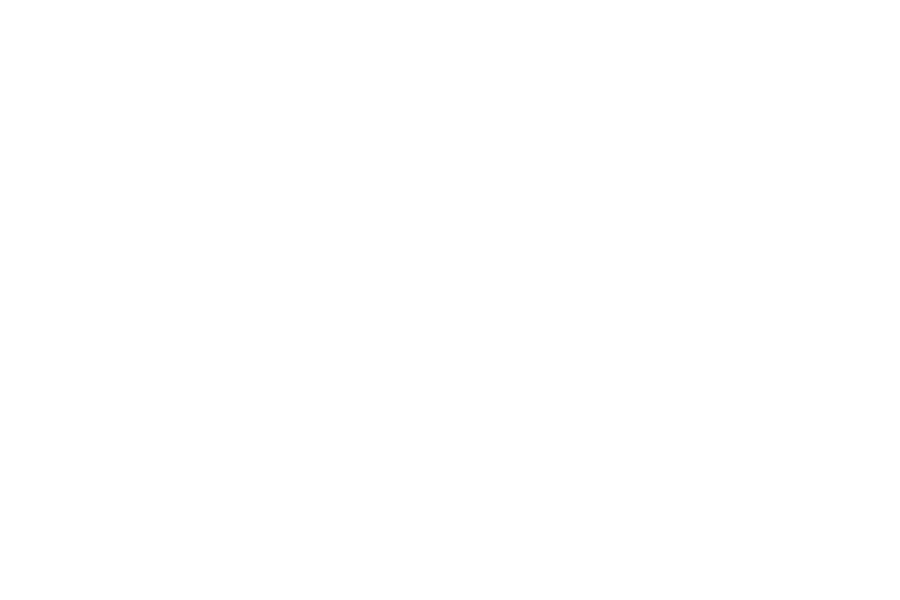

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 21


<IPython.core.display.Javascript object>

[RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


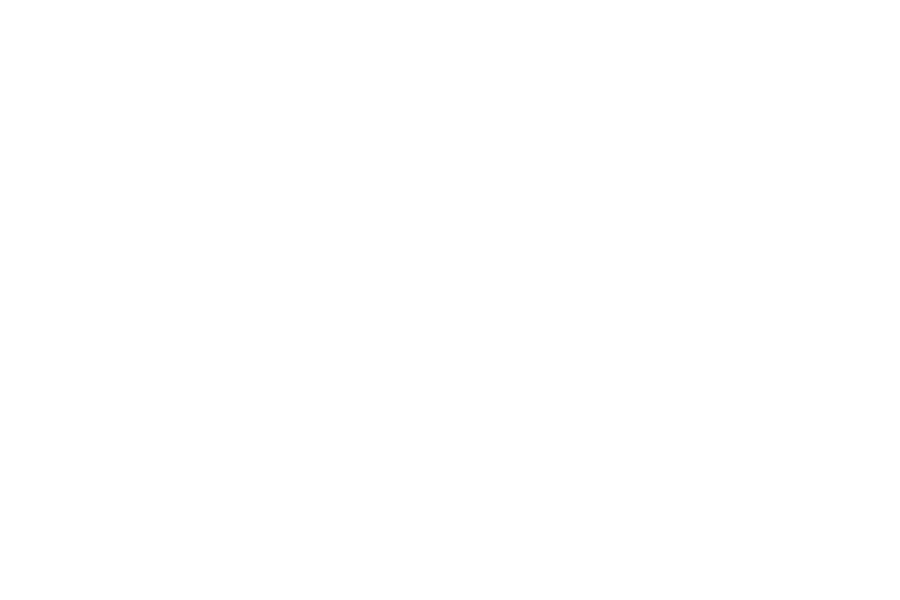

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.075586400063843
MAE(best):  0.052793606815305
MAE(best):  0.020276815751131
MAE(best):  0.018108243217704
MAE(best):  0.013630311246203


<IPython.core.display.Javascript object>


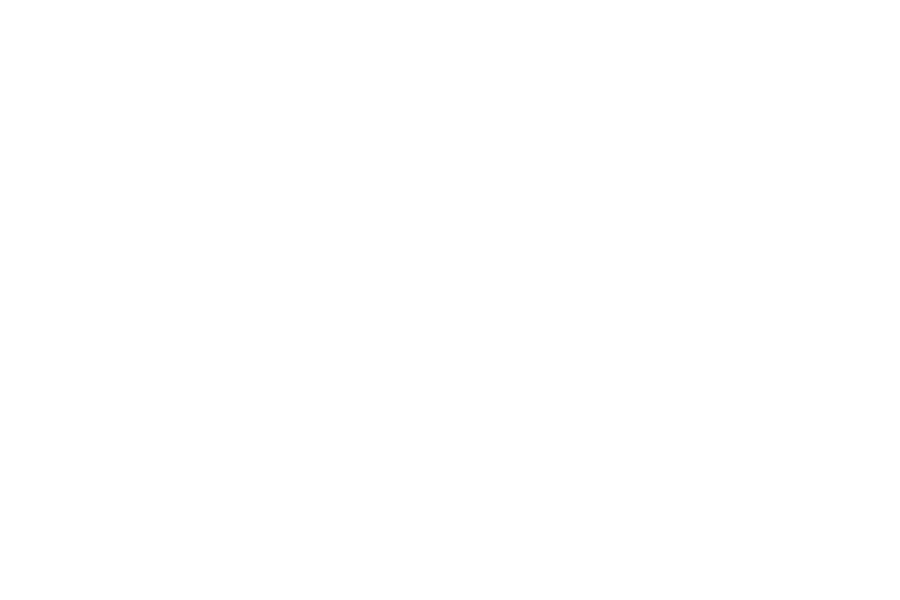

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 22


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


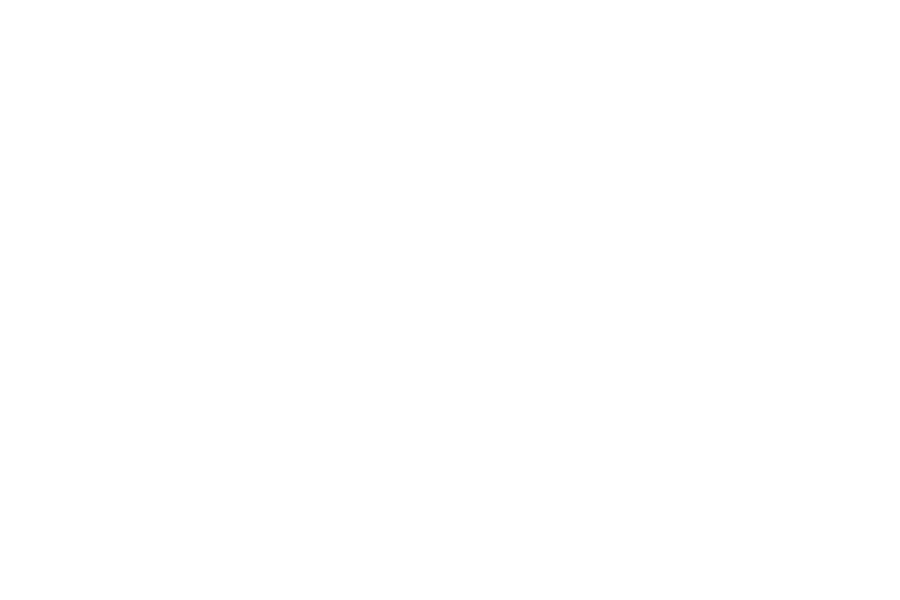

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.135469310422449
MAE(best):  0.025425510555654
MAE(best):  0.015332898309871
MAE(best):  0.013490453036938
MAE(best):  0.013189069122455


<IPython.core.display.Javascript object>


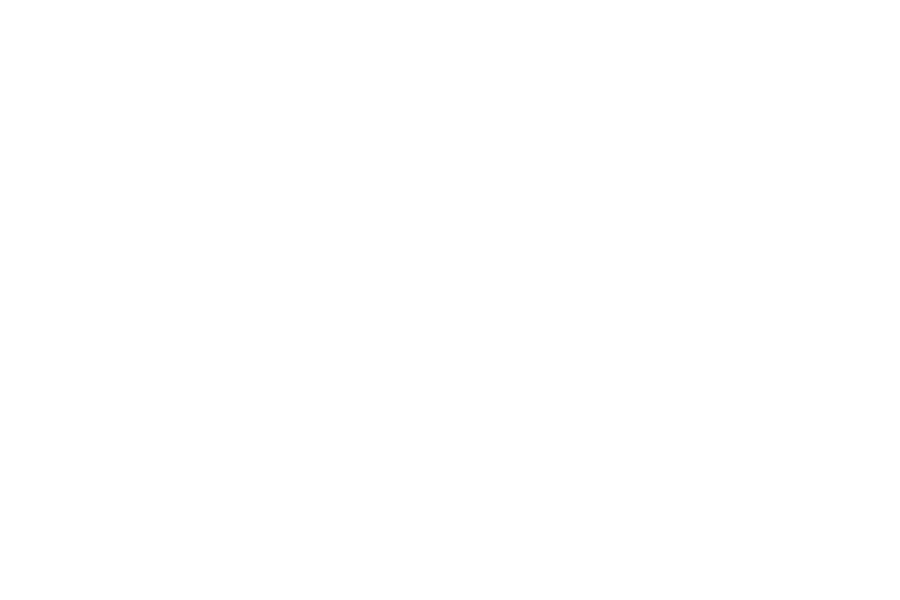

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 23


<IPython.core.display.Javascript object>

[DOWN, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


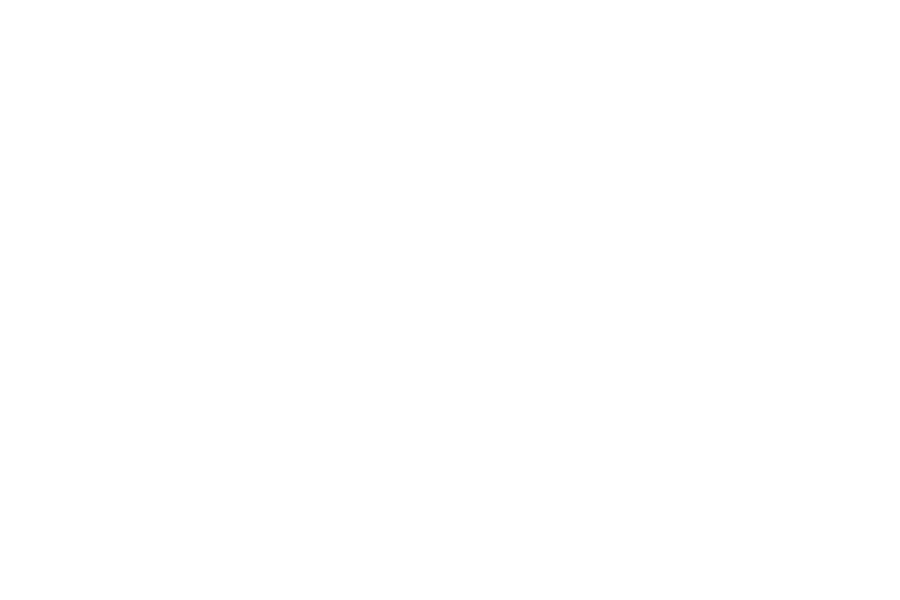

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.046197075806545
MAE(best):  0.035003492372940
MAE(best):  0.024204847146933
MAE(best):  0.015749655002738
MAE(best):  0.015246548637357


<IPython.core.display.Javascript object>


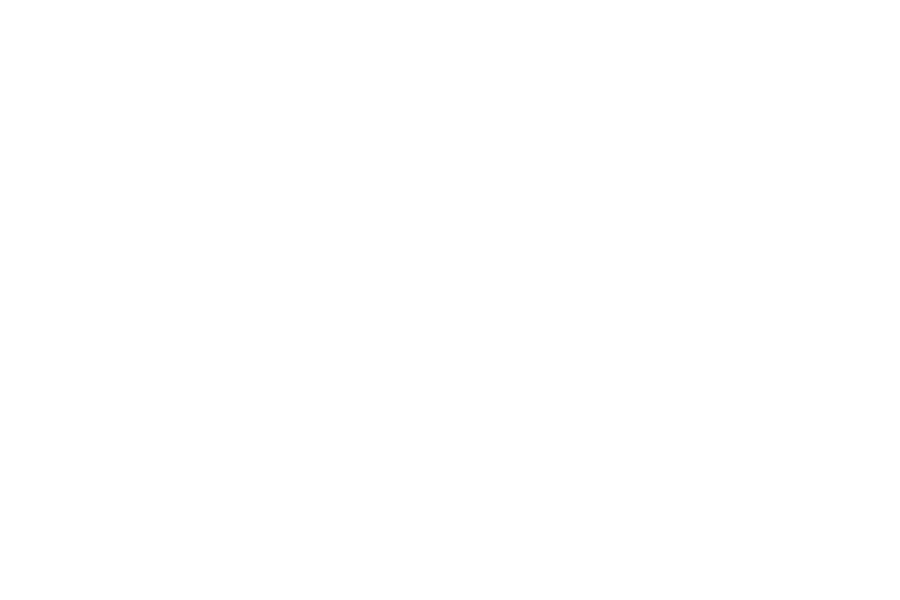

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 24


<IPython.core.display.Javascript object>

[LEFT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


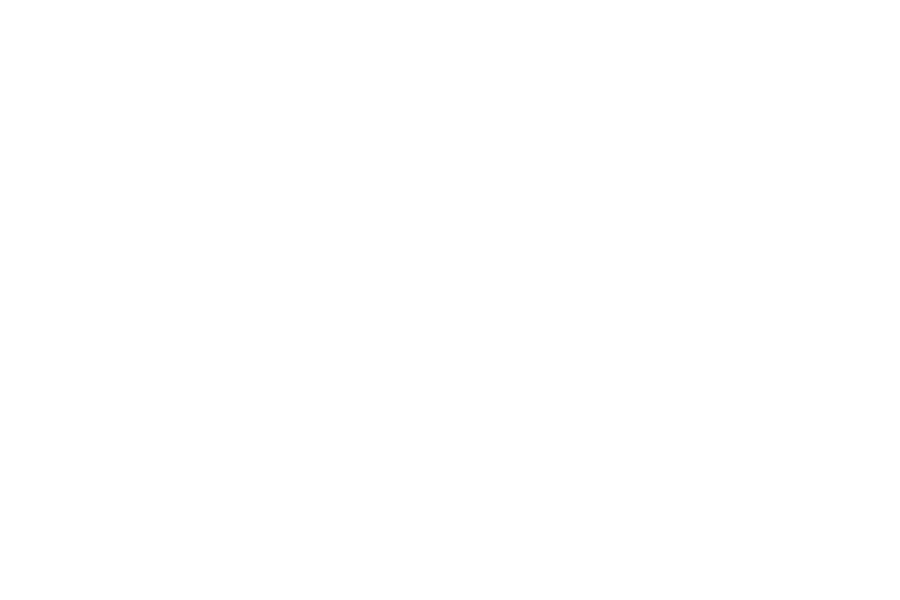

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.009699753762661


<IPython.core.display.Javascript object>


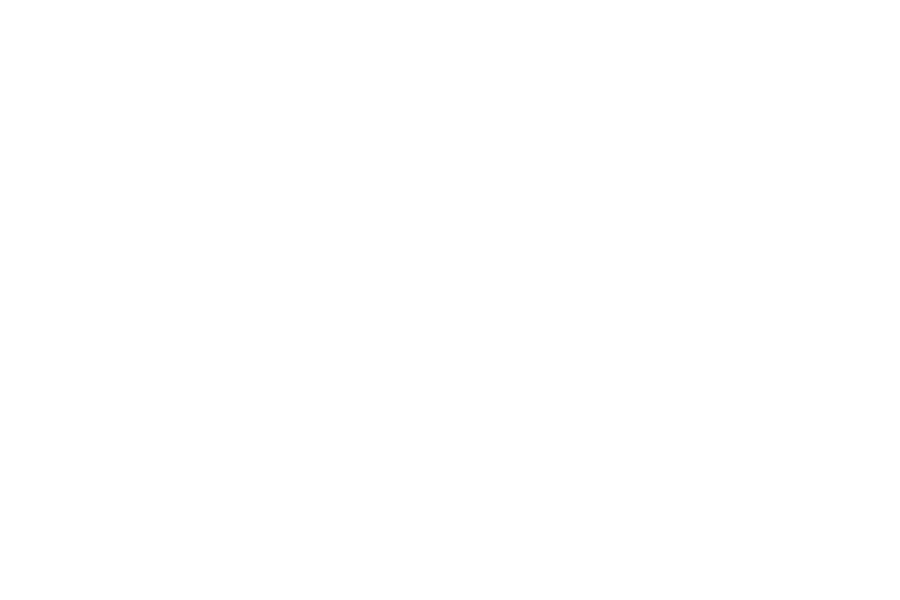

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 25


<IPython.core.display.Javascript object>

[UP_LEFT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


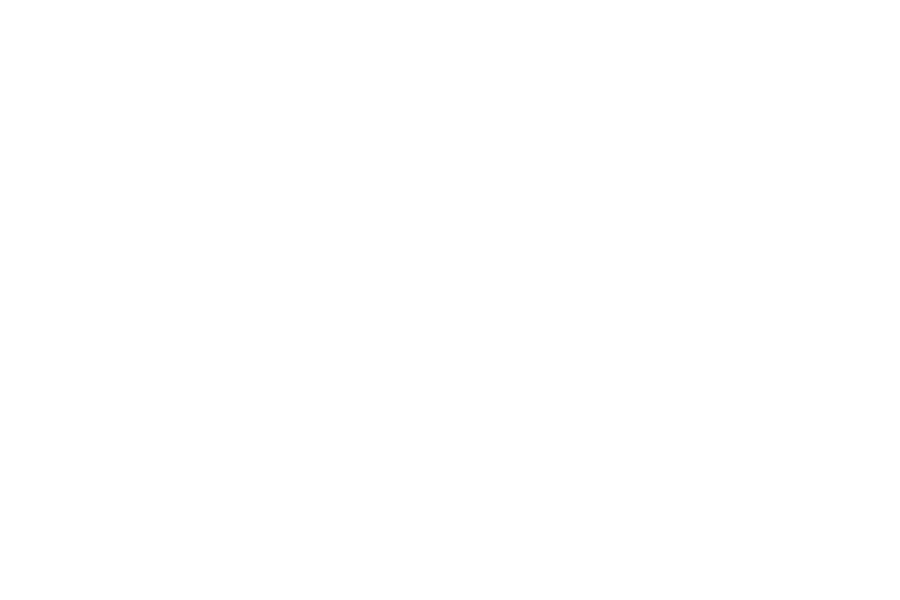

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.891529891605020
MAE(best):  0.660228572651350
MAE(best):  0.632589193847131
MAE(best):  0.580666169520482
MAE(best):  0.571847479336465


<IPython.core.display.Javascript object>


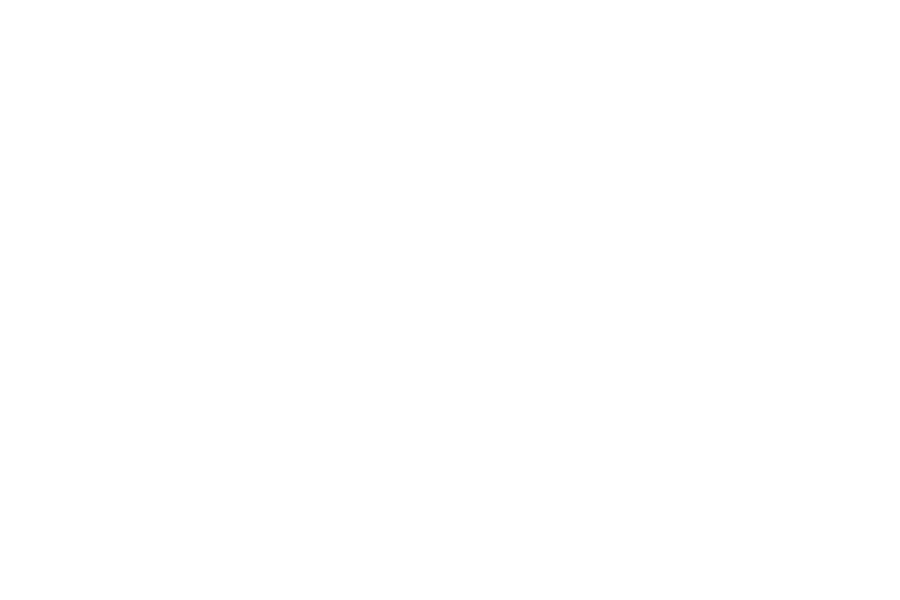

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 26


<IPython.core.display.Javascript object>

[DOWN_RIGHT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


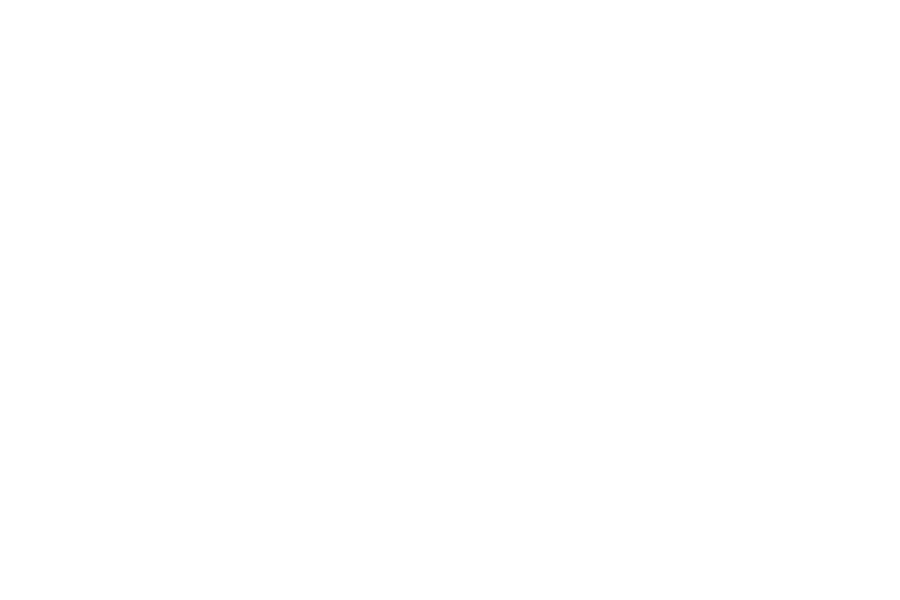

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.068441212970728
MAE(best):  0.031377346008927
MAE(best):  0.010749511214145


<IPython.core.display.Javascript object>


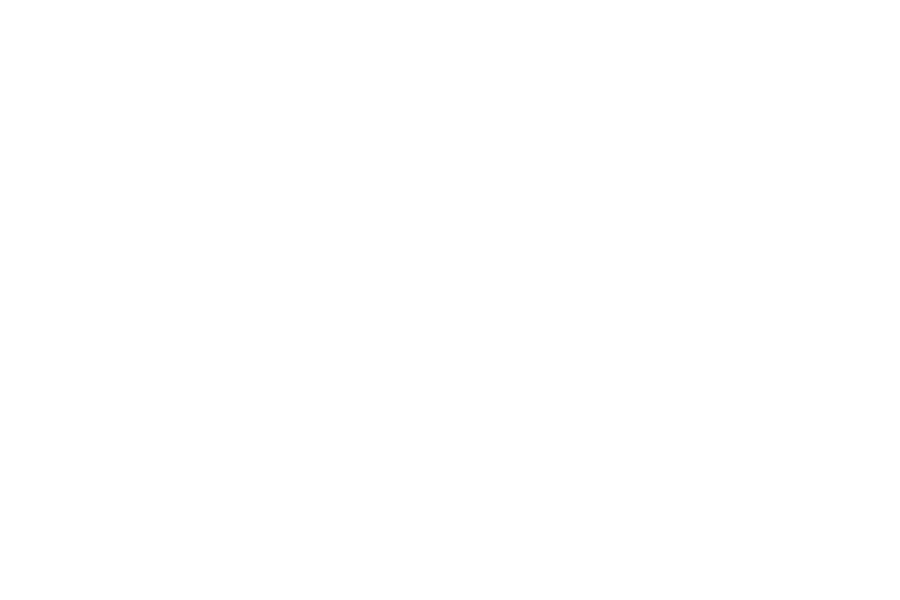

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 27


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


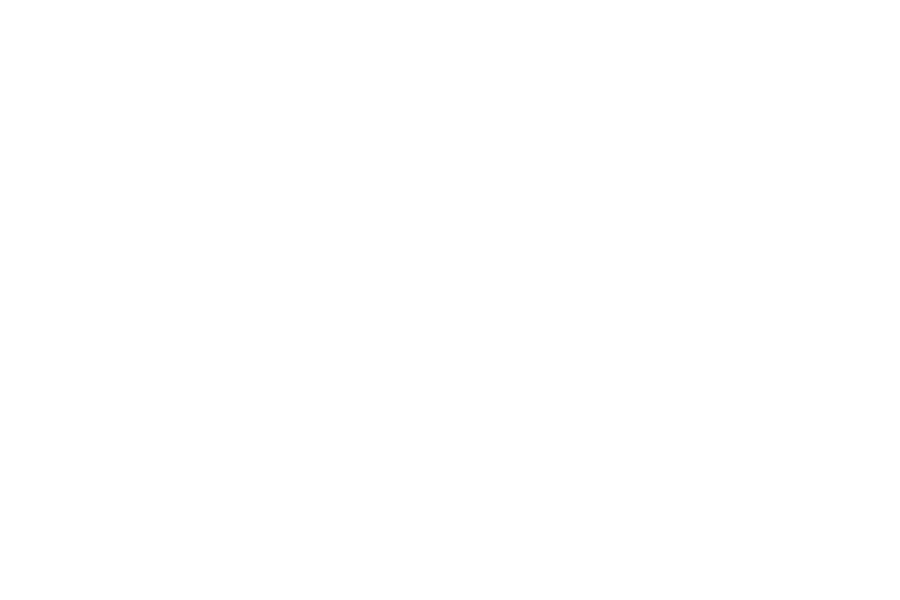

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.048437600010928
MAE(best):  0.045900248127914
MAE(best):  0.028157305398221
MAE(best):  0.017285650136592
MAE(best):  0.013107434449290


<IPython.core.display.Javascript object>


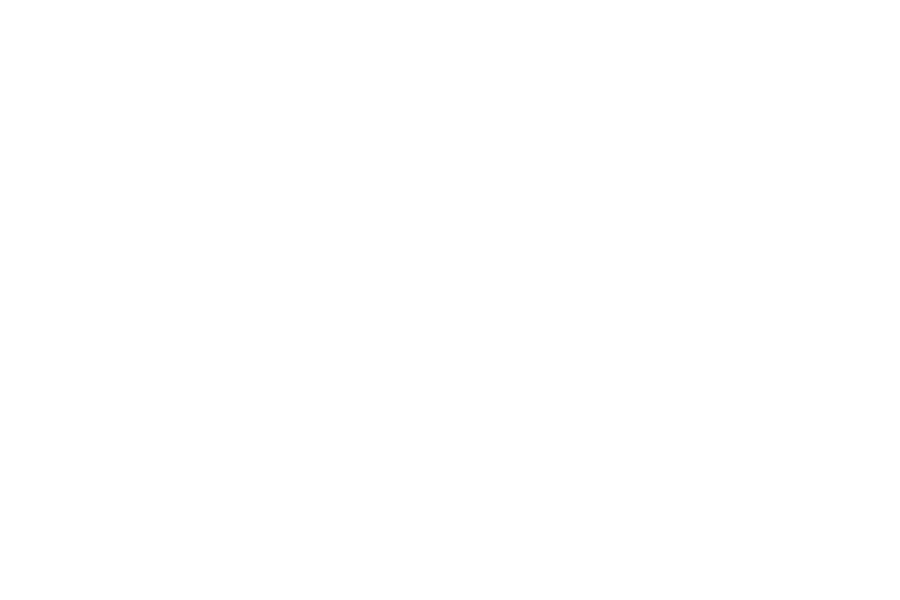

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 28


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


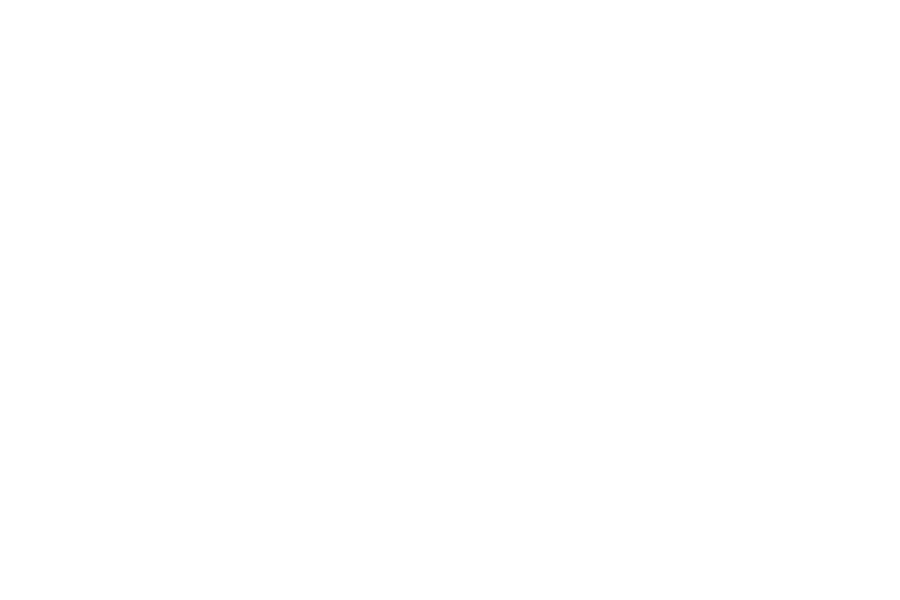

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.011560021670690


<IPython.core.display.Javascript object>


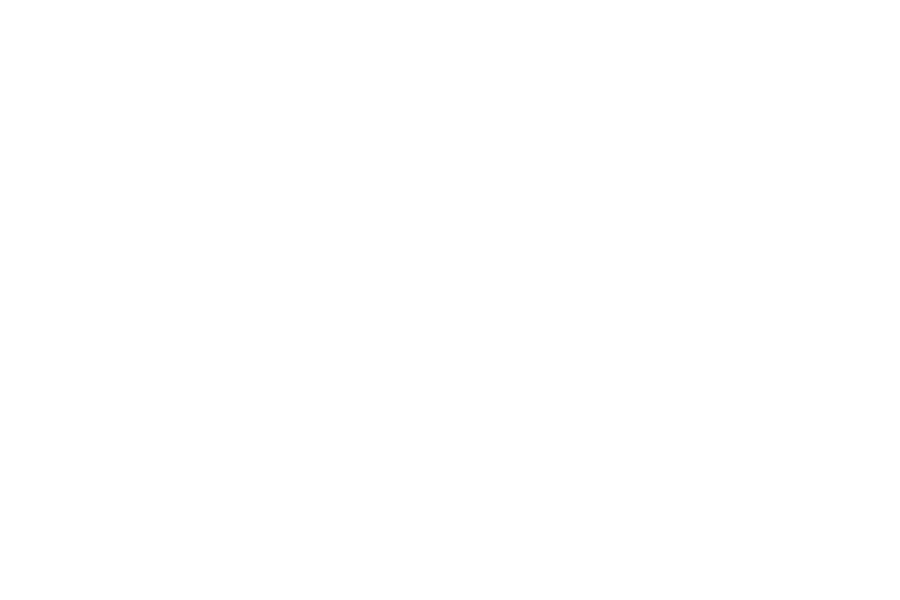

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 29


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


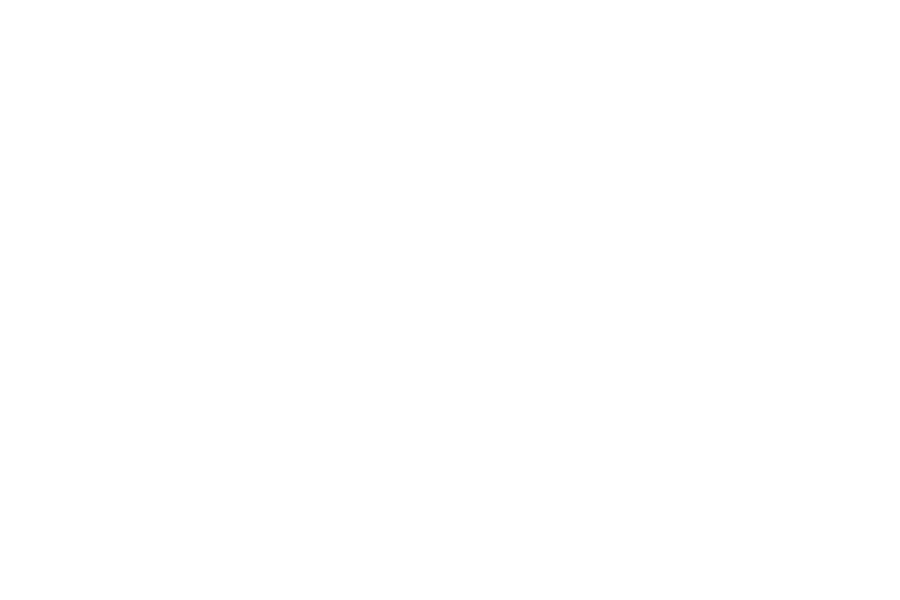

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.100345330841513
MAE(best):  0.021573066741354
MAE(best):  0.010355032946601


<IPython.core.display.Javascript object>


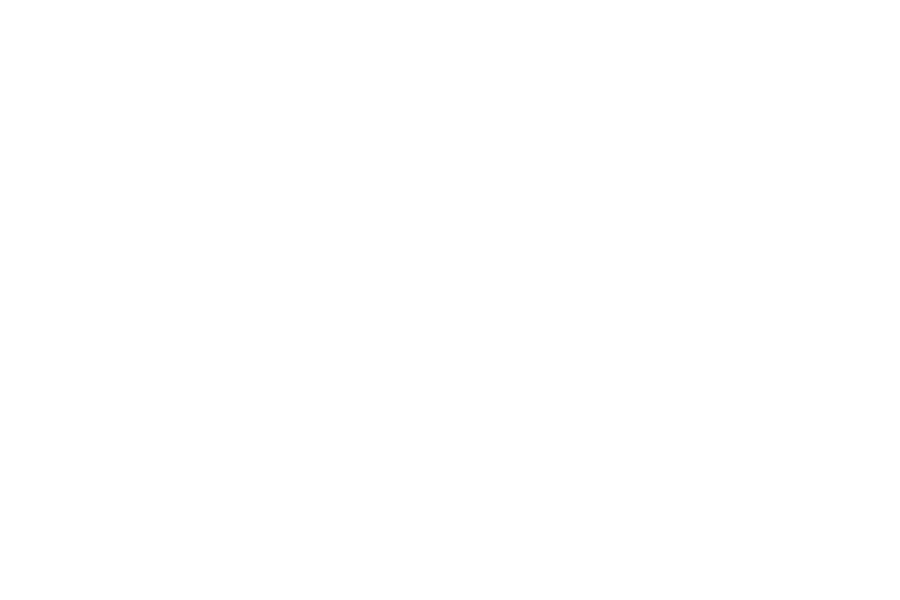

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 30


<IPython.core.display.Javascript object>

[RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


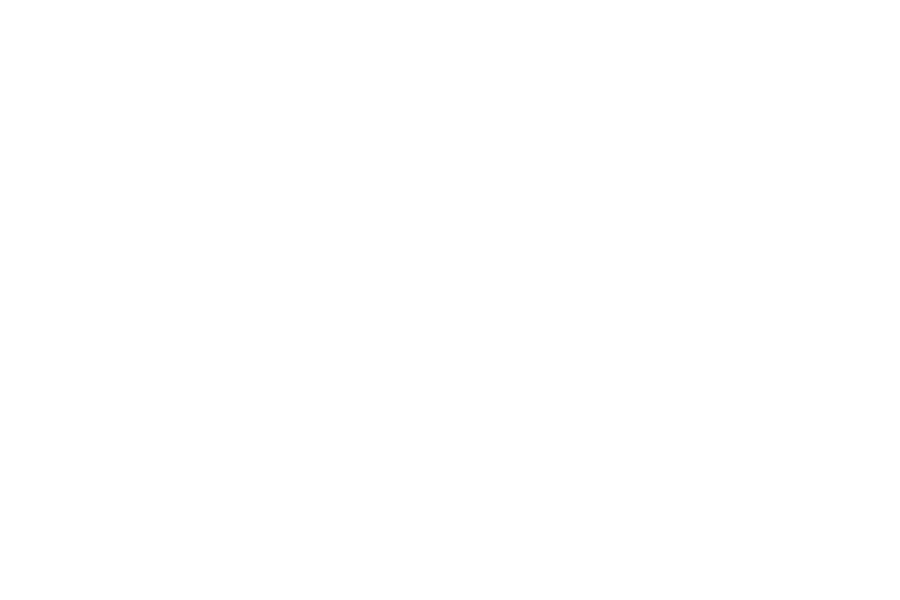

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.015074063577527
MAE(best):  0.015064118730515


<IPython.core.display.Javascript object>


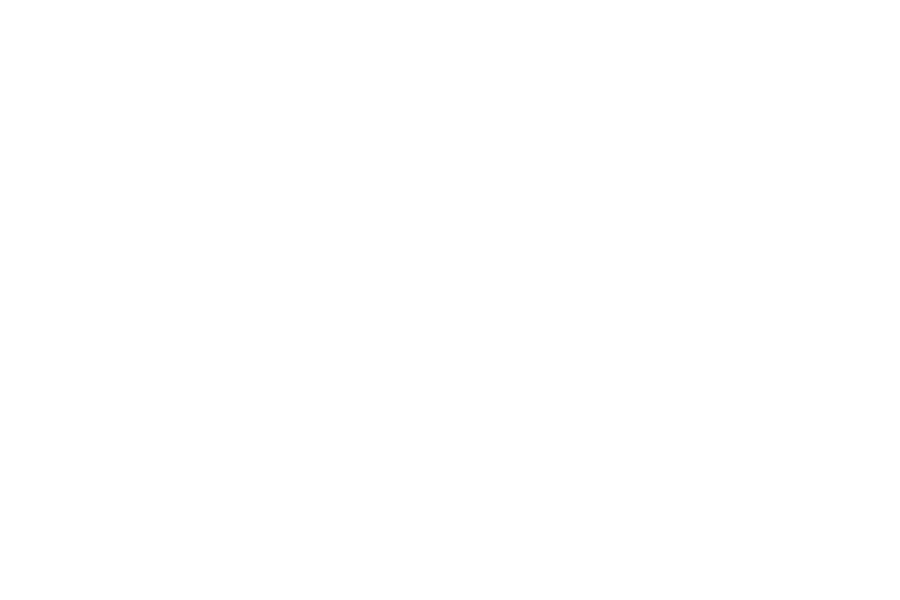

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 31


<IPython.core.display.Javascript object>

[DOWN, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


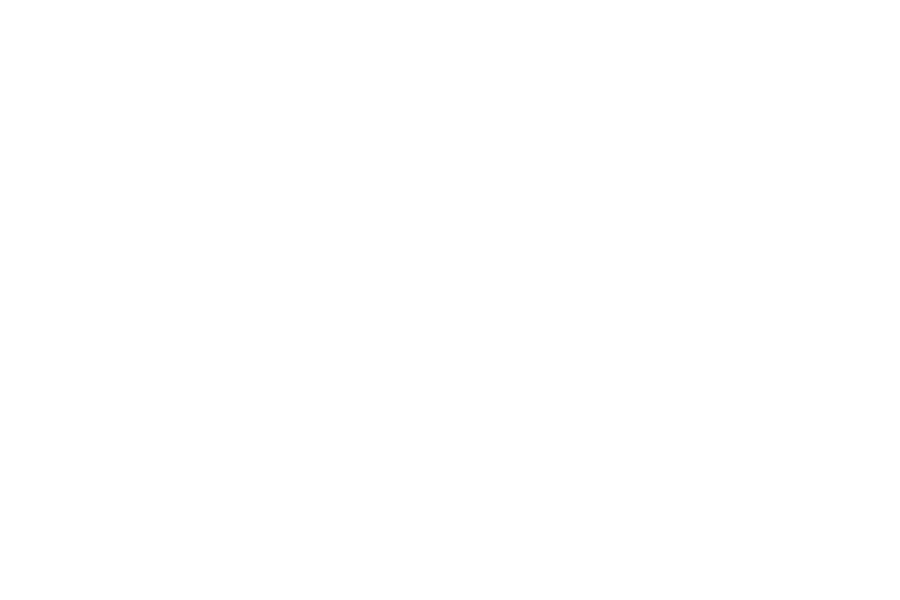

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.131036419524358
MAE(best):  0.050357703822934
MAE(best):  0.030320576679875
MAE(best):  0.019975597898306
MAE(best):  0.019105269711310


<IPython.core.display.Javascript object>


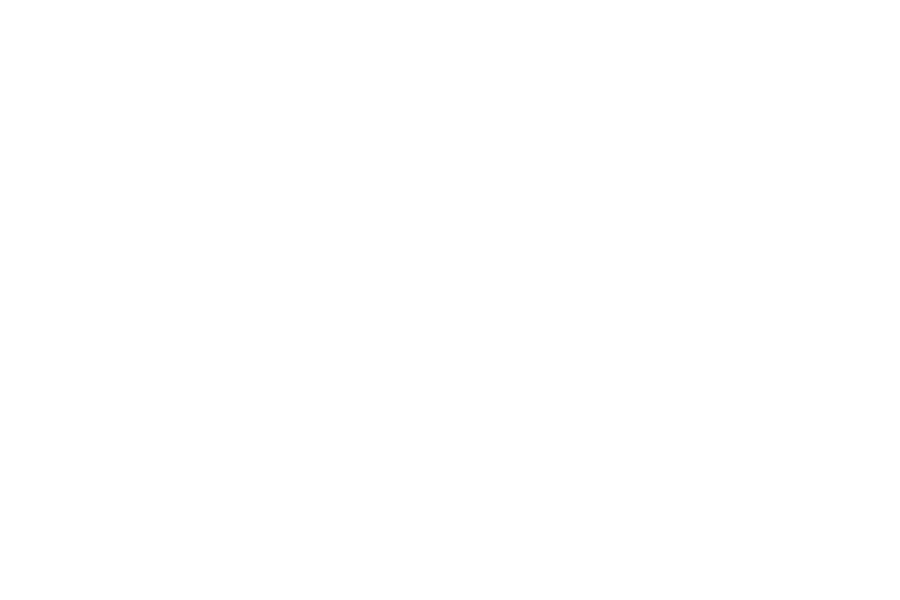

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 32


<IPython.core.display.Javascript object>

[RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


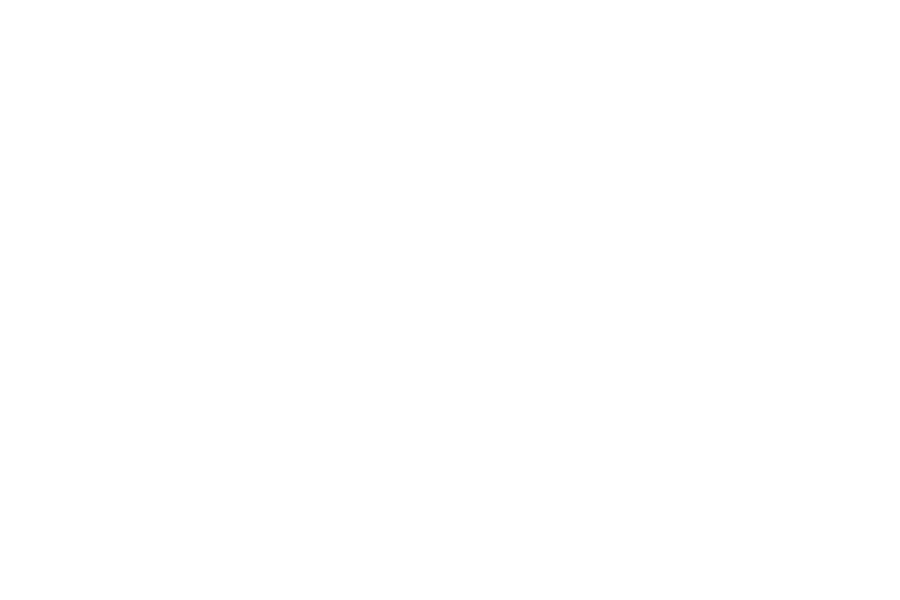

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.094784927437156
MAE(best):  0.052456750330889
MAE(best):  0.015031515984618
MAE(best):  0.014543742313370
MAE(best):  0.014462270452424


<IPython.core.display.Javascript object>


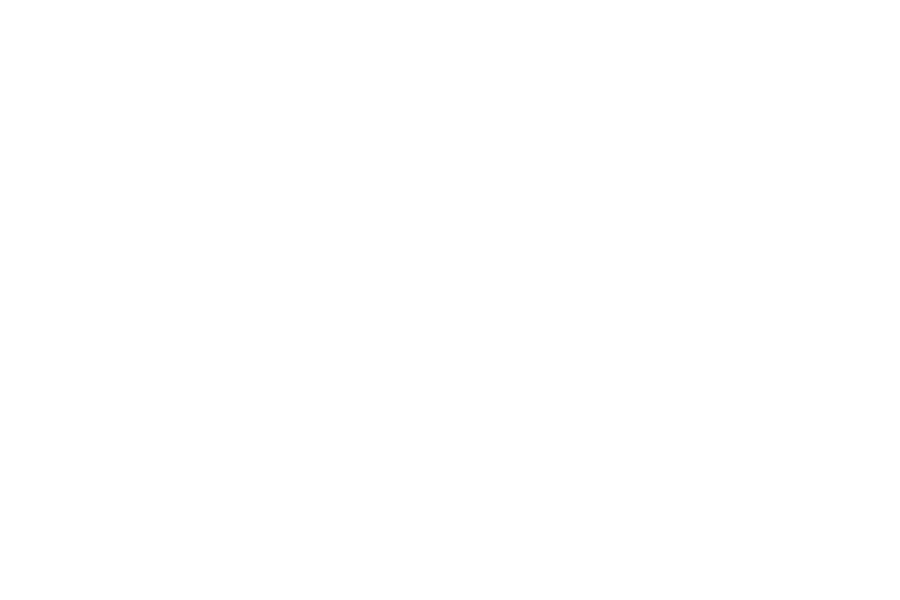

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 33


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


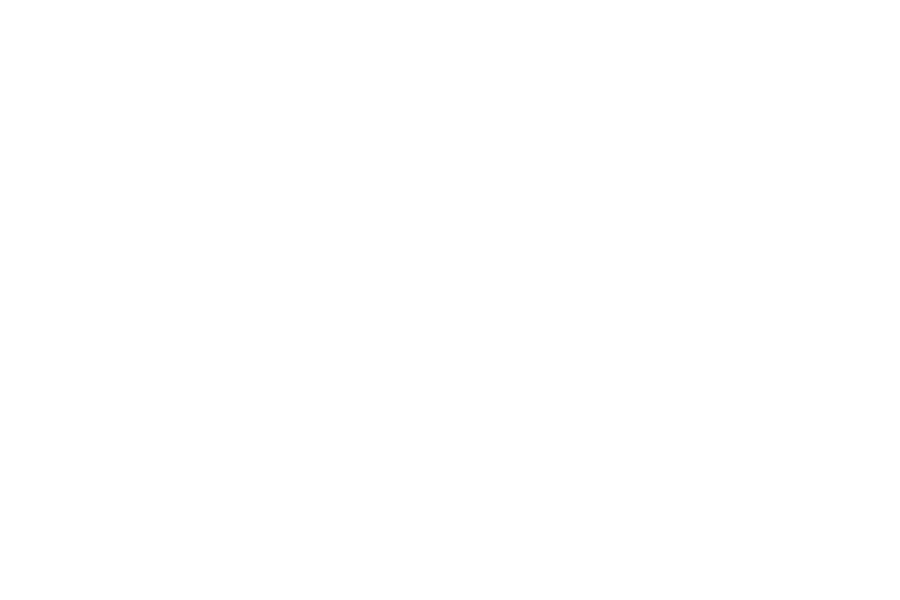

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.230381058106041
MAE(best):  0.037232076215103
MAE(best):  0.018962594022700
MAE(best):  0.015462195425967
MAE(best):  0.014805374088743


<IPython.core.display.Javascript object>


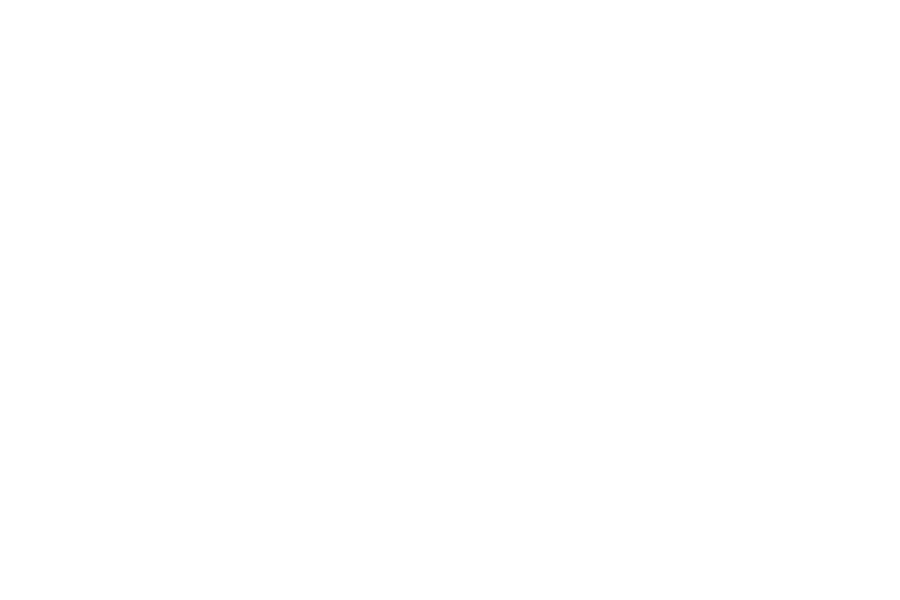

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 34


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


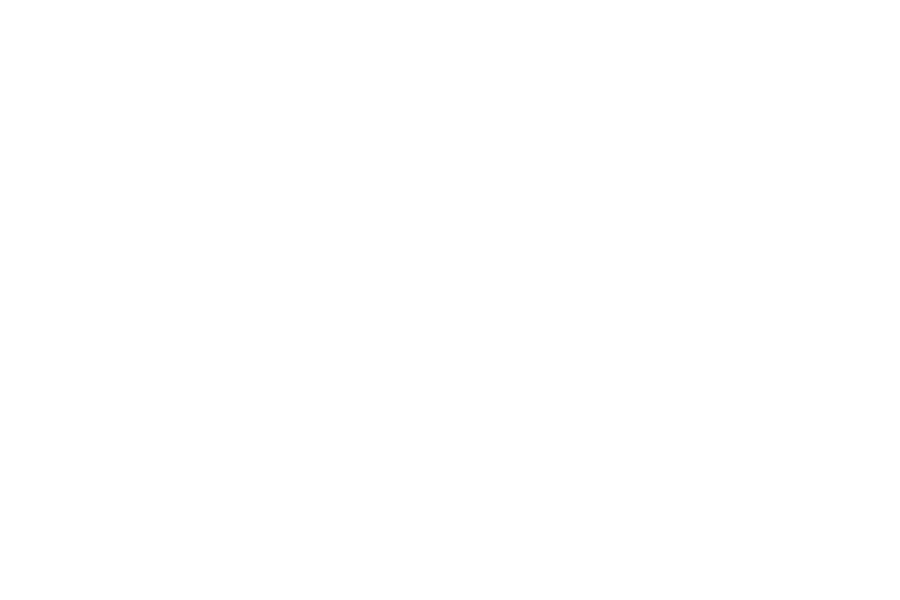

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.138633425546801
MAE(best):  0.034858195593957
MAE(best):  0.024292507922328


<IPython.core.display.Javascript object>


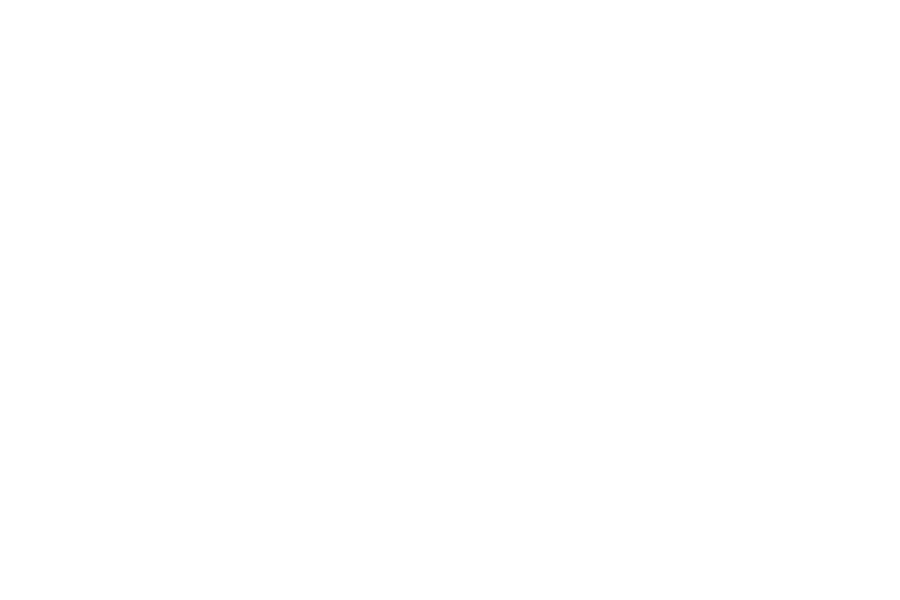

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 35


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


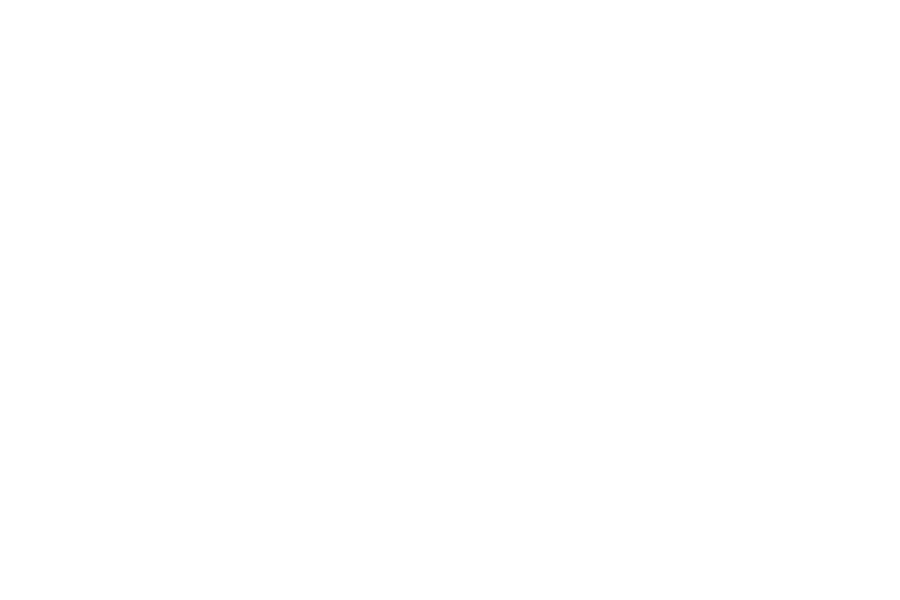

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.117874886466386
MAE(best):  0.012630515470322


<IPython.core.display.Javascript object>


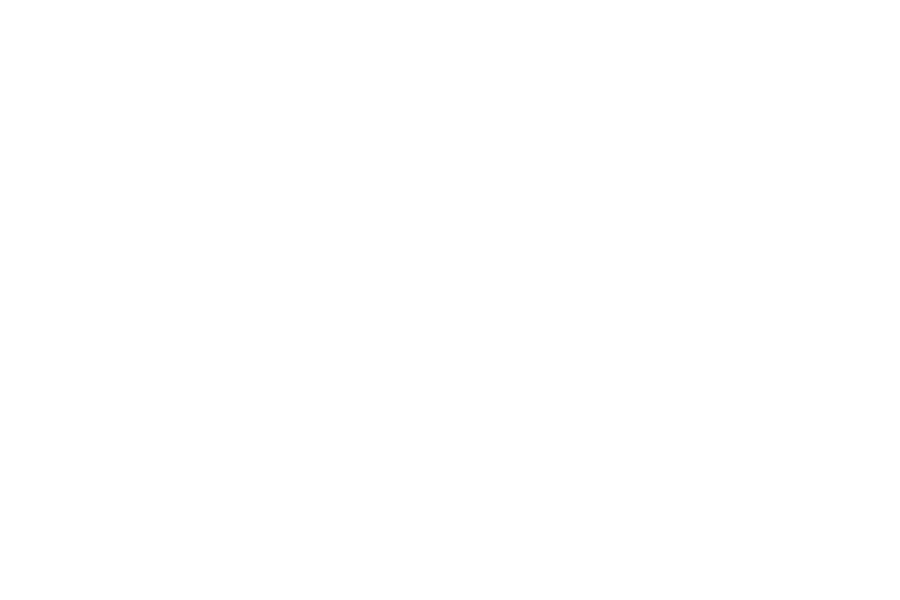

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 36


<IPython.core.display.Javascript object>

[UP_LEFT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


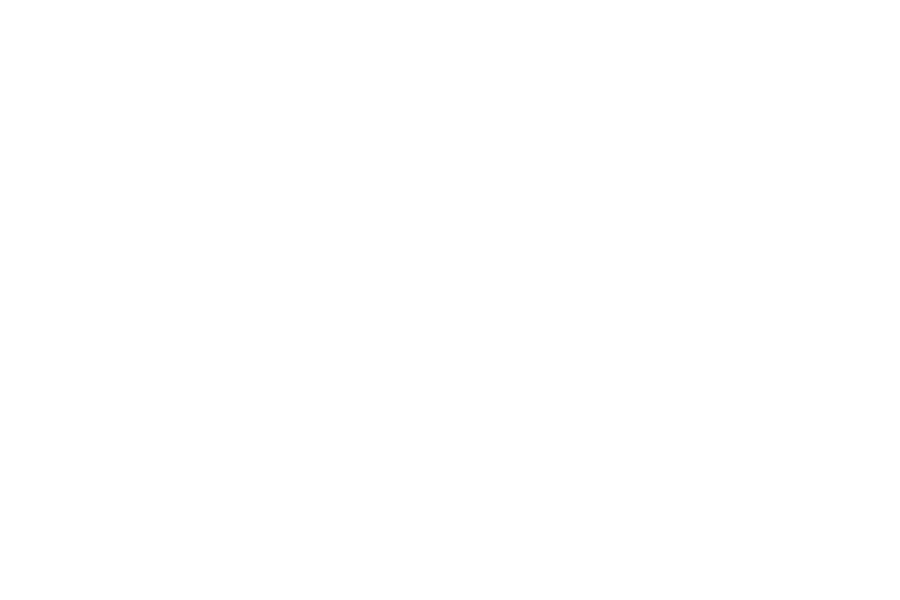

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.007634292779468


<IPython.core.display.Javascript object>


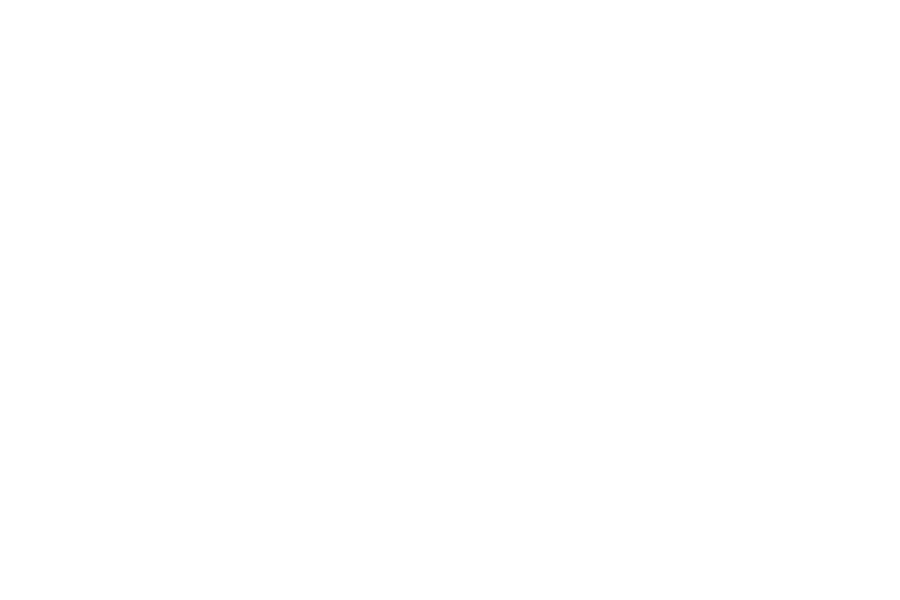

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 37


<IPython.core.display.Javascript object>

[UP, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


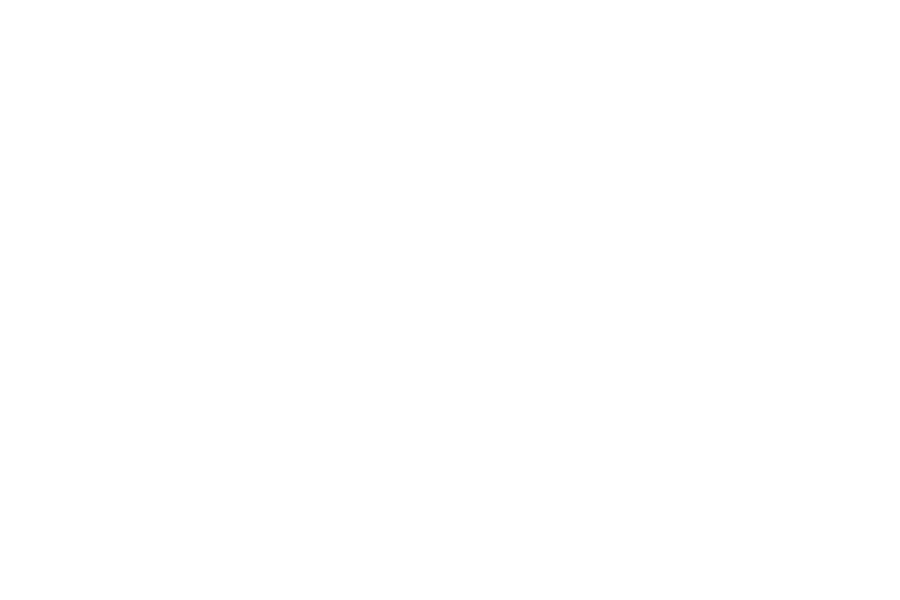

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.351506536388969
MAE(best):  0.351024204866864
MAE(best):  0.345318991575923
MAE(best):  0.340733420199557
MAE(best):  0.330331561335187


<IPython.core.display.Javascript object>


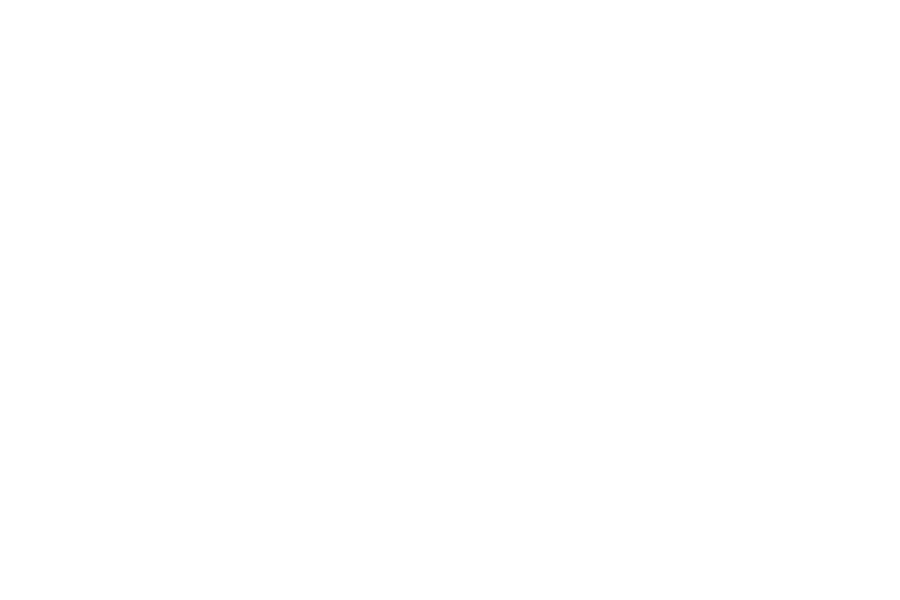

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 38


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


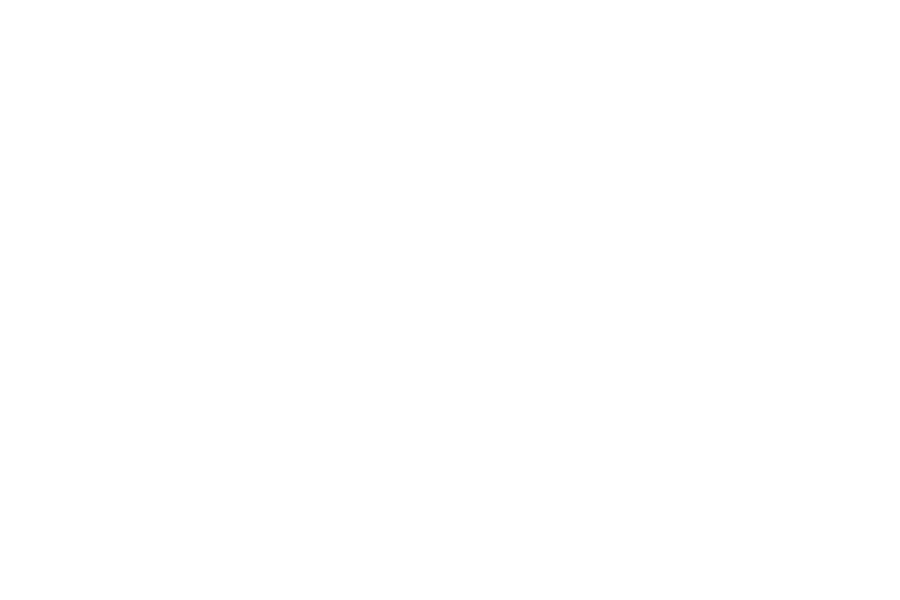

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.187453490453741
MAE(best):  0.052371295567602
MAE(best):  0.032440755880192
MAE(best):  0.032024993141473
MAE(best):  0.031813168935242


<IPython.core.display.Javascript object>


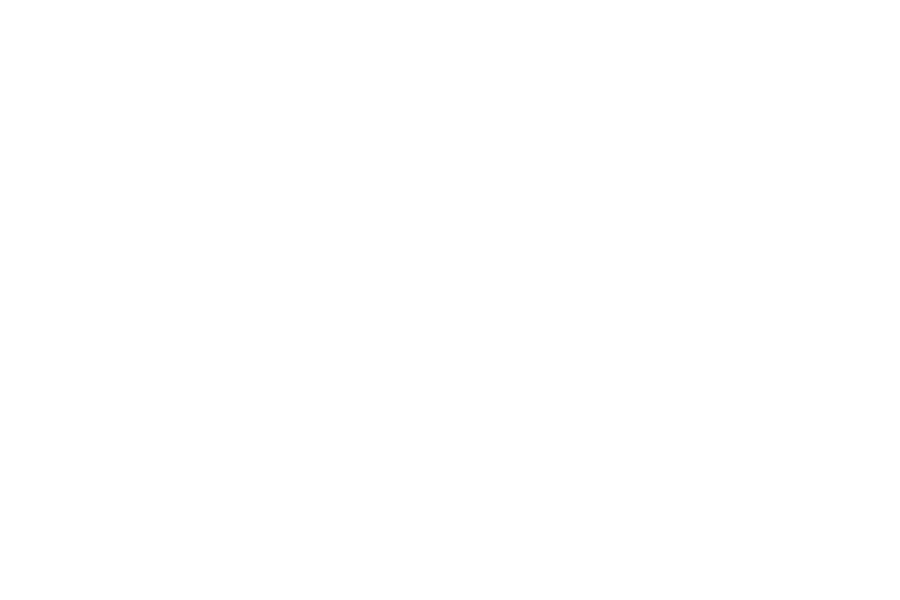

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 39


<IPython.core.display.Javascript object>

[RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


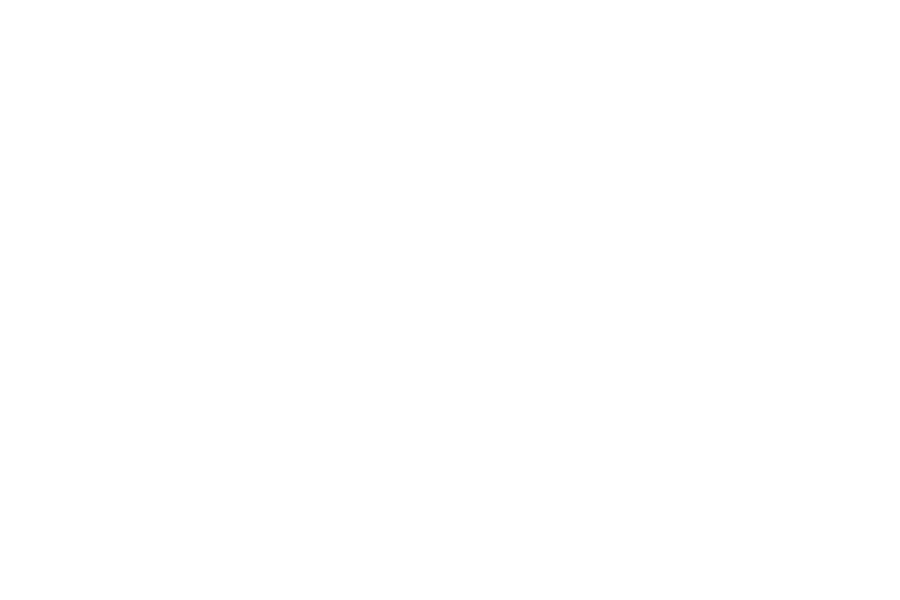

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.114749291110157
MAE(best):  0.102126427084930
MAE(best):  0.032243121853961
MAE(best):  0.024317098878662
MAE(best):  0.023601757686509


<IPython.core.display.Javascript object>


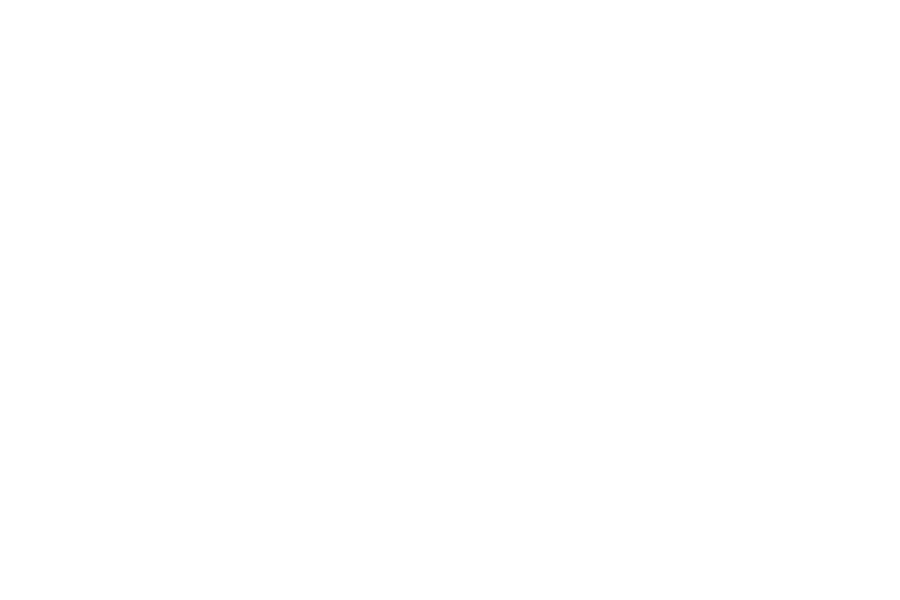

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 40


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


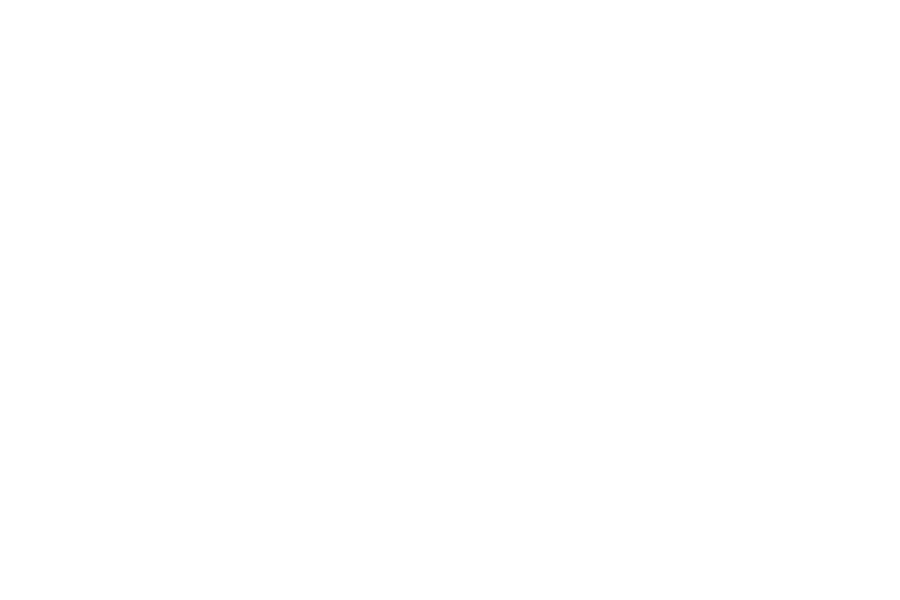

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.116407376478019
MAE(best):  0.062316090580480
MAE(best):  0.036854214081672
MAE(best):  0.023157142773299
MAE(best):  0.021610843137250


<IPython.core.display.Javascript object>


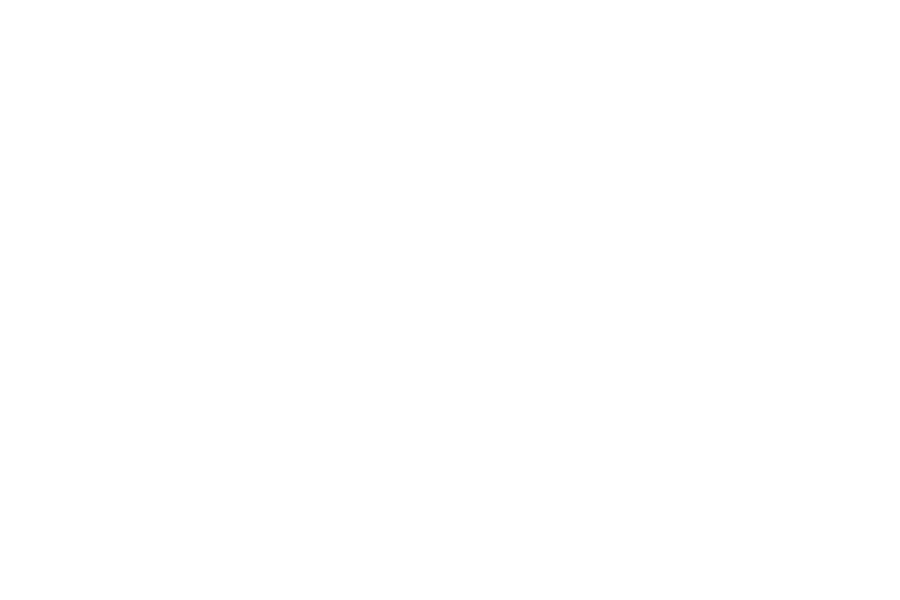

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 41


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


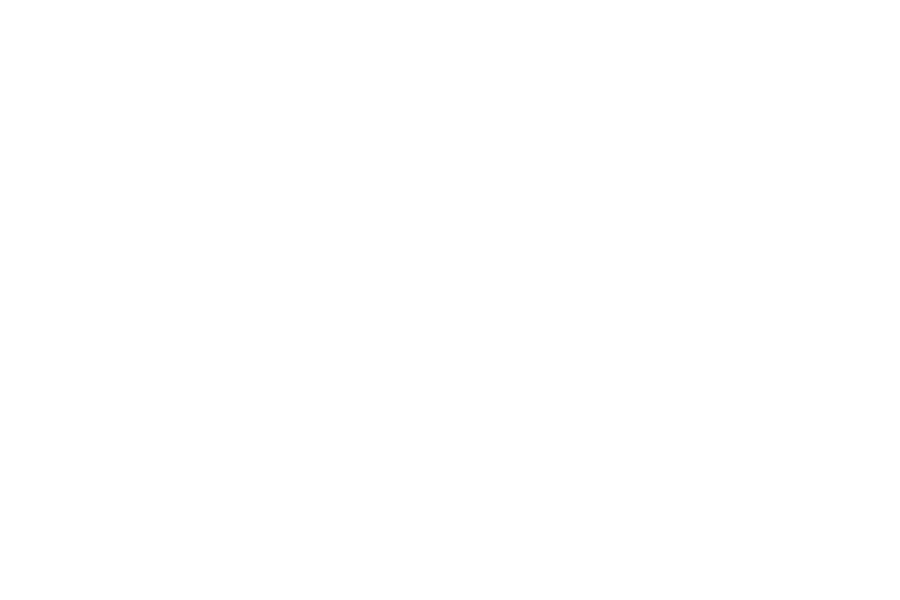

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.232531222544786
MAE(best):  0.045034519804379
MAE(best):  0.022613405574294
MAE(best):  0.016828723985870
MAE(best):  0.015759724181838


<IPython.core.display.Javascript object>


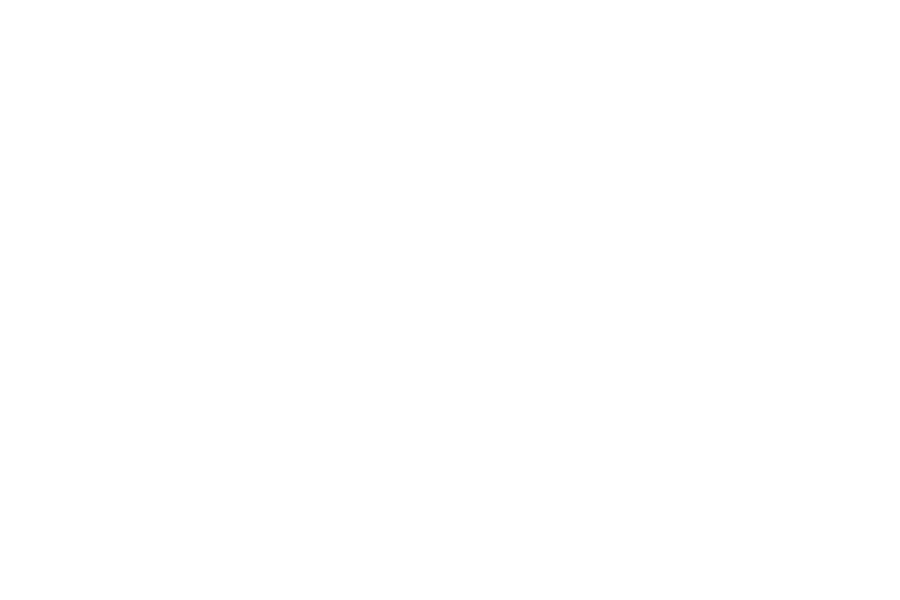

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 42


<IPython.core.display.Javascript object>

[UP_LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


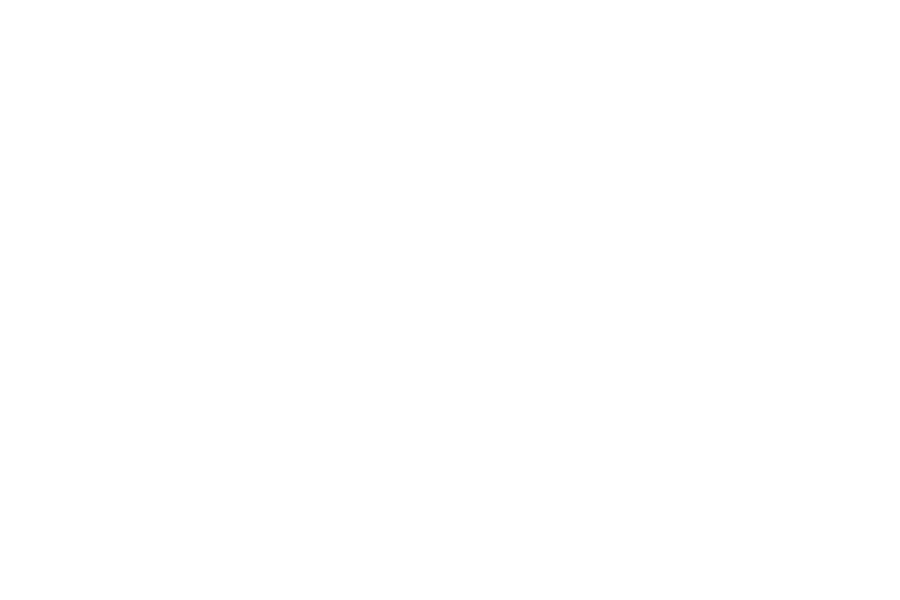

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.297988914990870
MAE(best):  0.047073044543814
MAE(best):  0.041266650646245
MAE(best):  0.033781880290177
MAE(best):  0.029708911268386


<IPython.core.display.Javascript object>


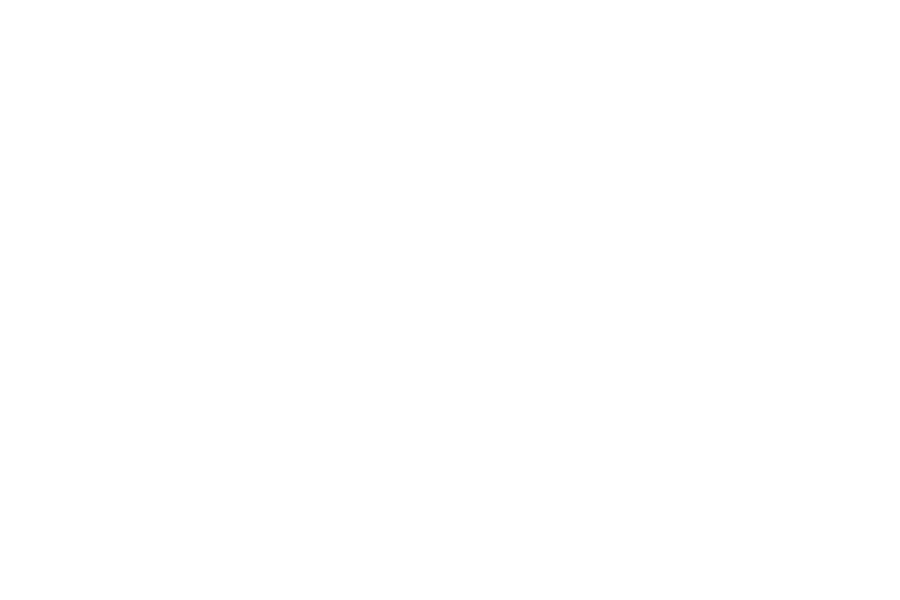

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 43


<IPython.core.display.Javascript object>

[UP, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


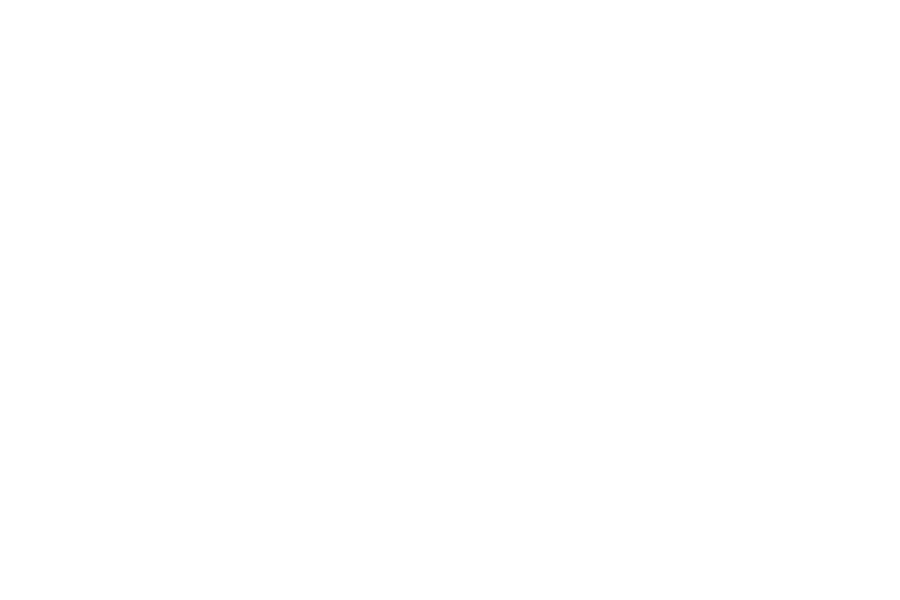

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.081565451311093
MAE(best):  0.040017503814532


<IPython.core.display.Javascript object>


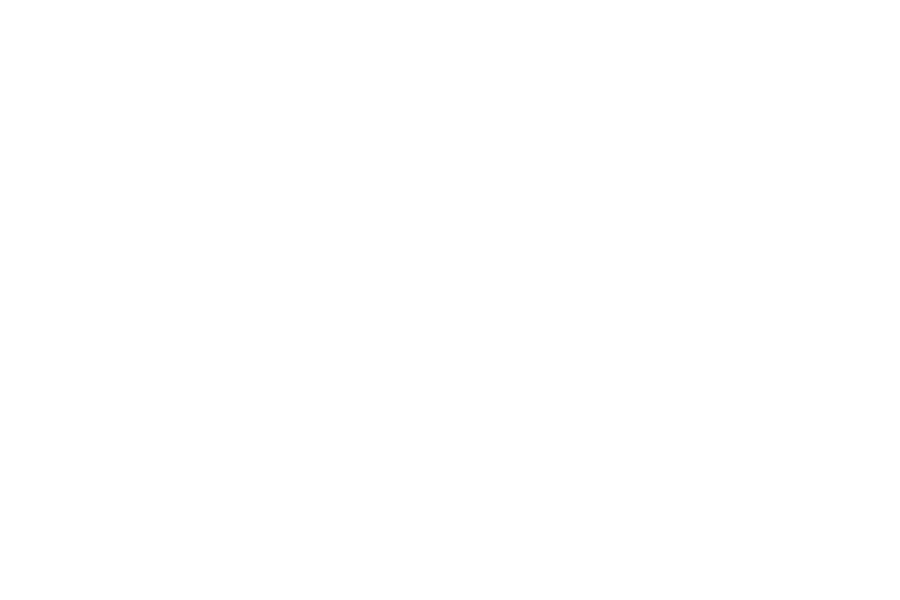

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 44


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


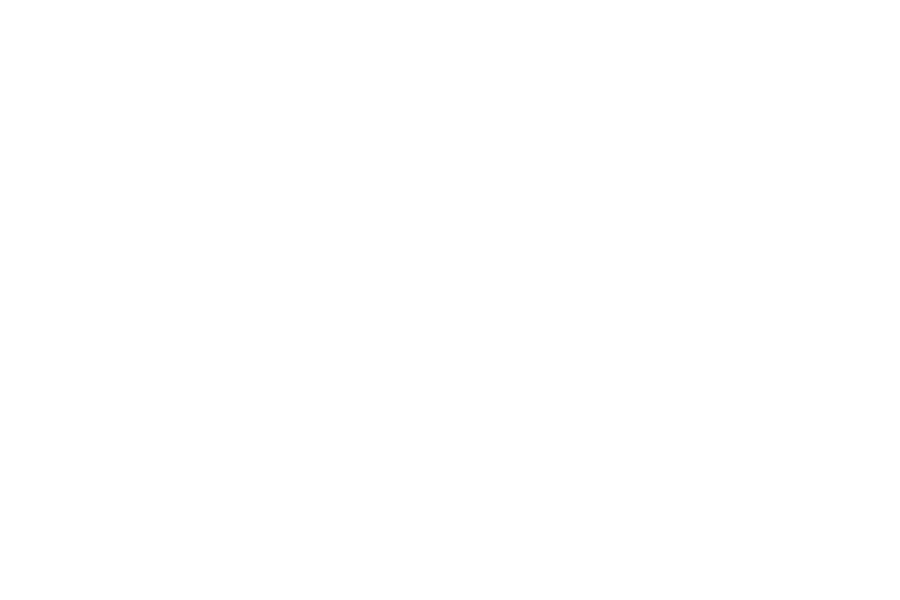

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.079653870278119
MAE(best):  0.047044754525945
MAE(best):  0.016357800136641
MAE(best):  0.015565552181561
MAE(best):  0.015332273272834


<IPython.core.display.Javascript object>


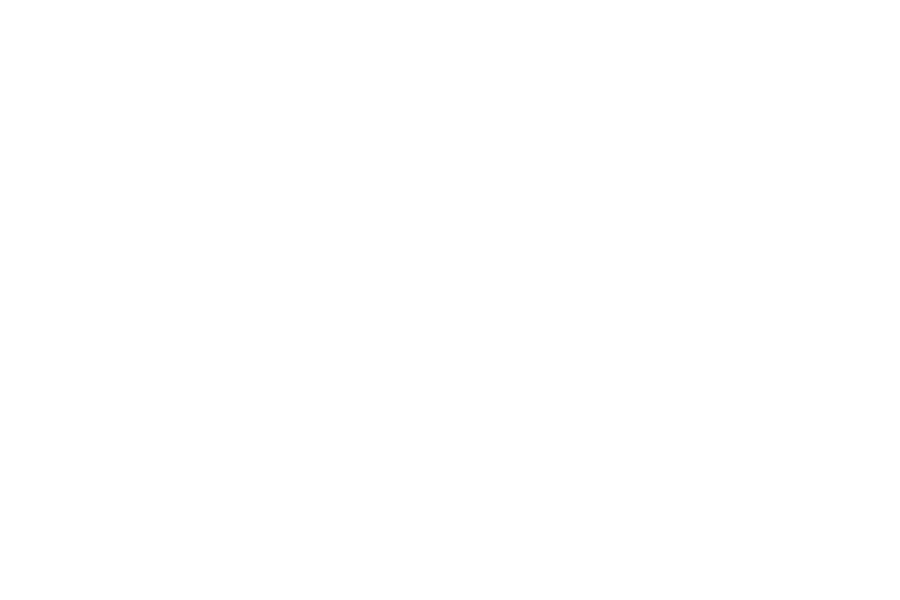

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 45


<IPython.core.display.Javascript object>

[UP_RIGHT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


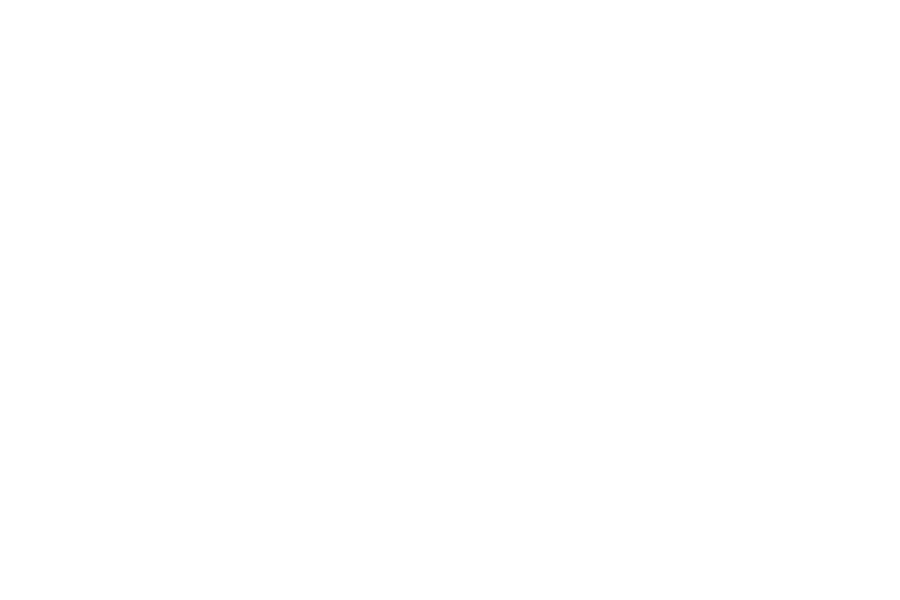

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.214526664441987
MAE(best):  0.085042940574251
MAE(best):  0.027419286537981
MAE(best):  0.017009172151655


<IPython.core.display.Javascript object>


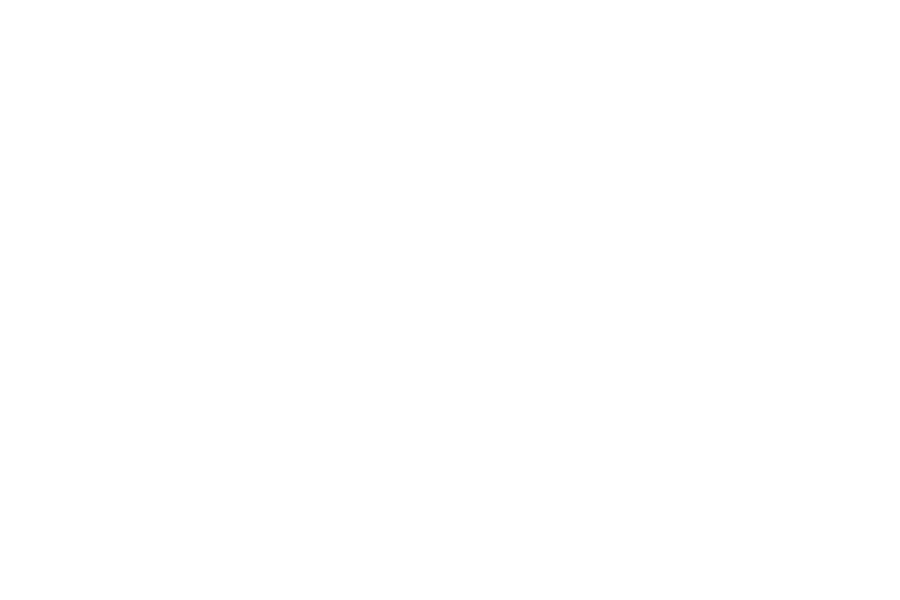

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 46


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


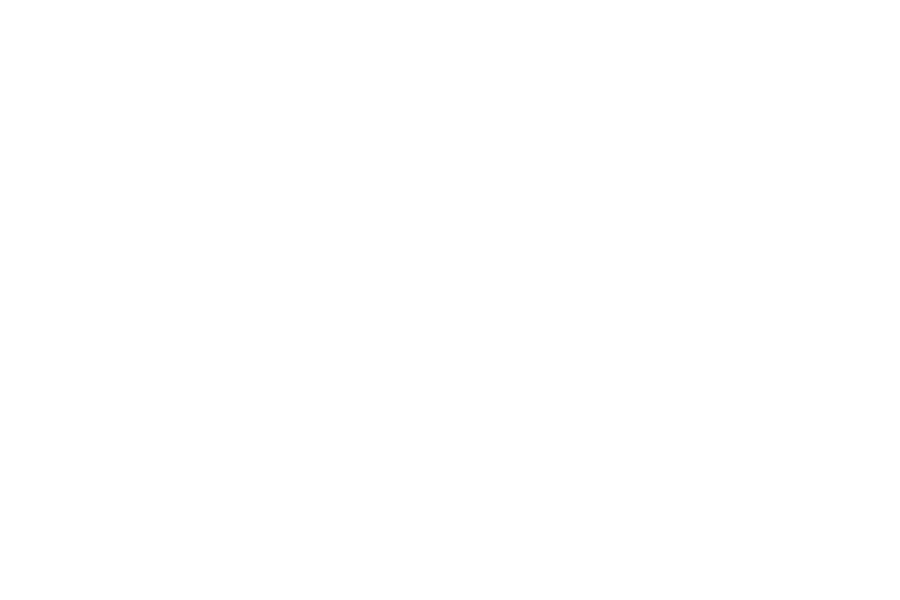

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.056645344401783
MAE(best):  0.020620031646396
MAE(best):  0.017717740859869
MAE(best):  0.015756077723444
MAE(best):  0.014265116915272


<IPython.core.display.Javascript object>


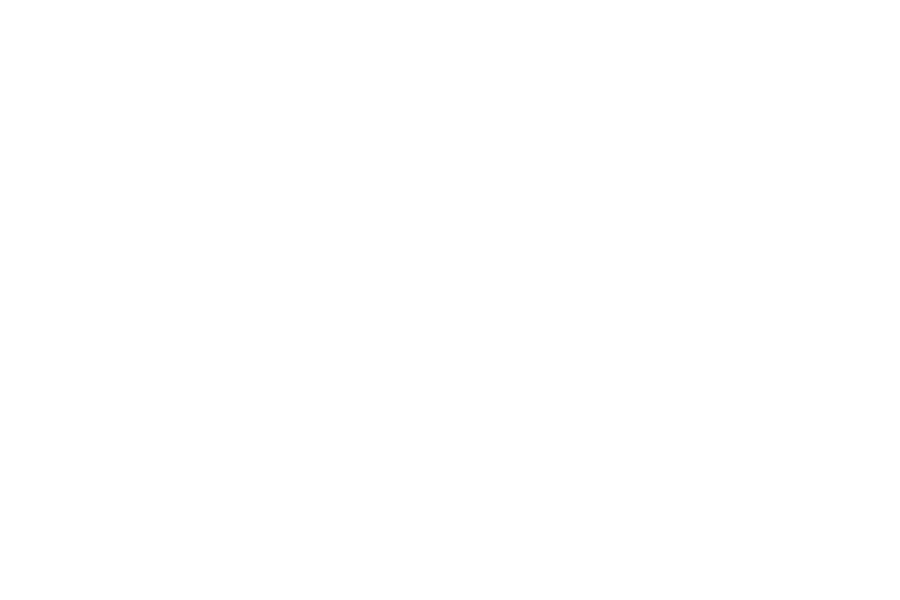

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 47


<IPython.core.display.Javascript object>

[UP_RIGHT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


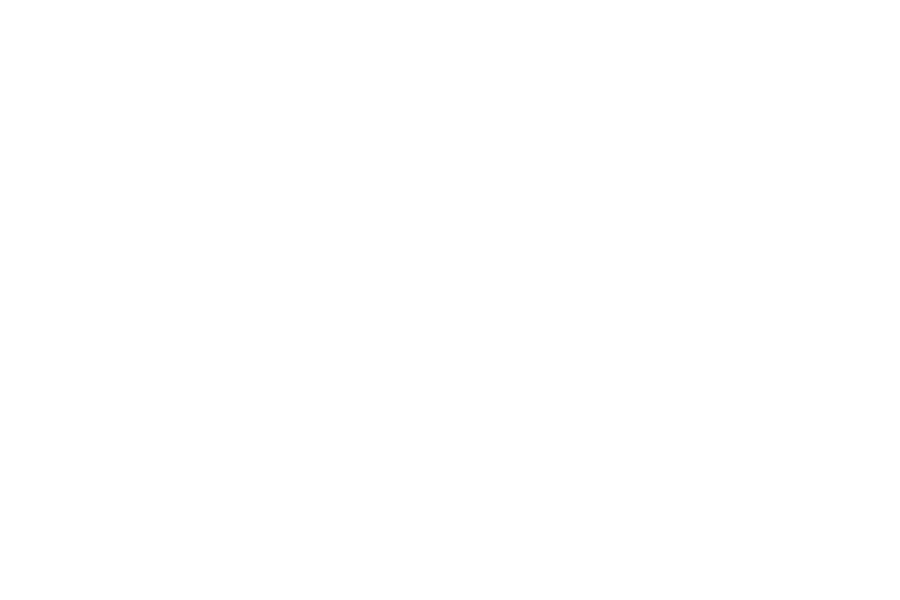

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.066681408613100
MAE(best):  0.055448664003166
MAE(best):  0.019545563748207
MAE(best):  0.018757012585666
MAE(best):  0.018515282222345


<IPython.core.display.Javascript object>


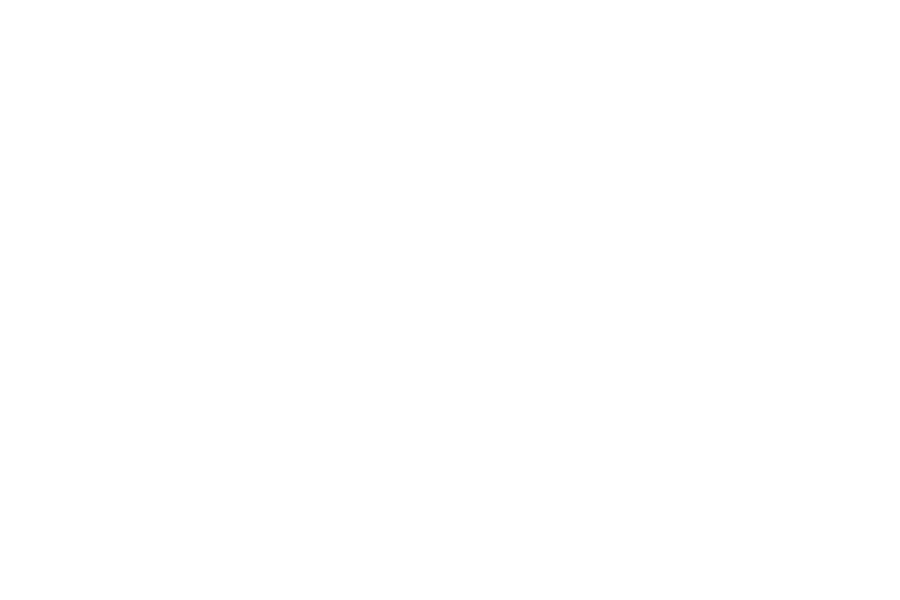

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 48


<IPython.core.display.Javascript object>

[DOWN, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


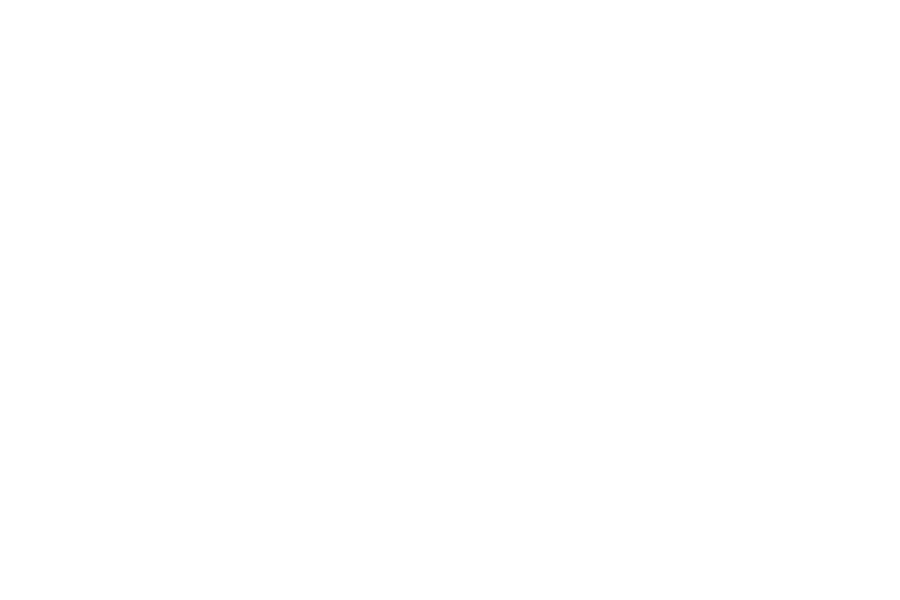

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.166842553467675


<IPython.core.display.Javascript object>


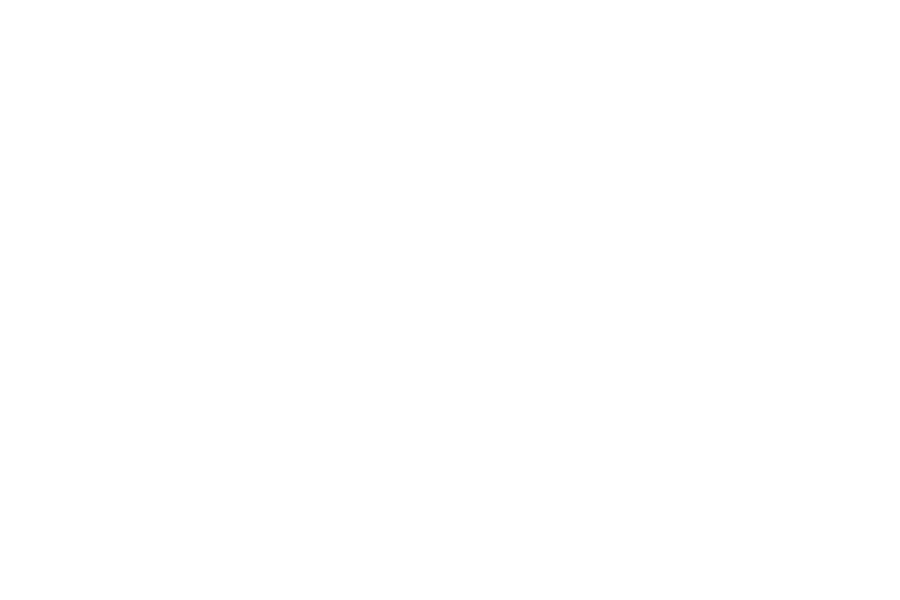

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 49


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


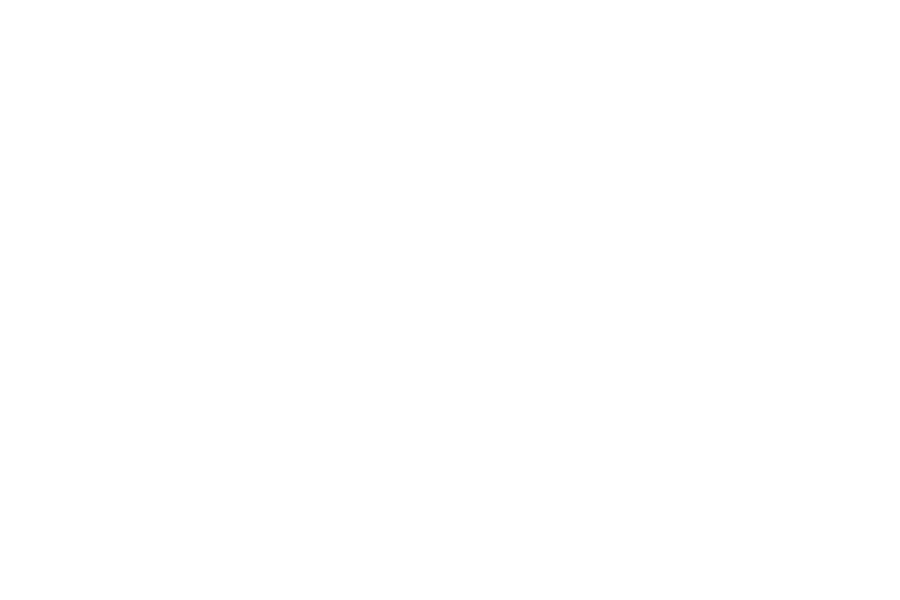

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.251180752163884
MAE(best):  0.093235506401600
MAE(best):  0.029227858707026
MAE(best):  0.022464961579837
MAE(best):  0.013120012926159


<IPython.core.display.Javascript object>


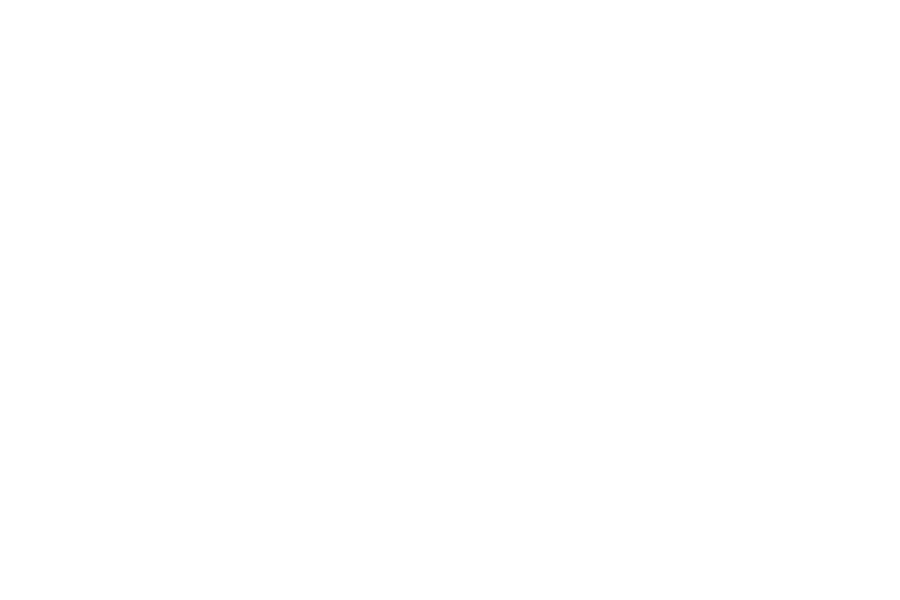

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 50


<IPython.core.display.Javascript object>

[UP_LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


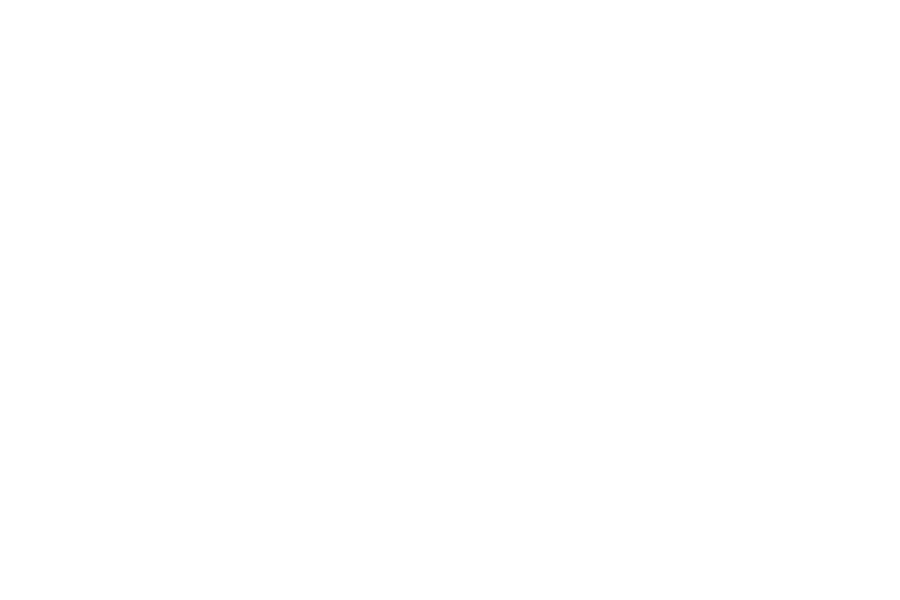

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.121989287262474
MAE(best):  0.015503329398078
MAE(best):  0.011905410668956
MAE(best):  0.011634958838629
MAE(best):  0.011582800194444


<IPython.core.display.Javascript object>


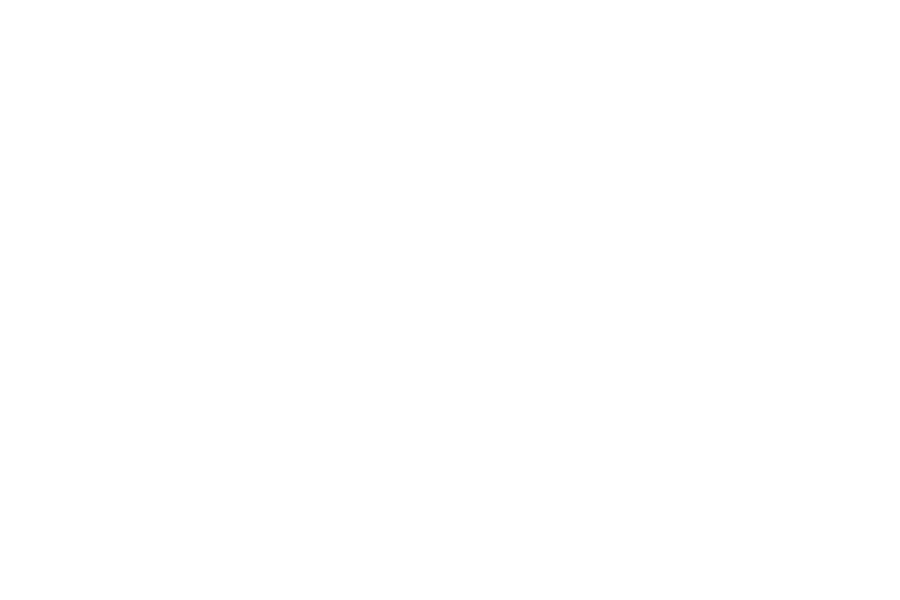

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 51


<IPython.core.display.Javascript object>

[UP_LEFT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


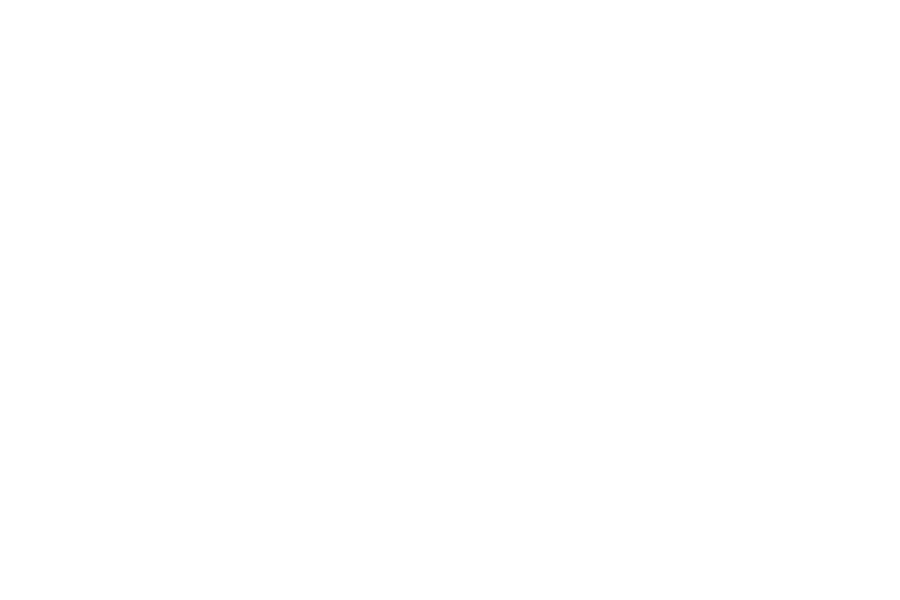

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.157709233255438
MAE(best):  0.075065284935392
MAE(best):  0.046493475797488
MAE(best):  0.031266739408389
MAE(best):  0.024493727179046


<IPython.core.display.Javascript object>


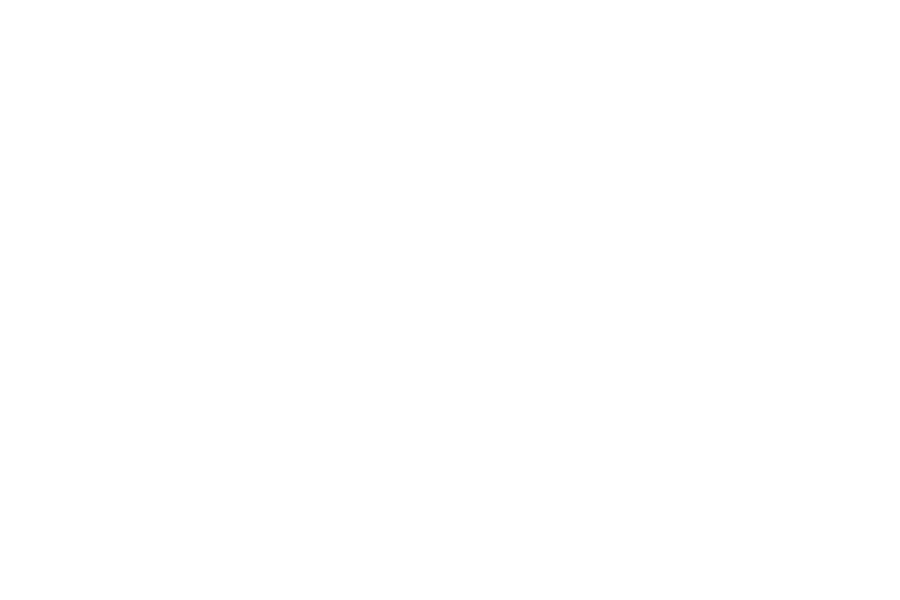

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 52


<IPython.core.display.Javascript object>

[DOWN, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


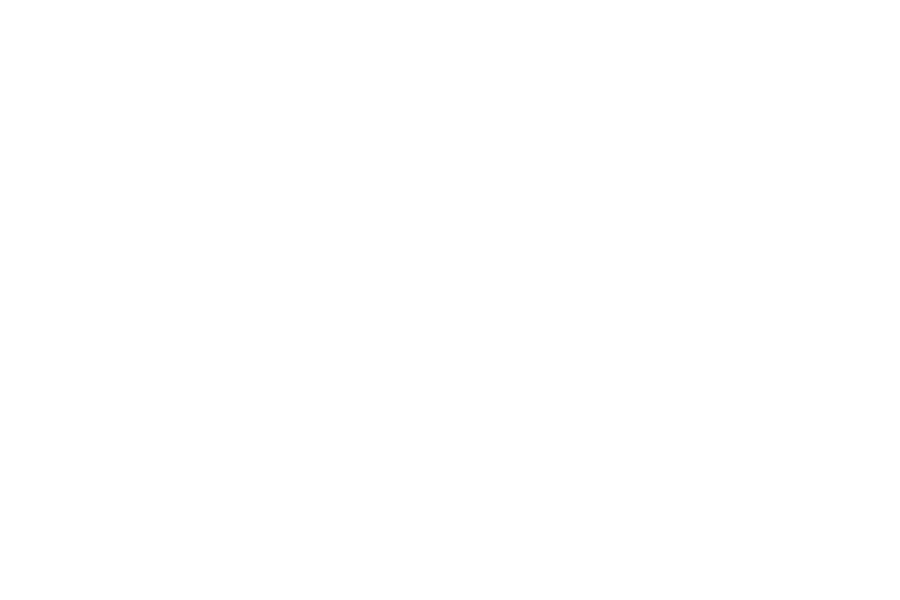

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.085179463582423


<IPython.core.display.Javascript object>


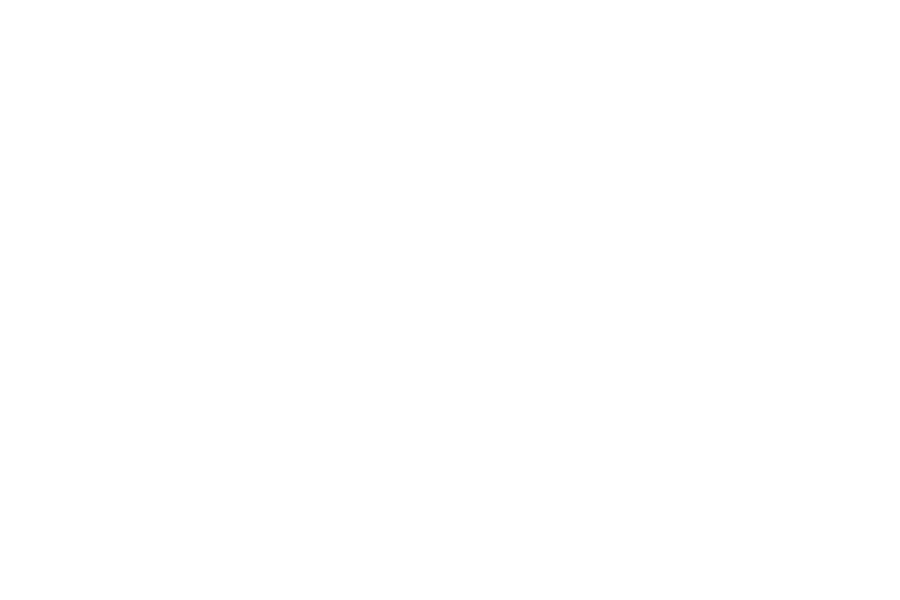

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 53


<IPython.core.display.Javascript object>

[UP_LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


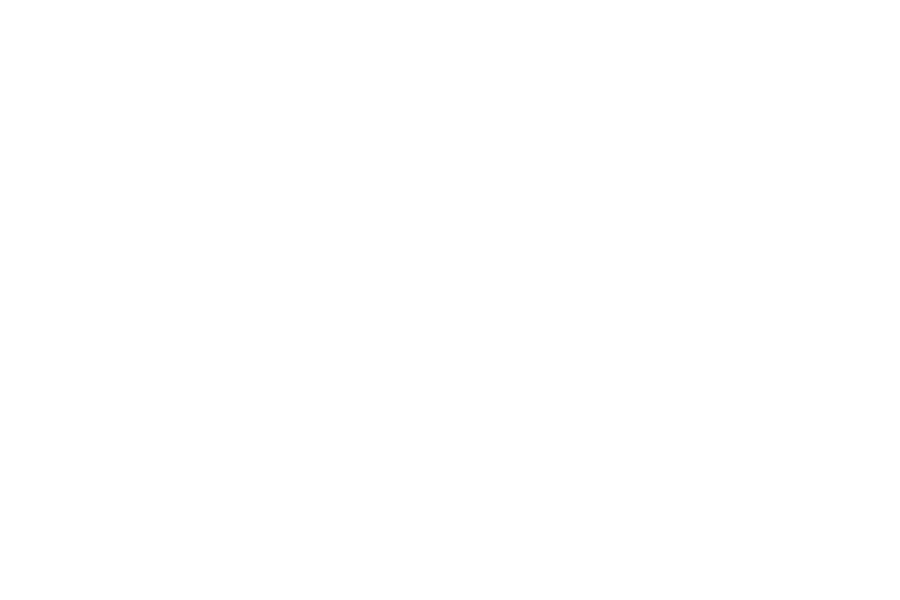

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.182317661993115
MAE(best):  0.061485967745844
MAE(best):  0.030278056653954
MAE(best):  0.021512169894629
MAE(best):  0.017076268009919


<IPython.core.display.Javascript object>


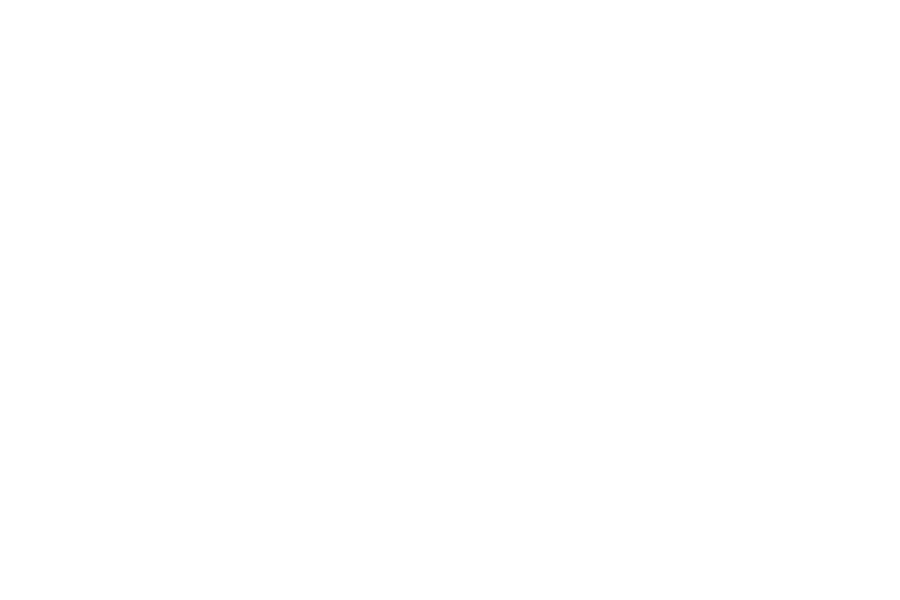

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 54


<IPython.core.display.Javascript object>

[UP_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


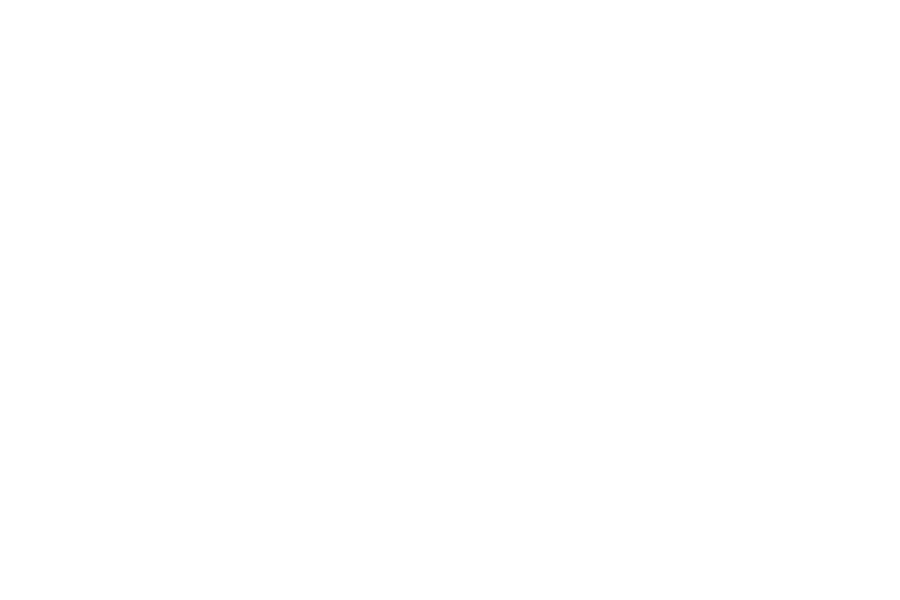

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.140671415032884
MAE(best):  0.075298561784400


<IPython.core.display.Javascript object>


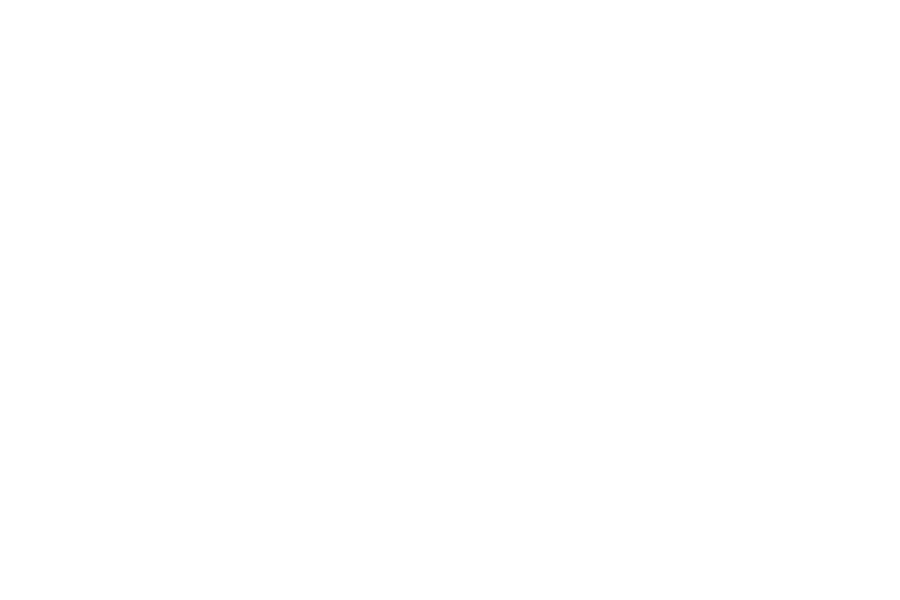

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 55


<IPython.core.display.Javascript object>

[LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


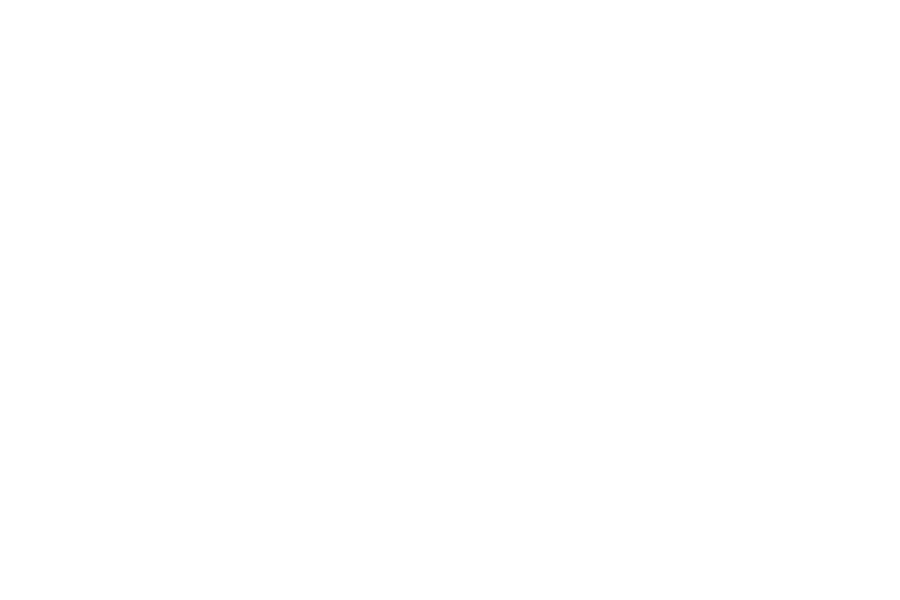

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.165772018113529
MAE(best):  0.083541046652398
MAE(best):  0.047913939706054
MAE(best):  0.032303563684776
MAE(best):  0.025606902543374


<IPython.core.display.Javascript object>


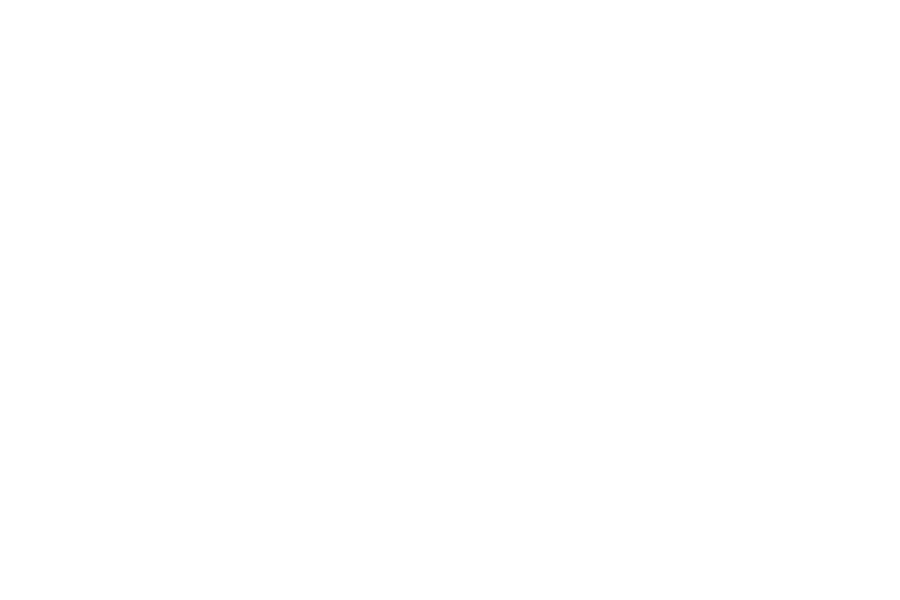

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 56


<IPython.core.display.Javascript object>

[UP_LEFT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


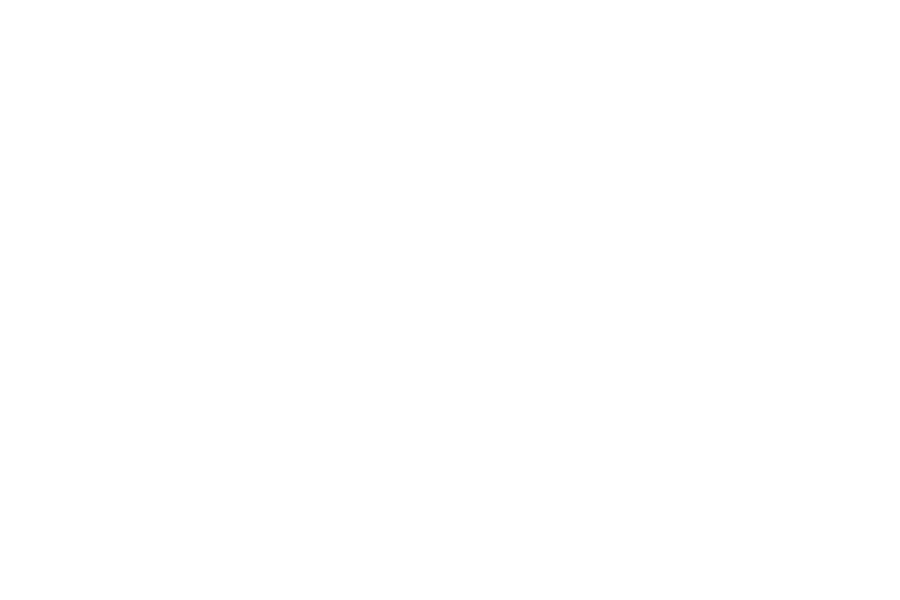

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.243371366228865
MAE(best):  0.059802535962080
MAE(best):  0.025213725422831
MAE(best):  0.025213725422831
MAE(best):  0.013759700006158


<IPython.core.display.Javascript object>


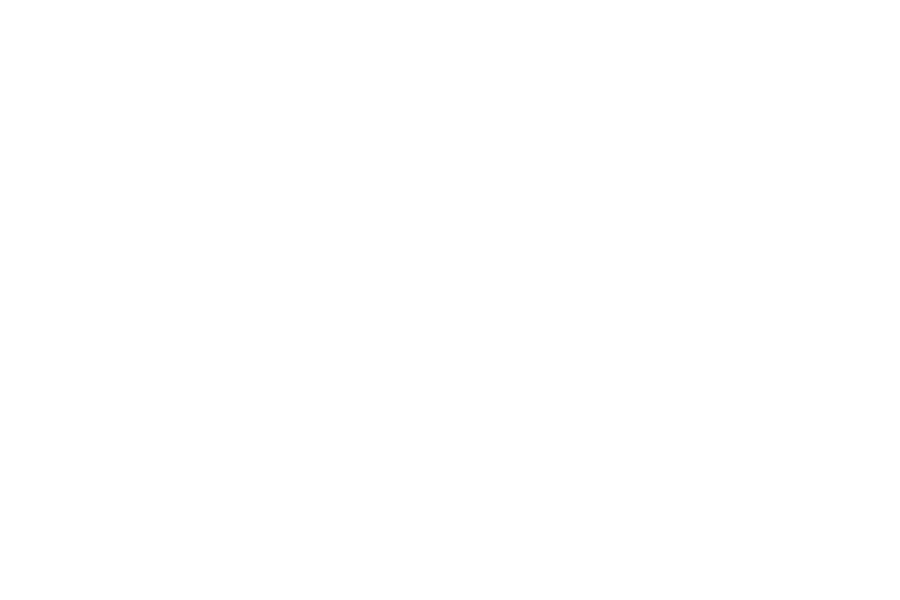

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 57


<IPython.core.display.Javascript object>

[UP, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


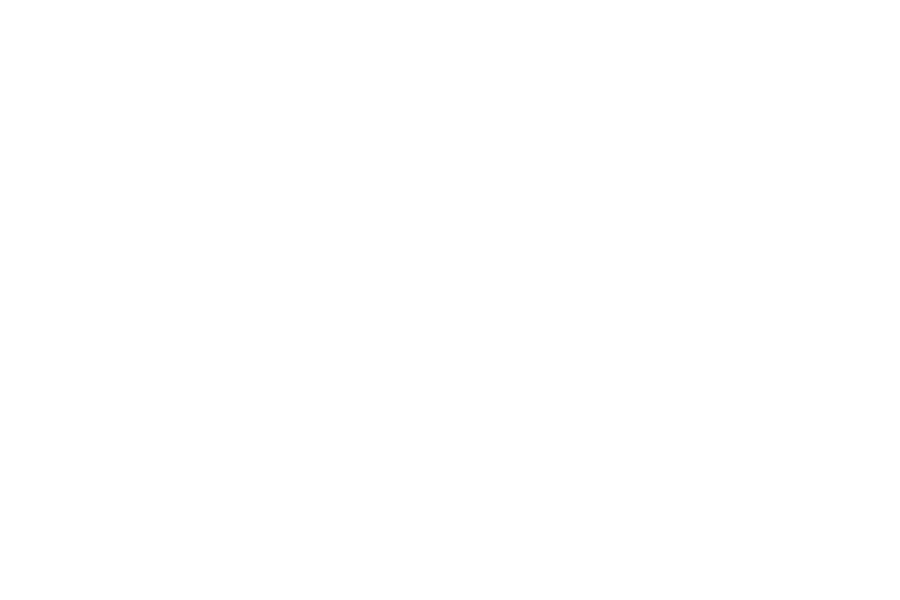

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.021969401547649


<IPython.core.display.Javascript object>


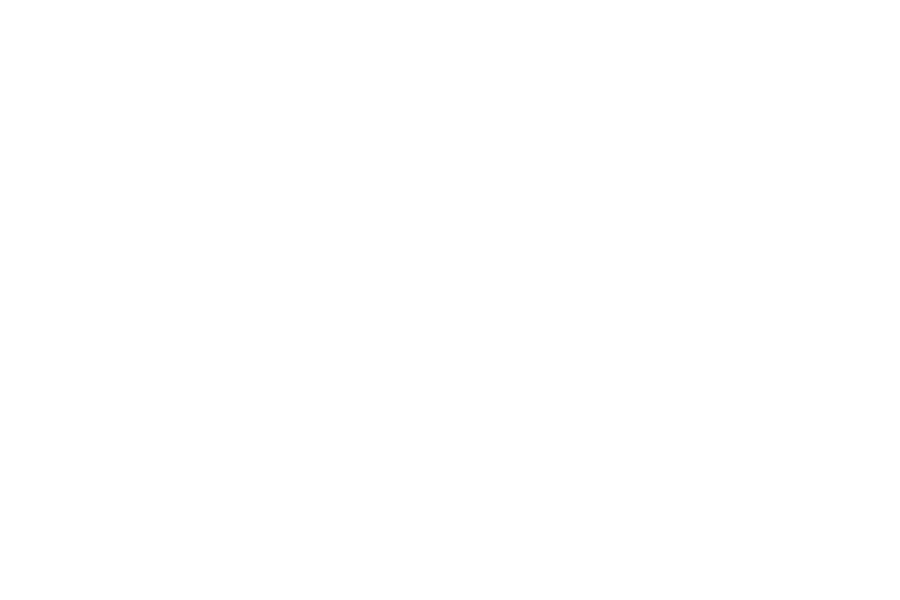

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 58


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


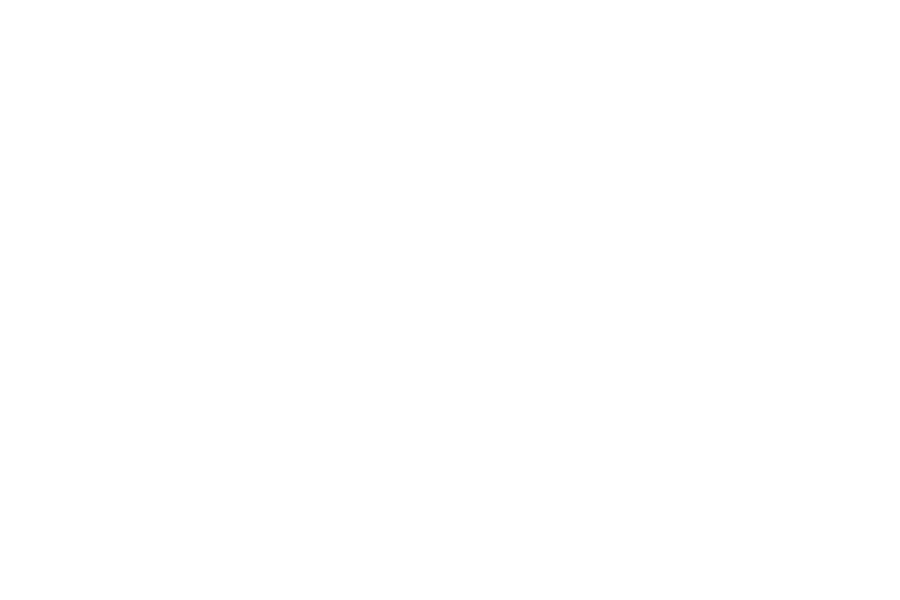

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.014916376167269


<IPython.core.display.Javascript object>


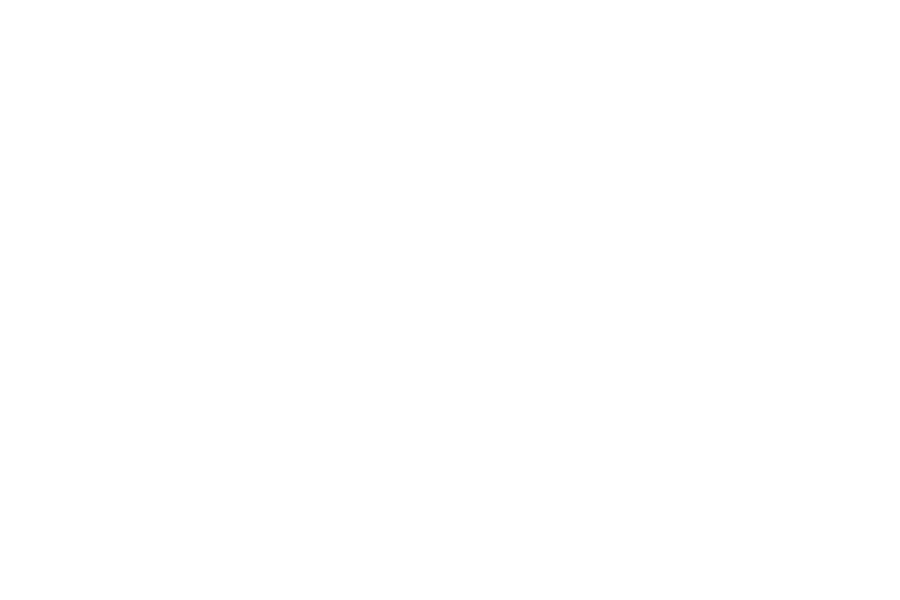

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 59


<IPython.core.display.Javascript object>

[DOWN_LEFT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


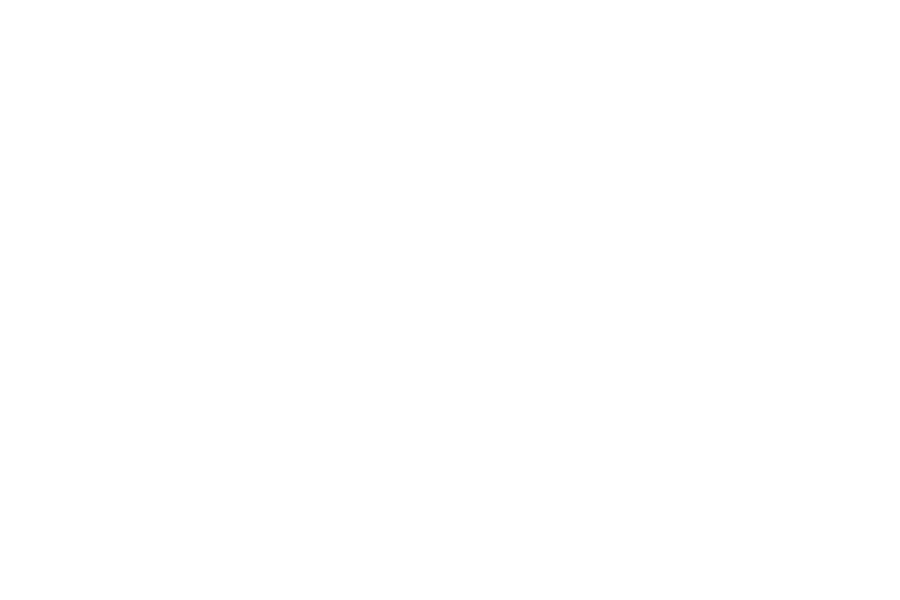

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.012879066401004


<IPython.core.display.Javascript object>


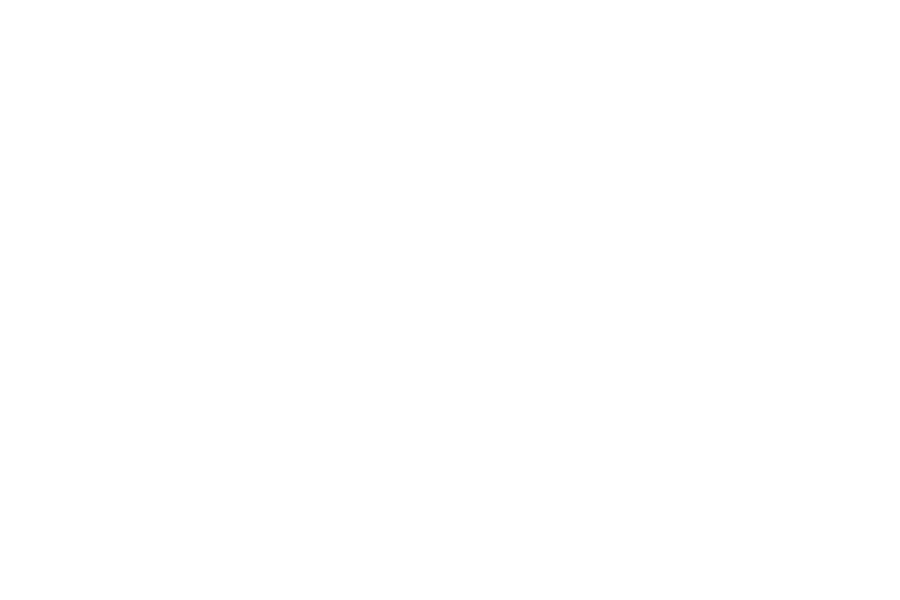

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 60


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


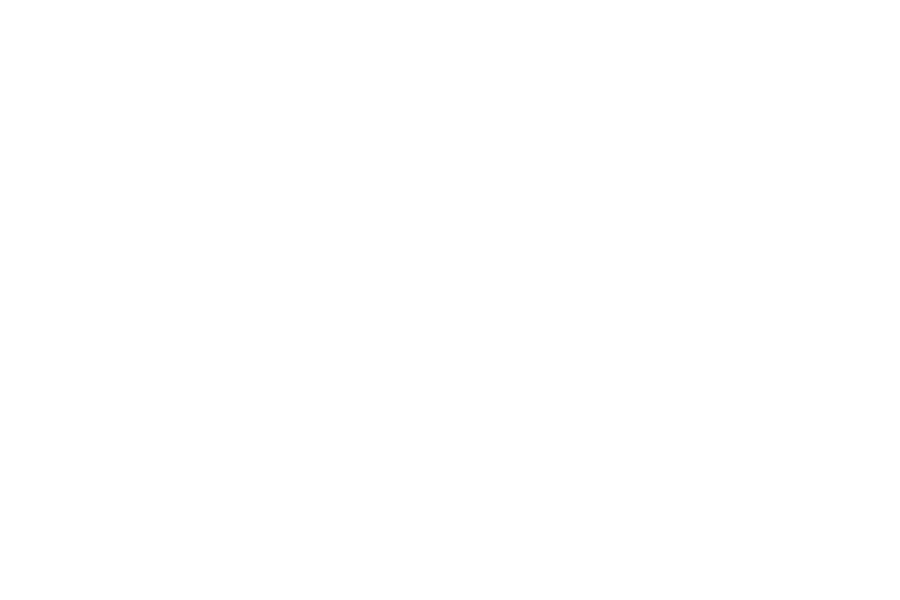

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.031691243647269
MAE(best):  0.024026179443297
MAE(best):  0.012766547428782


<IPython.core.display.Javascript object>


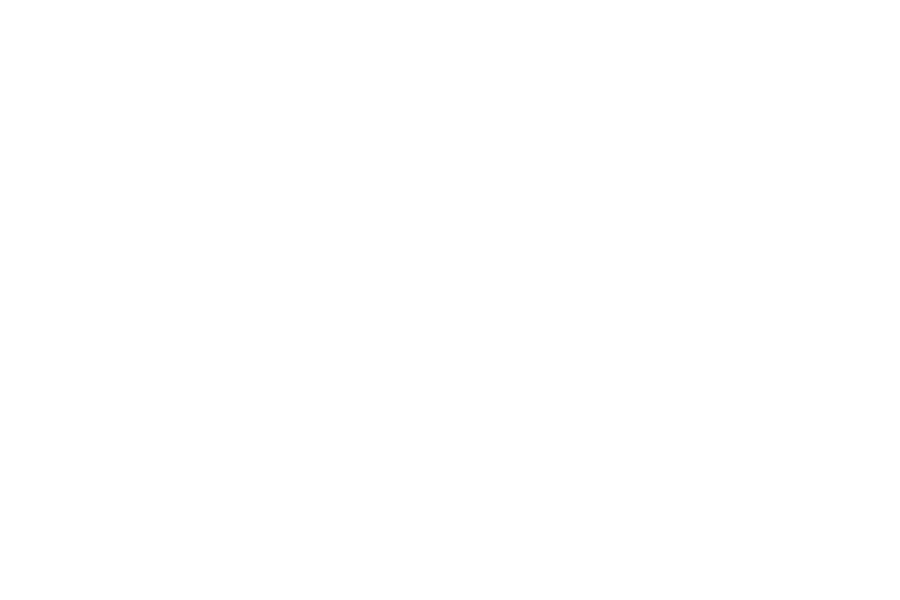

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 61


<IPython.core.display.Javascript object>

[UP, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


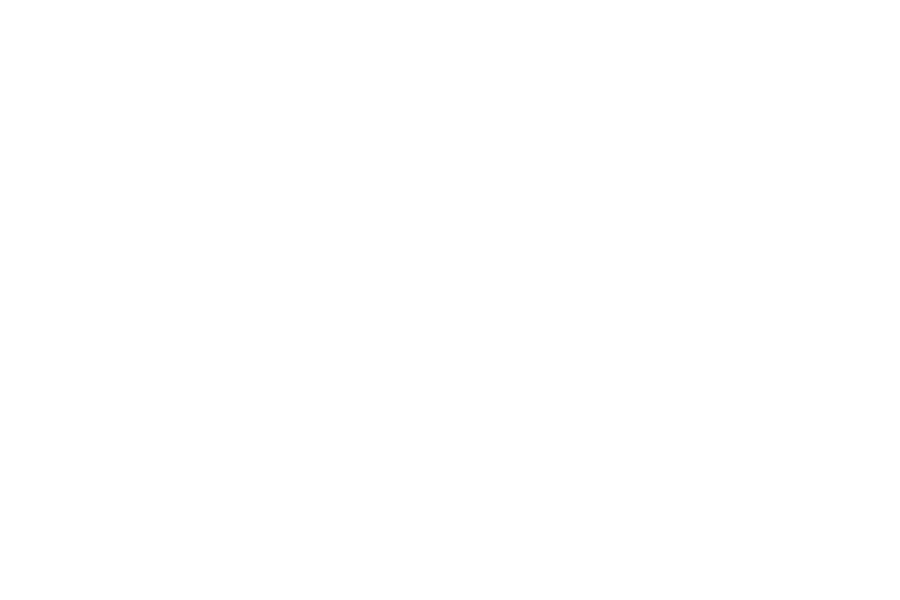

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.092717714146796
MAE(best):  0.023020906562791
MAE(best):  0.020301481020683
MAE(best):  0.017130709021311
MAE(best):  0.013371254619465


<IPython.core.display.Javascript object>


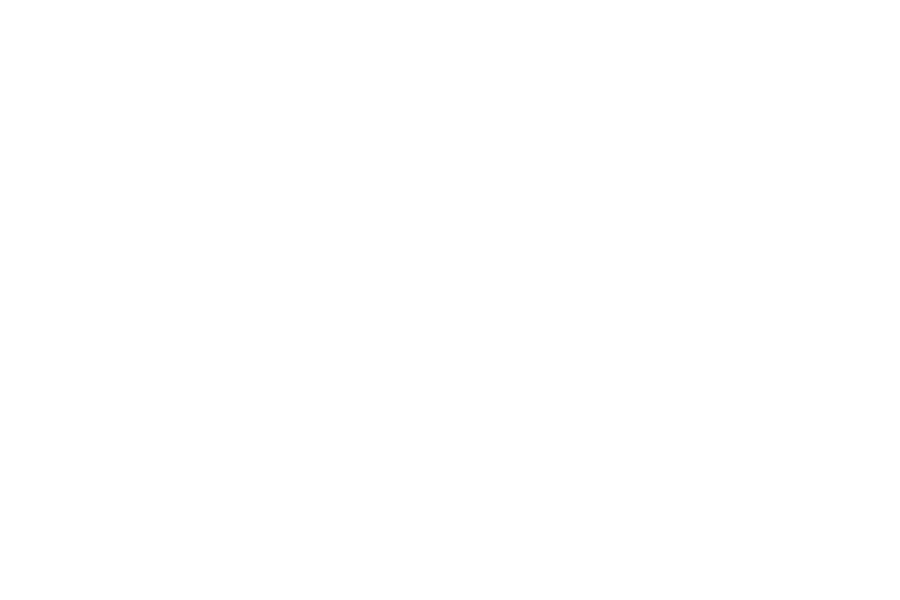

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 62


<IPython.core.display.Javascript object>

[UP_LEFT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


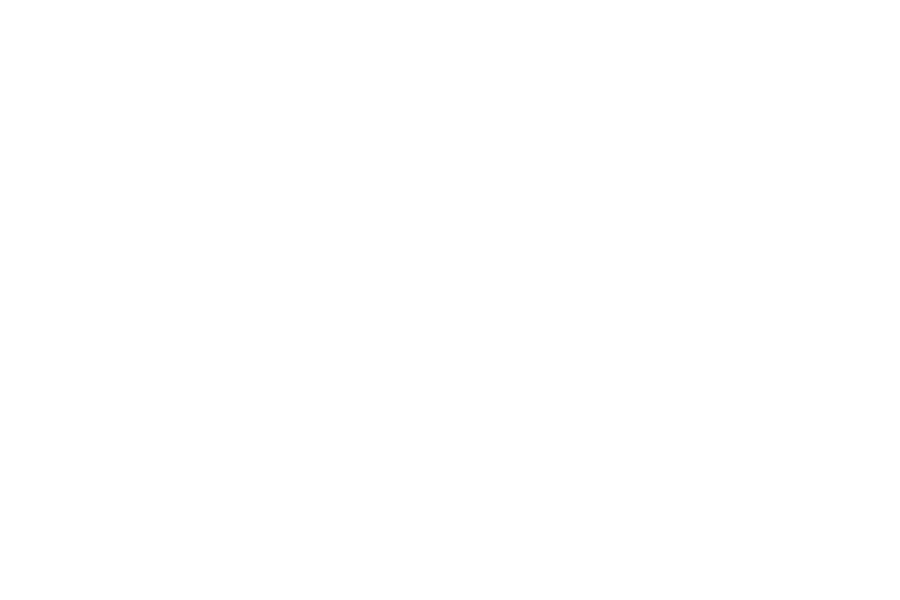

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.016787798513771


<IPython.core.display.Javascript object>


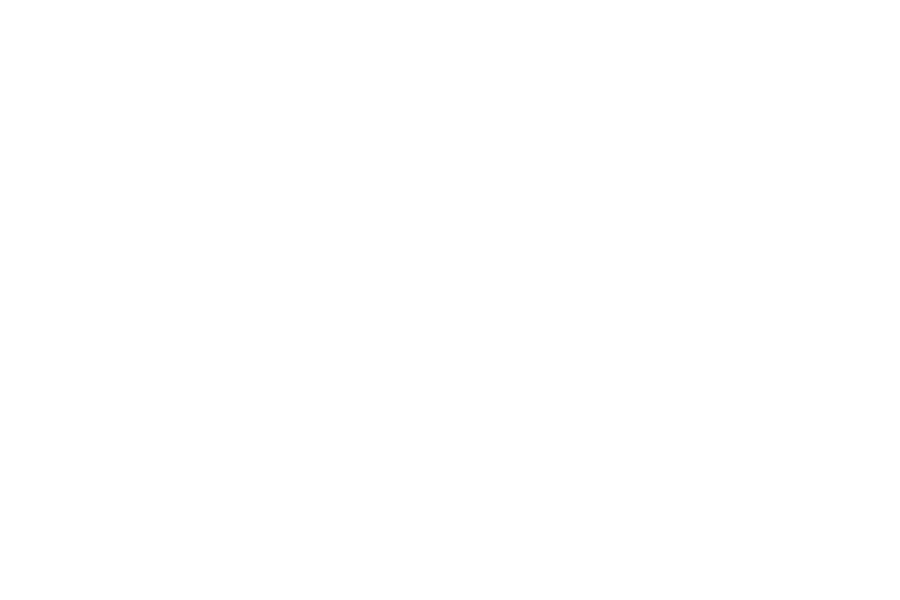

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 63


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


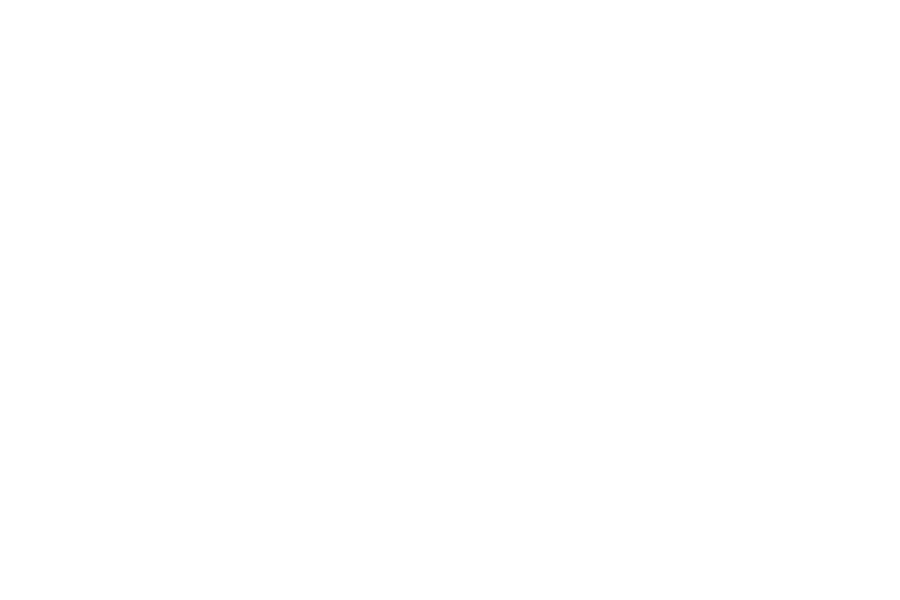

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.056562530101293
MAE(best):  0.025826465472348
MAE(best):  0.022100296152331
MAE(best):  0.022100296152331
MAE(best):  0.020175463635228


<IPython.core.display.Javascript object>


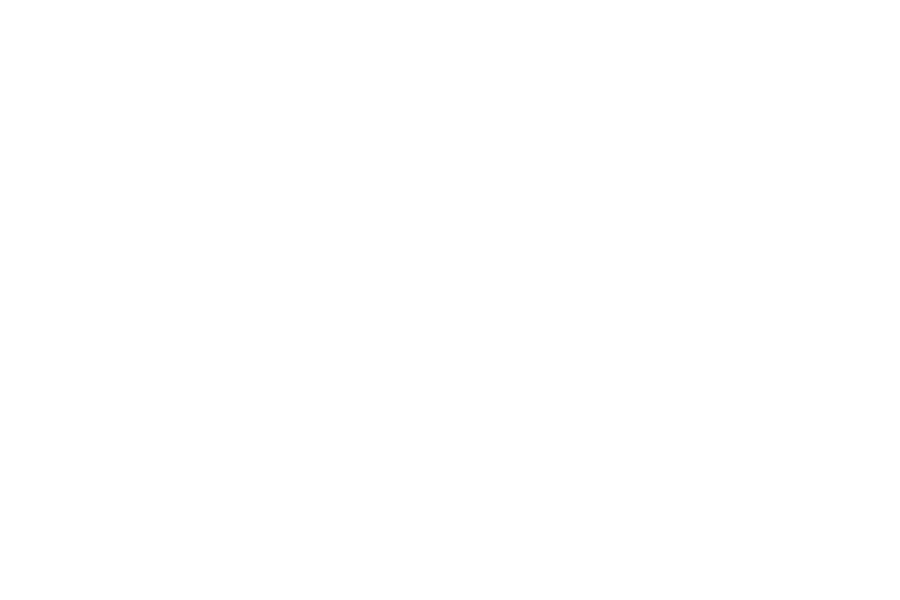

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 64


<IPython.core.display.Javascript object>

[UP_RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


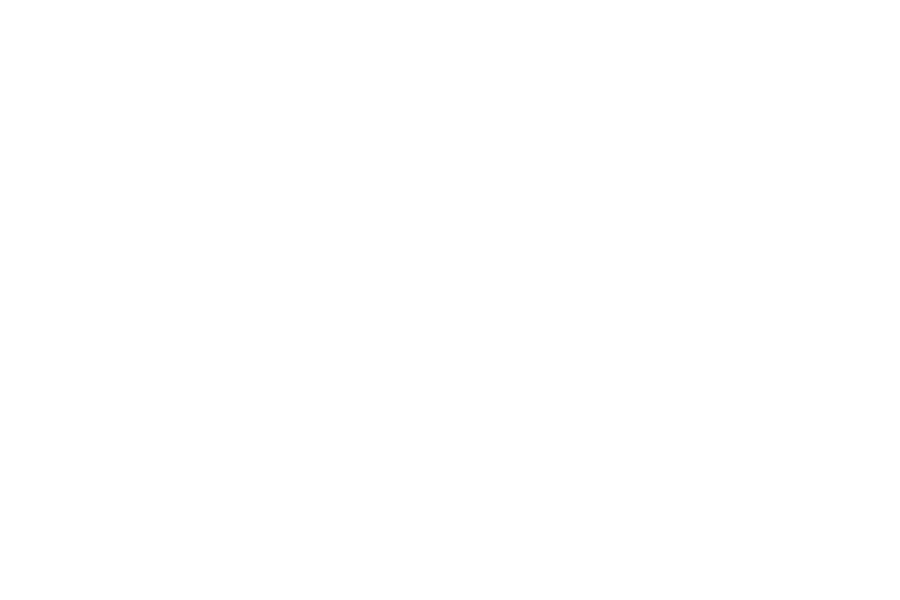

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.245687924770177
MAE(best):  0.027707604054868
MAE(best):  0.011045501952653
MAE(best):  0.010944860740233
MAE(best):  0.010576482249763


<IPython.core.display.Javascript object>


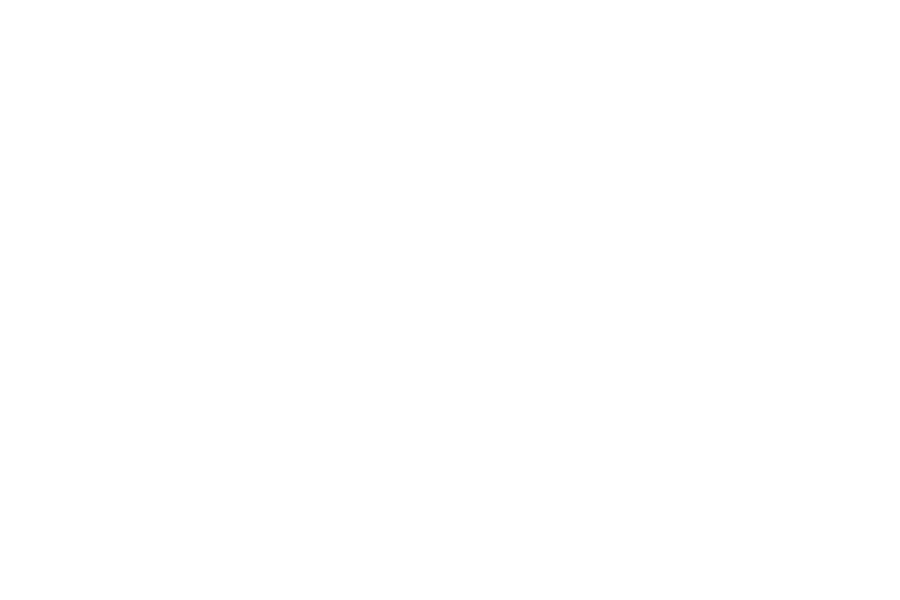

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 65


<IPython.core.display.Javascript object>

[UP_RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


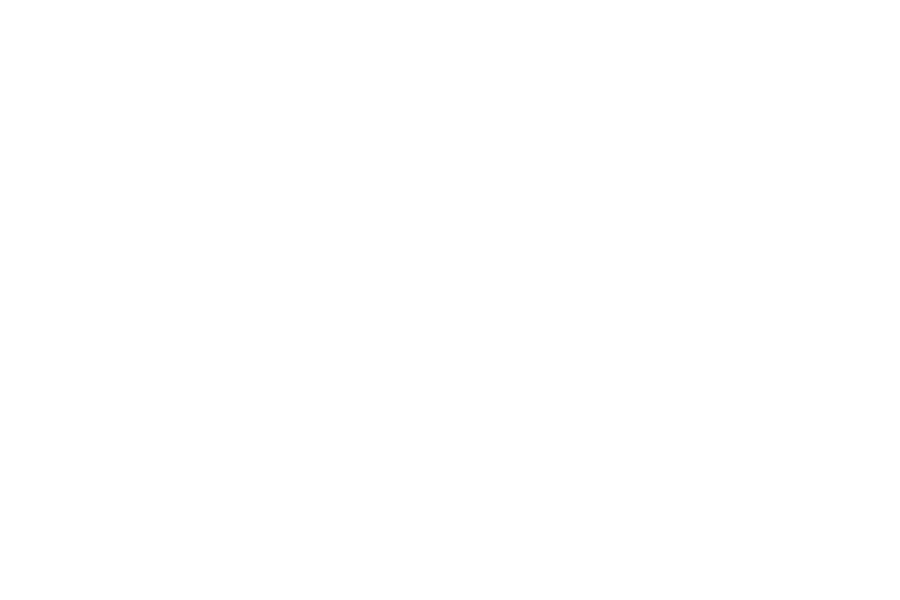

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.224031715668349
MAE(best):  0.030048660645983
MAE(best):  0.010258787903868


<IPython.core.display.Javascript object>


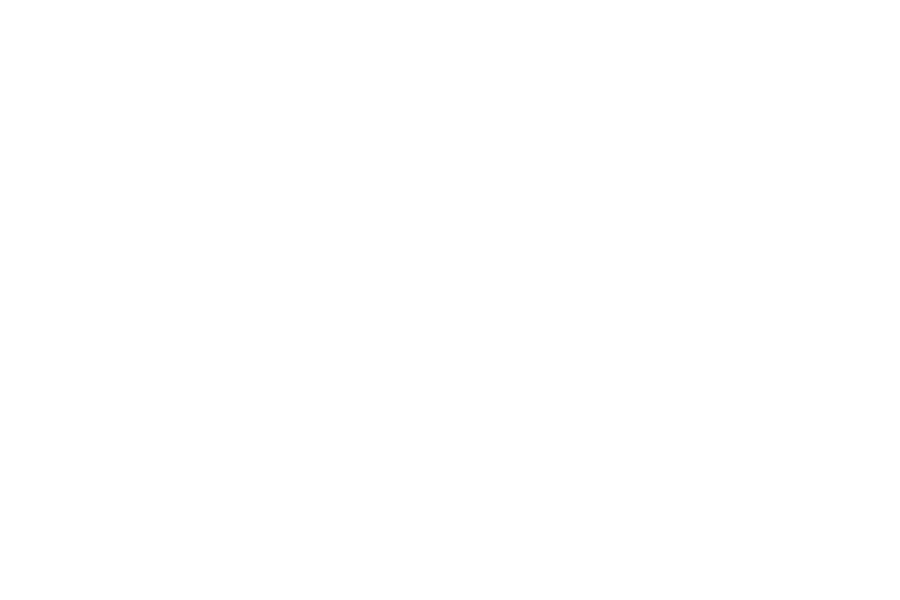

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 66


<IPython.core.display.Javascript object>

[RIGHT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


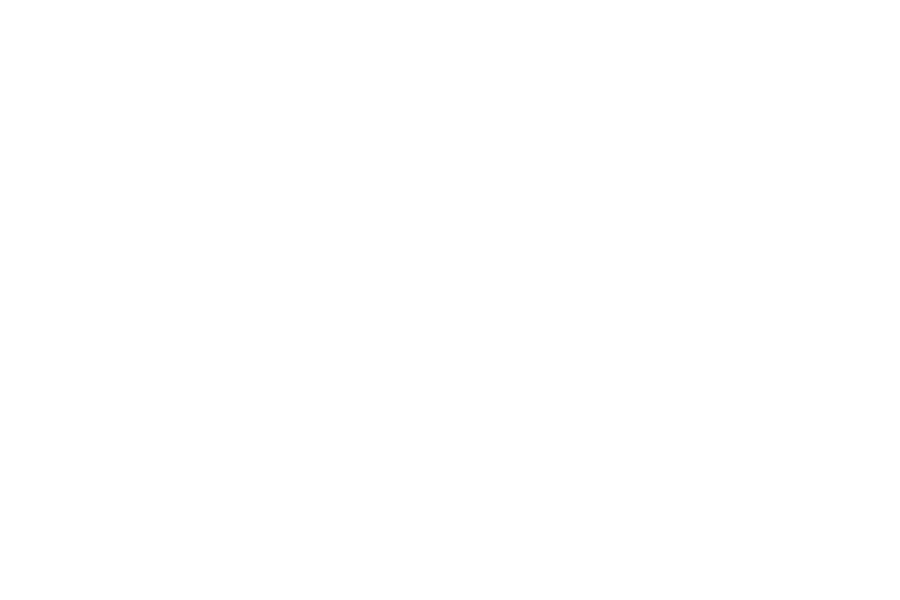

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.075389277027741
MAE(best):  0.021659053897584
MAE(best):  0.016150495124249
MAE(best):  0.013604866186555
MAE(best):  0.011026421221814


<IPython.core.display.Javascript object>


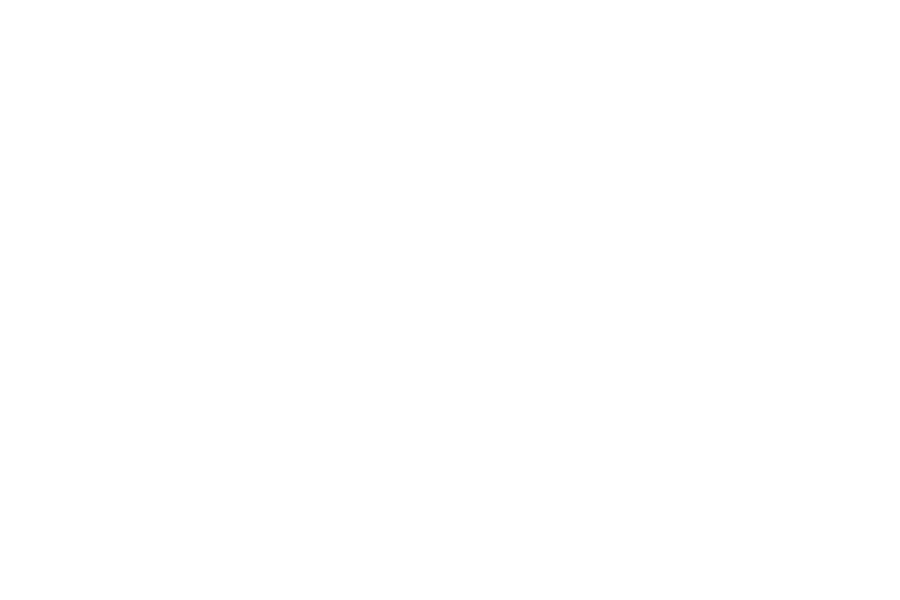

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 67


<IPython.core.display.Javascript object>

[LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


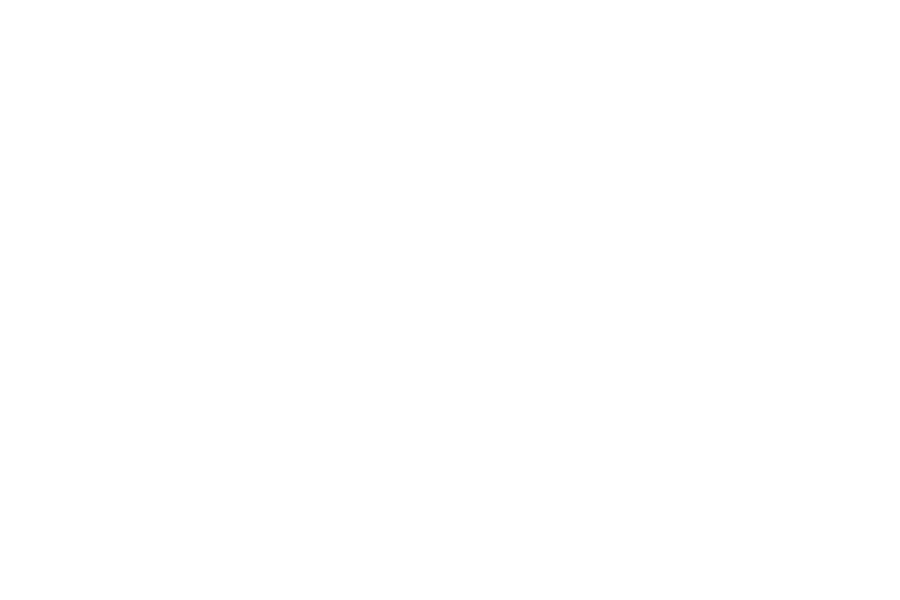

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.449073397659363
MAE(best):  0.163903503100807
MAE(best):  0.160519074096876
MAE(best):  0.158088935101493
MAE(best):  0.153534807174785


<IPython.core.display.Javascript object>


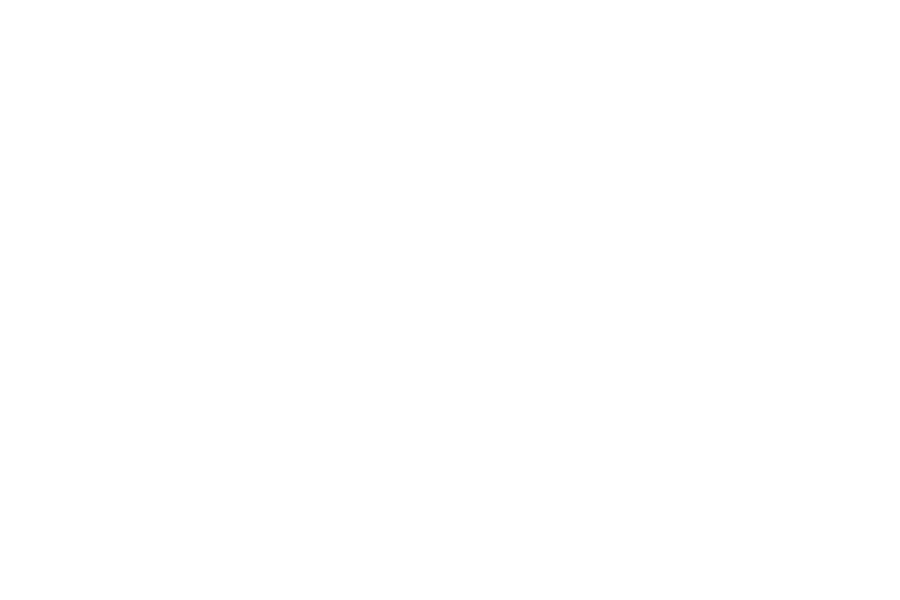

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 68


<IPython.core.display.Javascript object>

[UP_RIGHT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


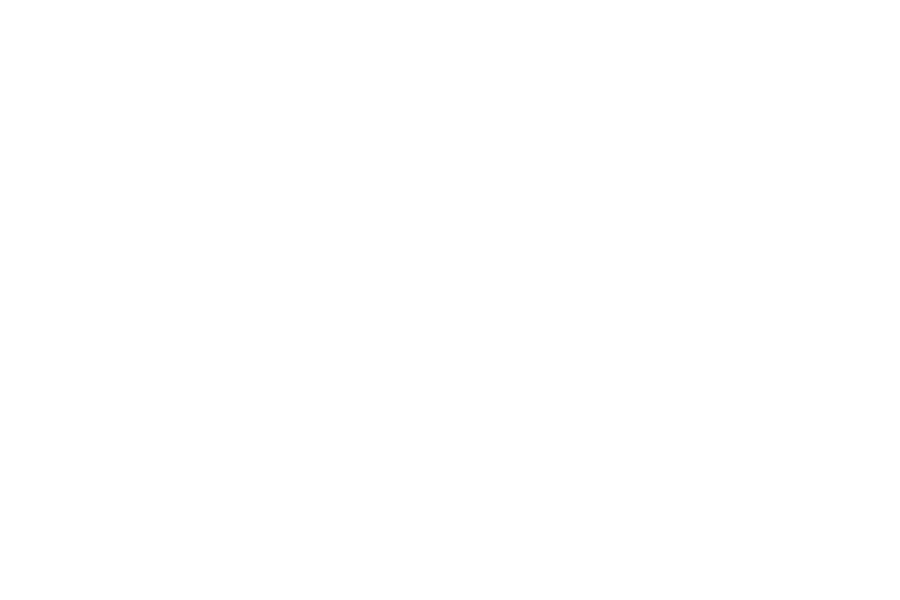

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.114568353419226
MAE(best):  0.066177702162494
MAE(best):  0.032326147296329
MAE(best):  0.024776495324550
MAE(best):  0.021277069516902


<IPython.core.display.Javascript object>


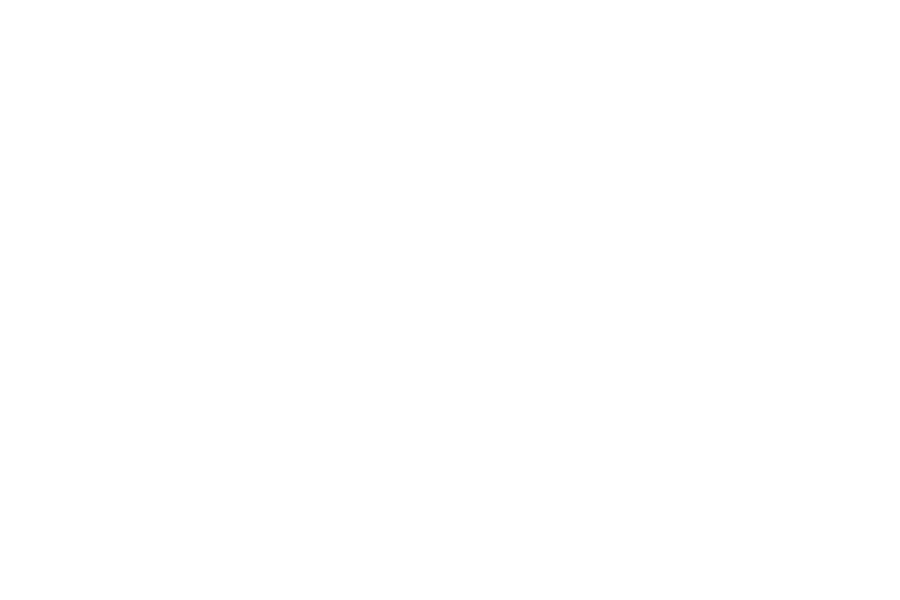

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 69


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


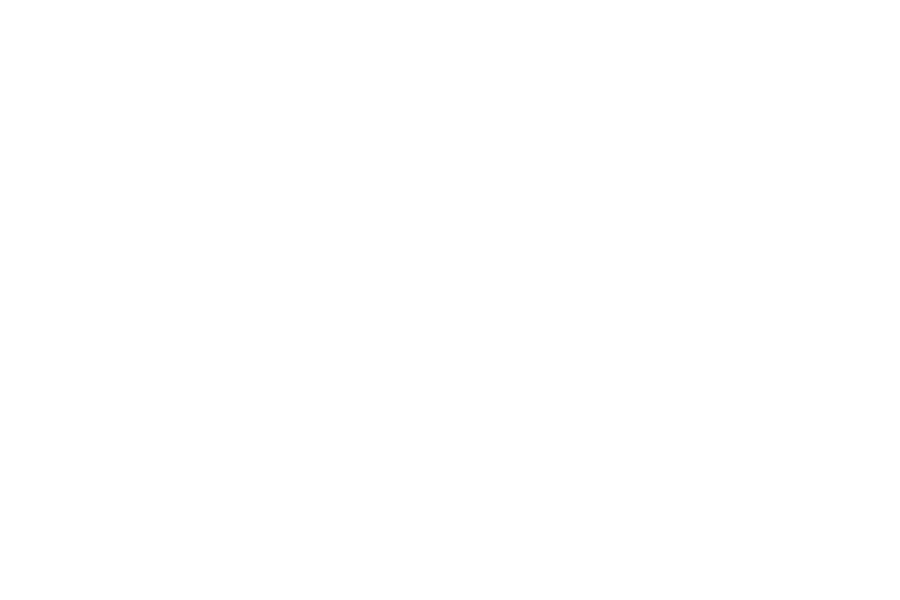

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.123181513681697
MAE(best):  0.085757556564389
MAE(best):  0.023527624113219


<IPython.core.display.Javascript object>


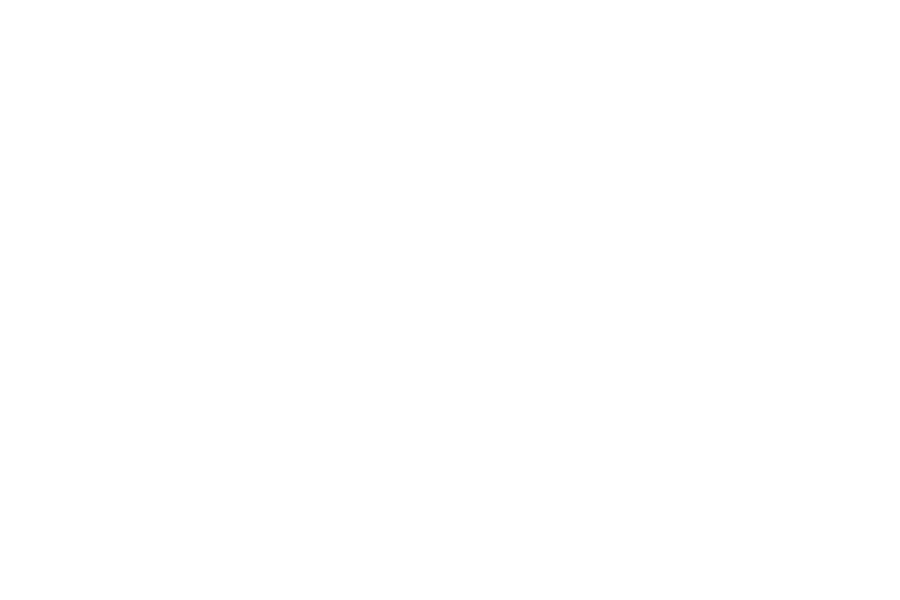

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 70


<IPython.core.display.Javascript object>

[UP_LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


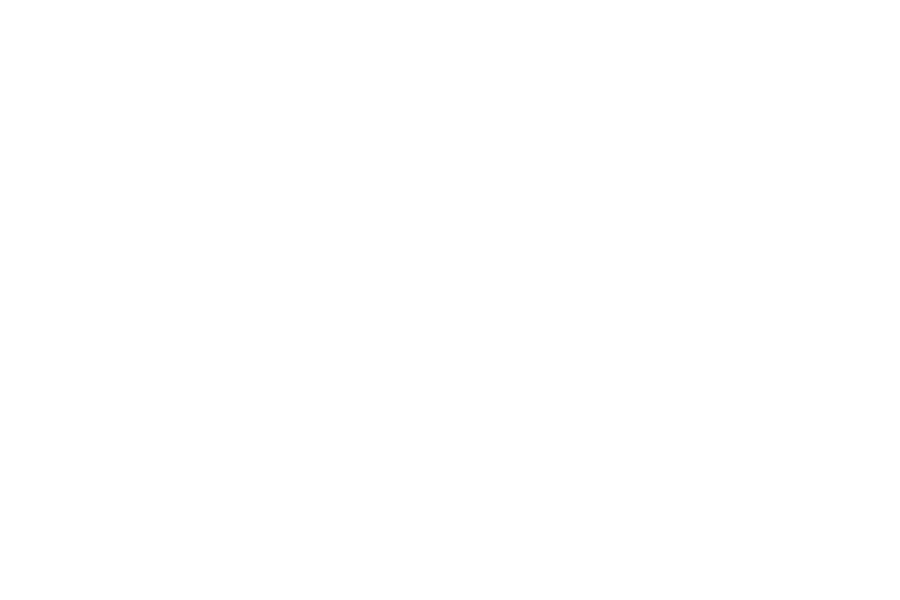

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.046325060678241
MAE(best):  0.026975669343703


<IPython.core.display.Javascript object>


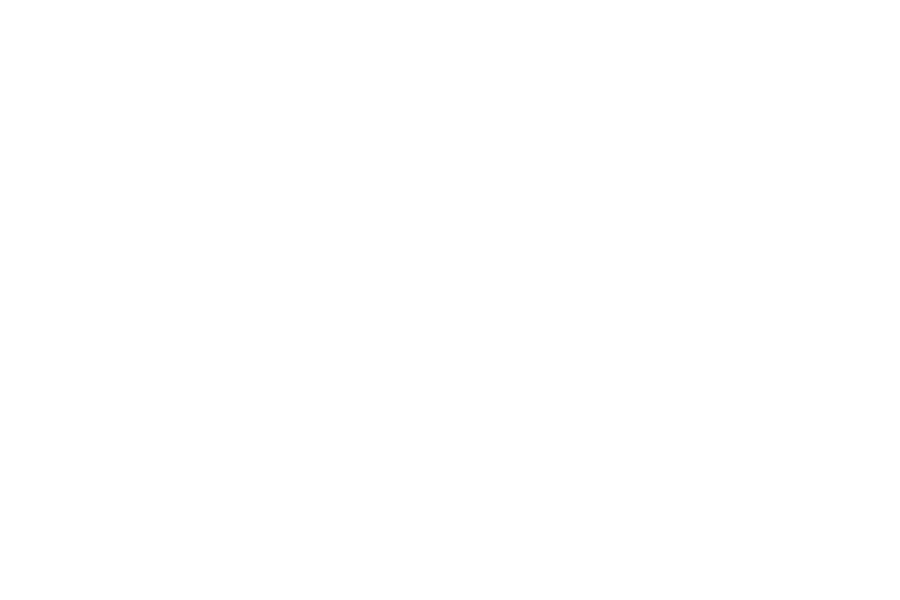

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 71


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


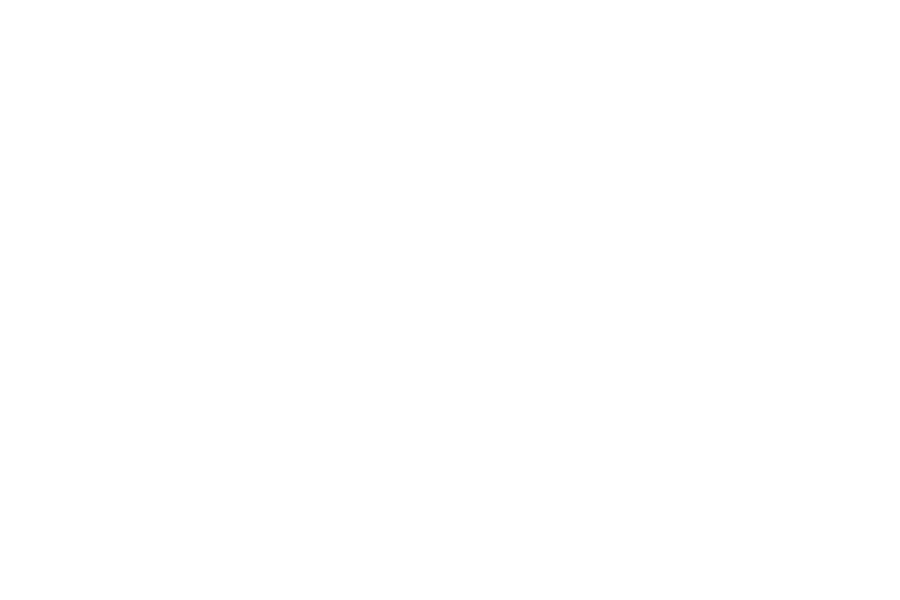

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  4.924888281220686


<IPython.core.display.Javascript object>


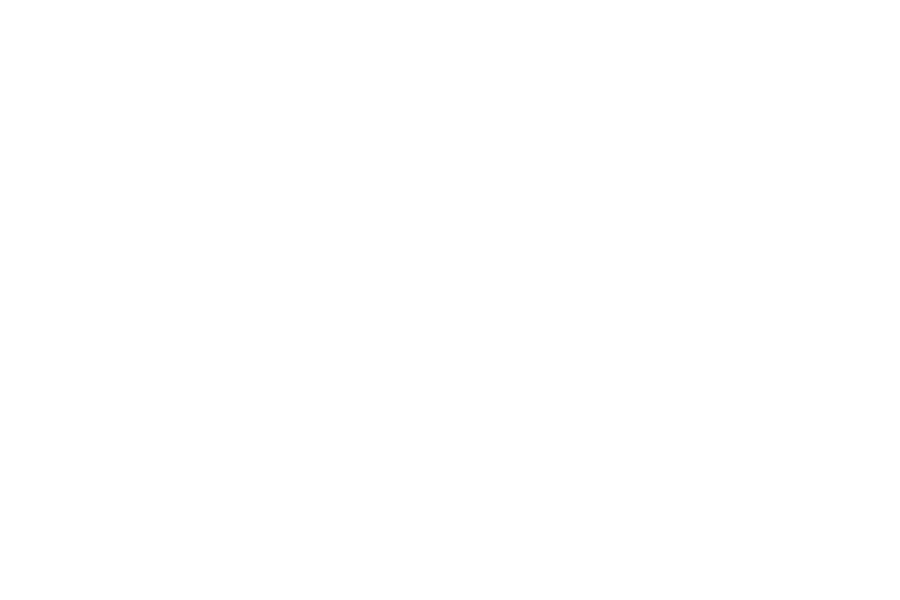

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 72


<IPython.core.display.Javascript object>

[UP_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


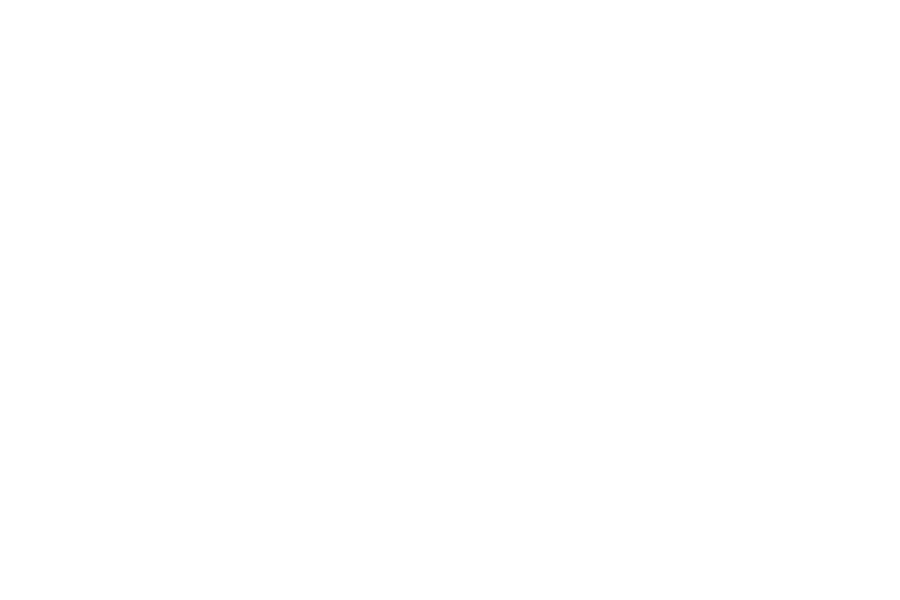

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.147947365413988
MAE(best):  0.057089528039836
MAE(best):  0.039077901226482
MAE(best):  0.019837278317839
MAE(best):  0.017826875552325


<IPython.core.display.Javascript object>


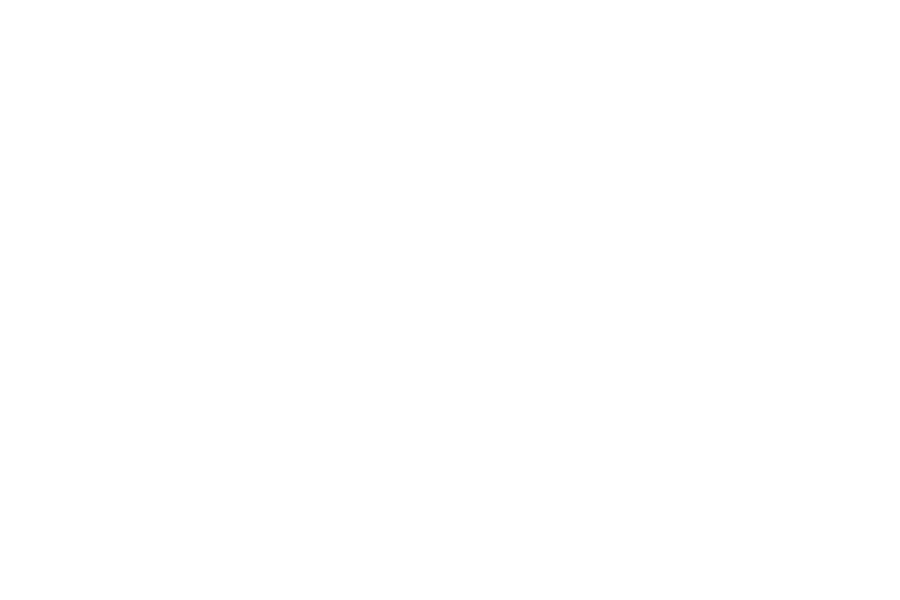

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 73


<IPython.core.display.Javascript object>

[UP_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


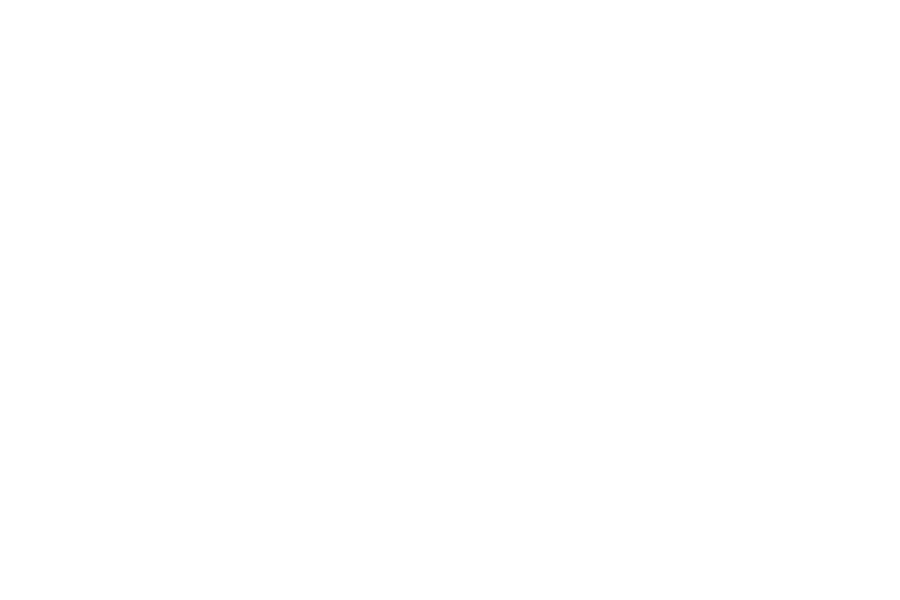

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.411948963297636
MAE(best):  0.092024704497307
MAE(best):  0.044826308961878
MAE(best):  0.038085294687718
MAE(best):  0.030359231398982


<IPython.core.display.Javascript object>


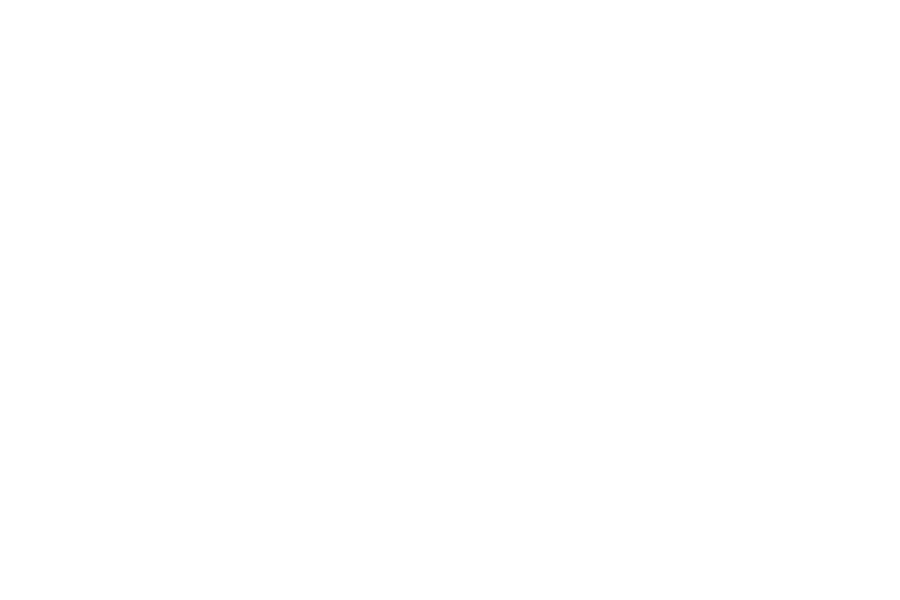

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 74


<IPython.core.display.Javascript object>

[UP_RIGHT, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


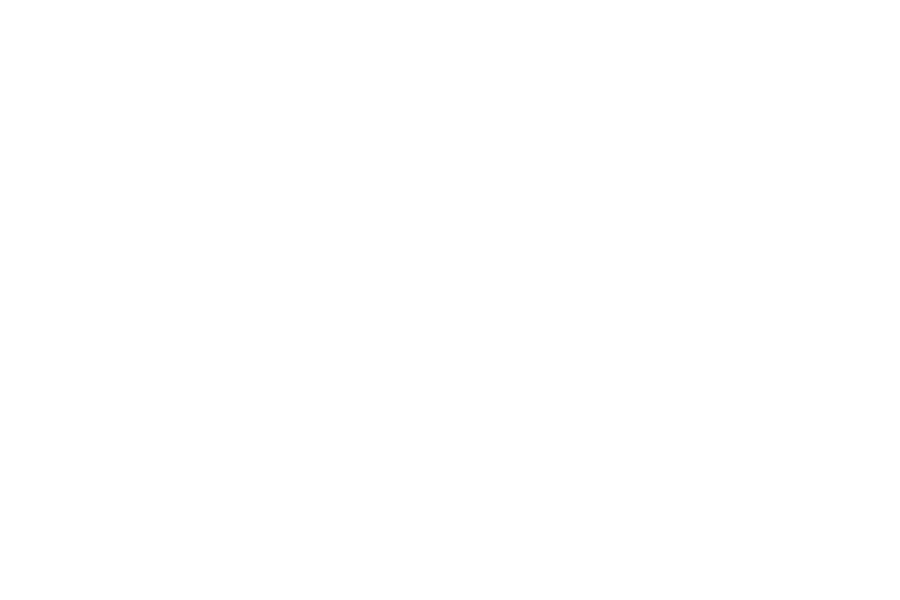

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.012670183050133


<IPython.core.display.Javascript object>


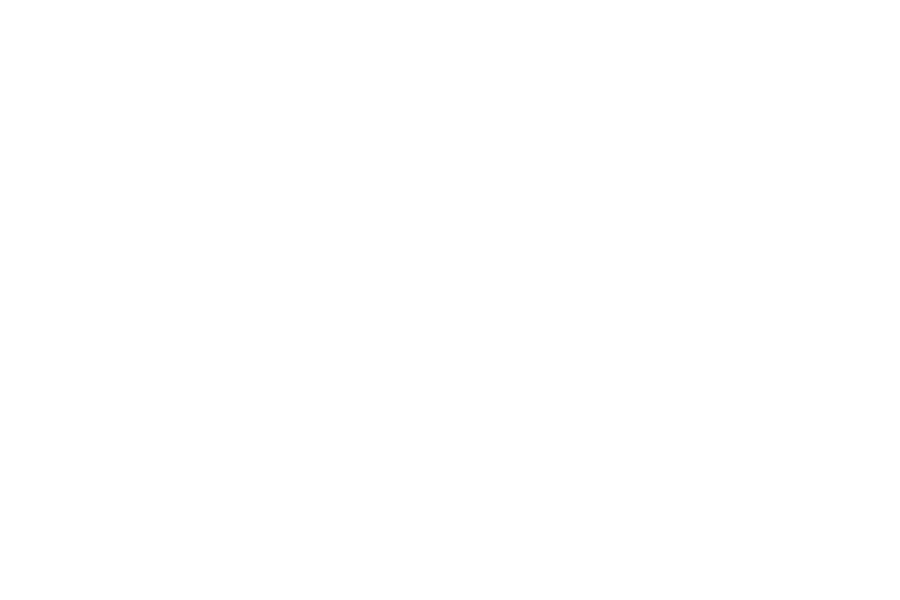

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 75


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


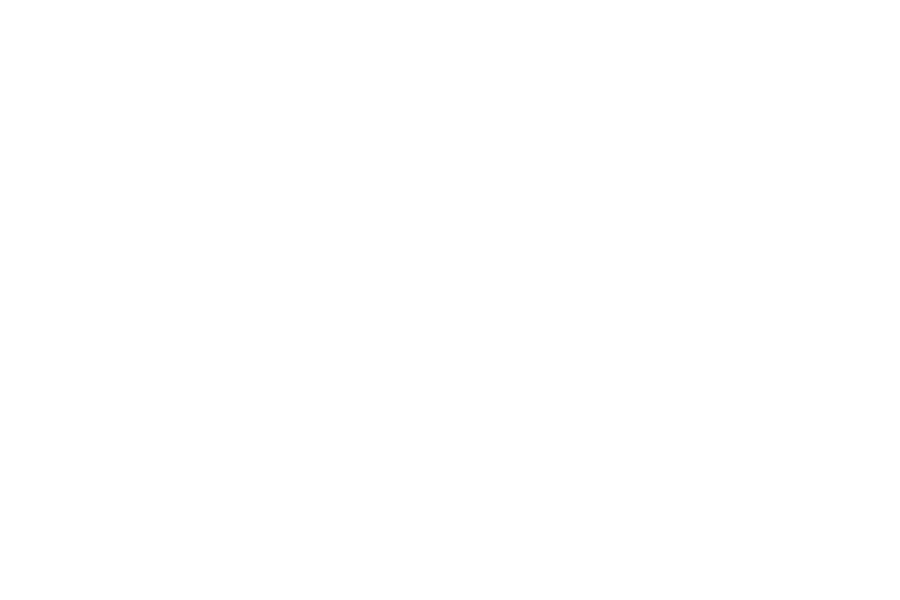

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.242564137966720
MAE(best):  0.098205758926176
MAE(best):  0.027570610702715
MAE(best):  0.027570610702715
MAE(best):  0.027570610702715


<IPython.core.display.Javascript object>


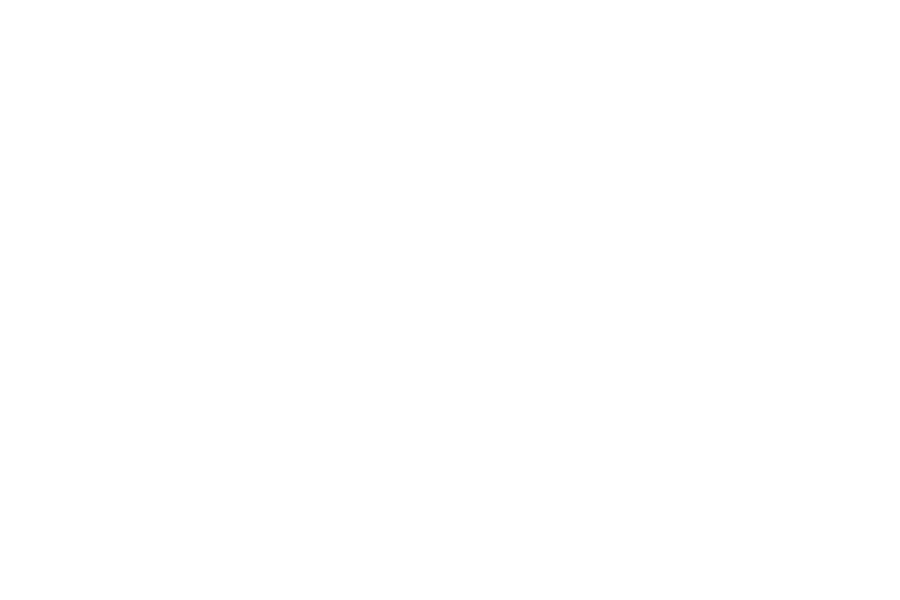

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 76


<IPython.core.display.Javascript object>

[UP_RIGHT, DOWN_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


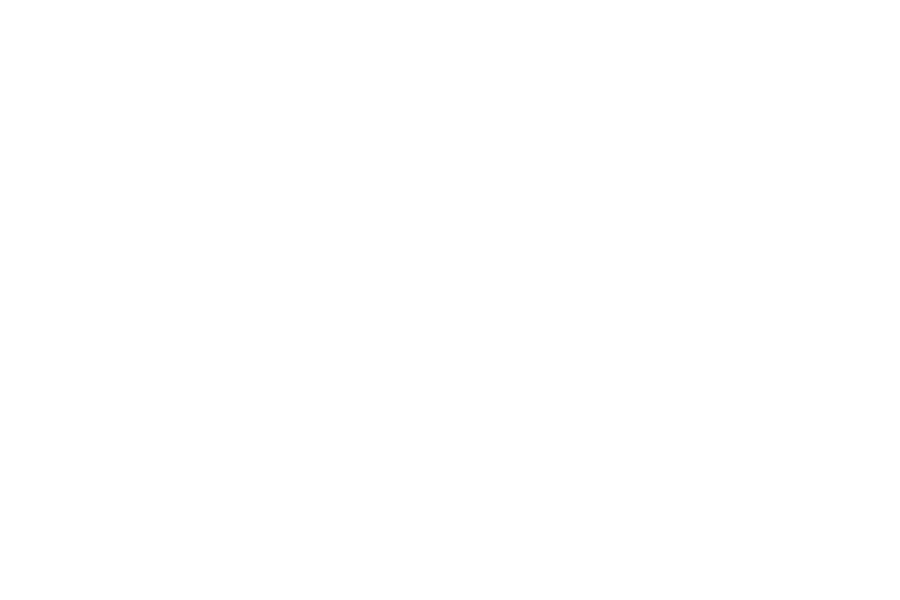

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.060422875929754
MAE(best):  0.038387580972636
MAE(best):  0.011205674154261
MAE(best):  0.010954660385753
MAE(best):  0.010672670650588


<IPython.core.display.Javascript object>


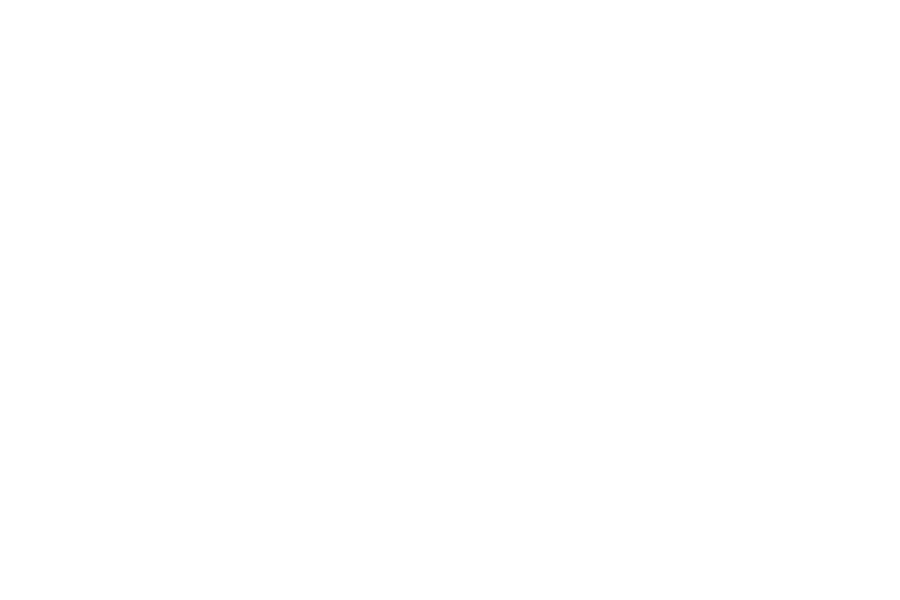

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 77


<IPython.core.display.Javascript object>

[UP, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


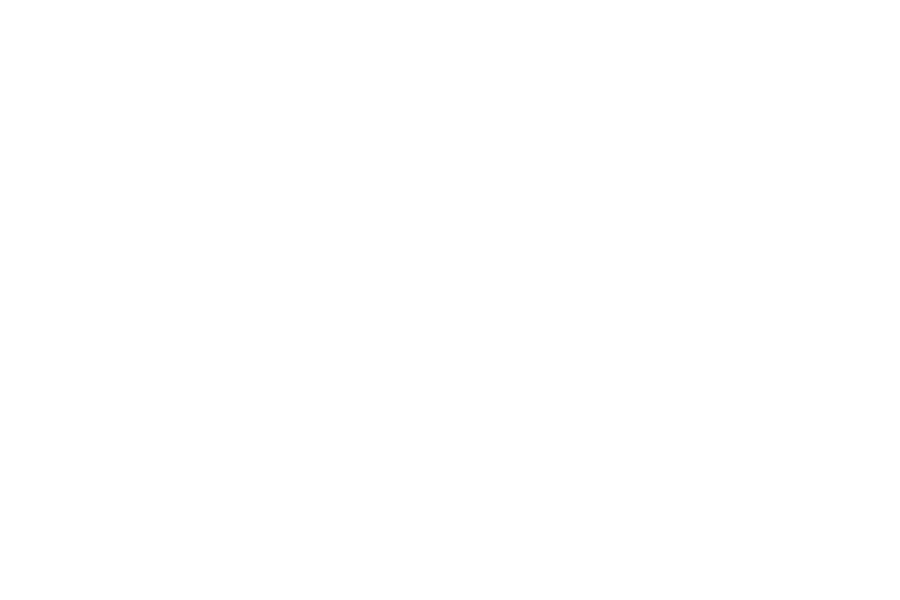

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.126538264581969
MAE(best):  0.026274963181677


<IPython.core.display.Javascript object>


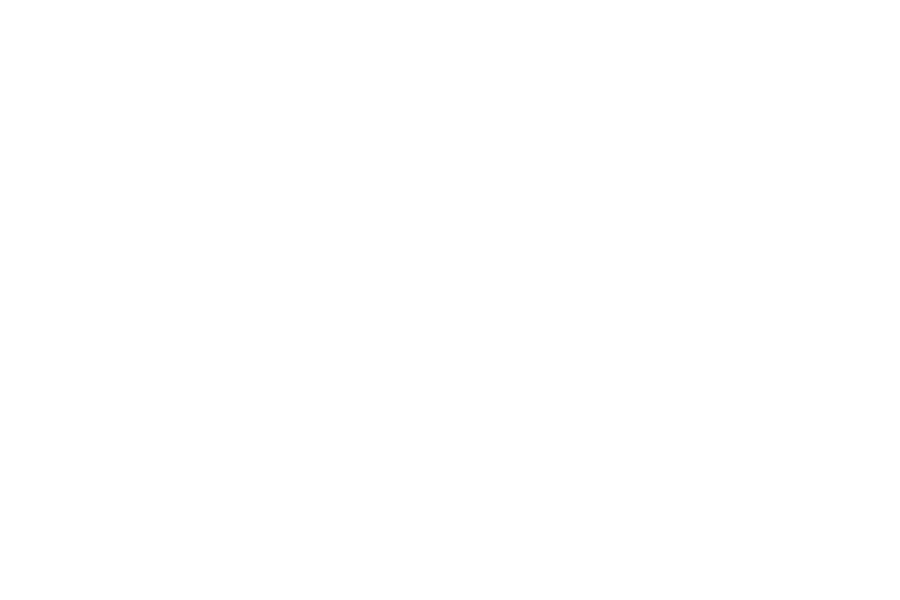

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 78


<IPython.core.display.Javascript object>

[UP_RIGHT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


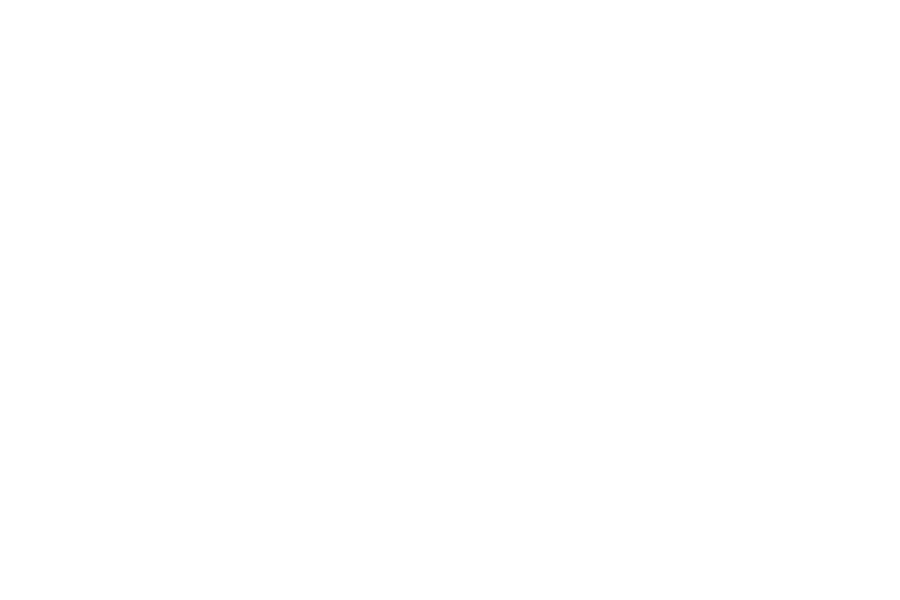

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.346511043434366
MAE(best):  0.113372790982907
MAE(best):  0.078026191560100
MAE(best):  0.065785990390103
MAE(best):  0.062092025691822


<IPython.core.display.Javascript object>


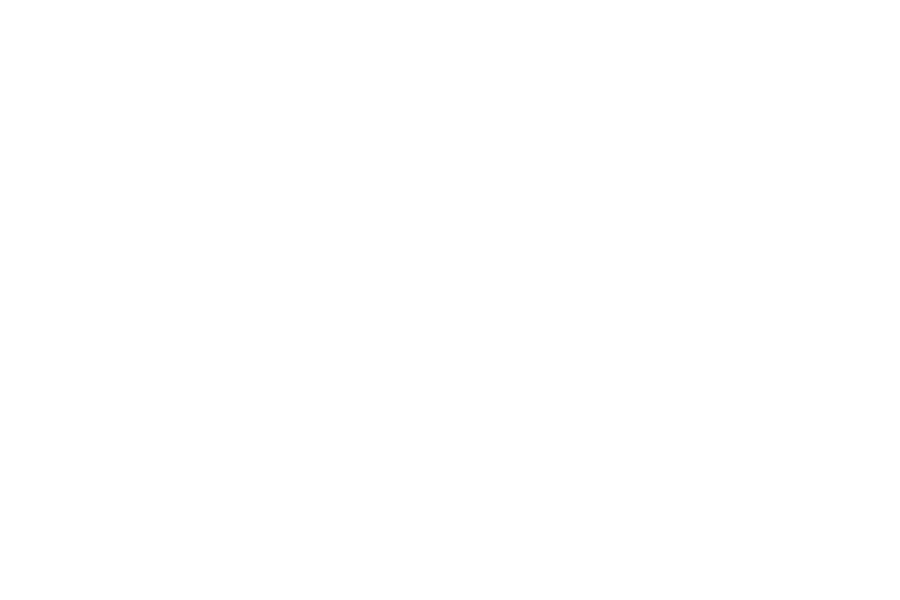

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 79


<IPython.core.display.Javascript object>

[RIGHT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


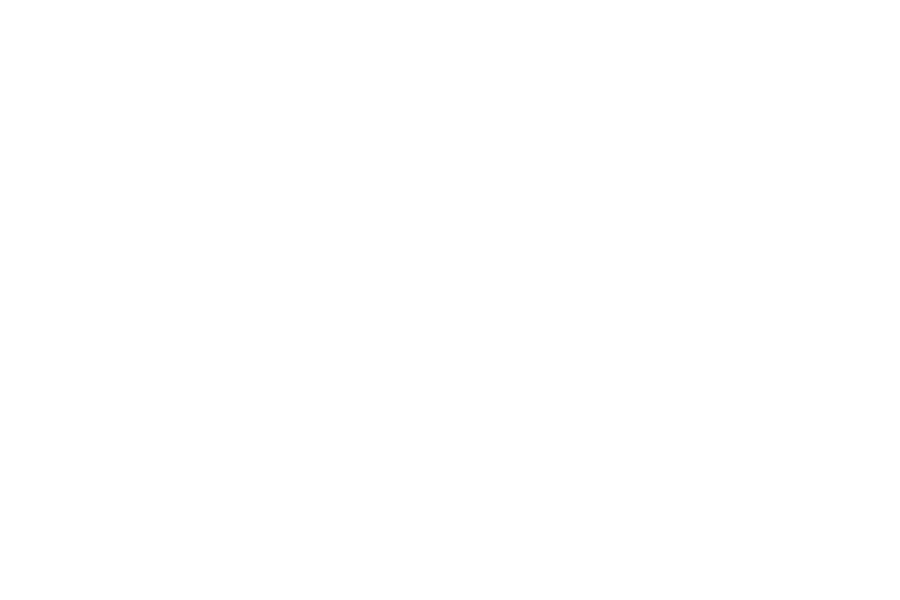

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.048323968297881
MAE(best):  0.026599233407233
MAE(best):  0.025297687920020
MAE(best):  0.016831053518809


<IPython.core.display.Javascript object>


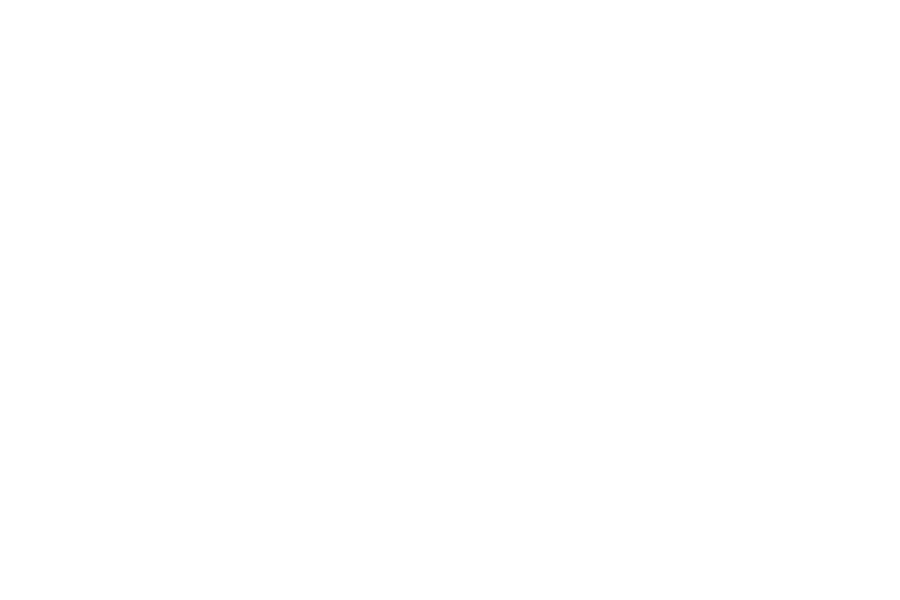

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 80


<IPython.core.display.Javascript object>

[UP_LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


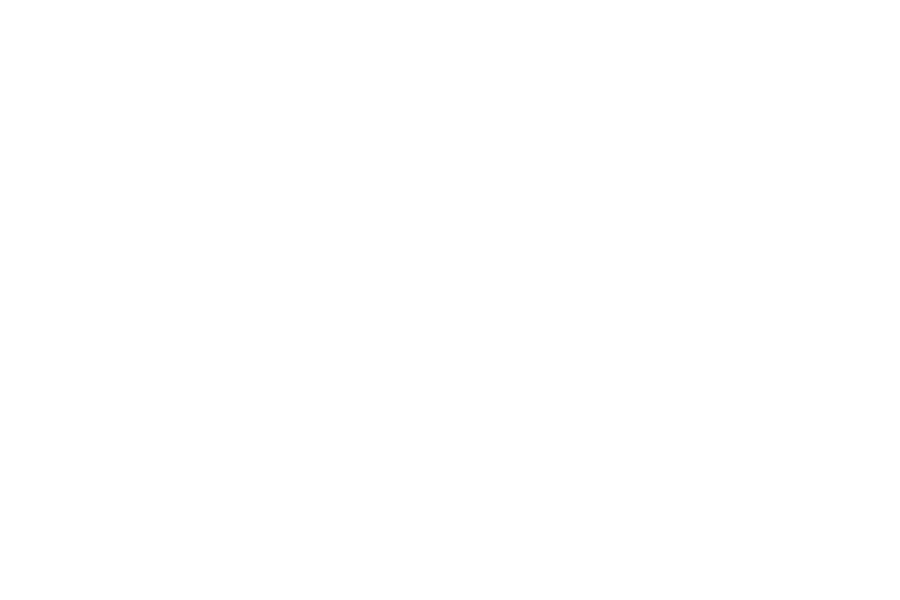

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.318714717724168
MAE(best):  0.265779118097307
MAE(best):  0.246690818414524
MAE(best):  0.136269815582364
MAE(best):  0.132805557961765


<IPython.core.display.Javascript object>


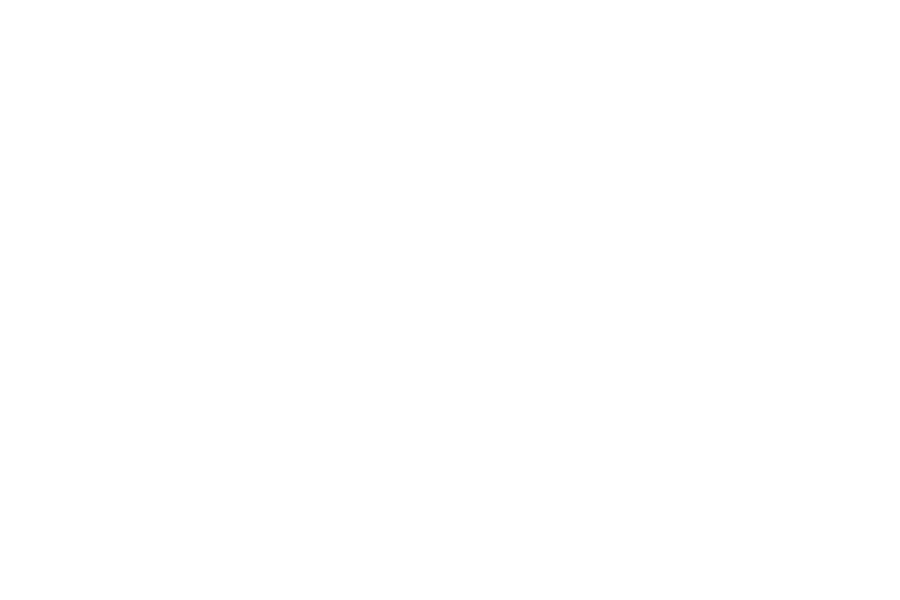

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 81


<IPython.core.display.Javascript object>

[DOWN, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


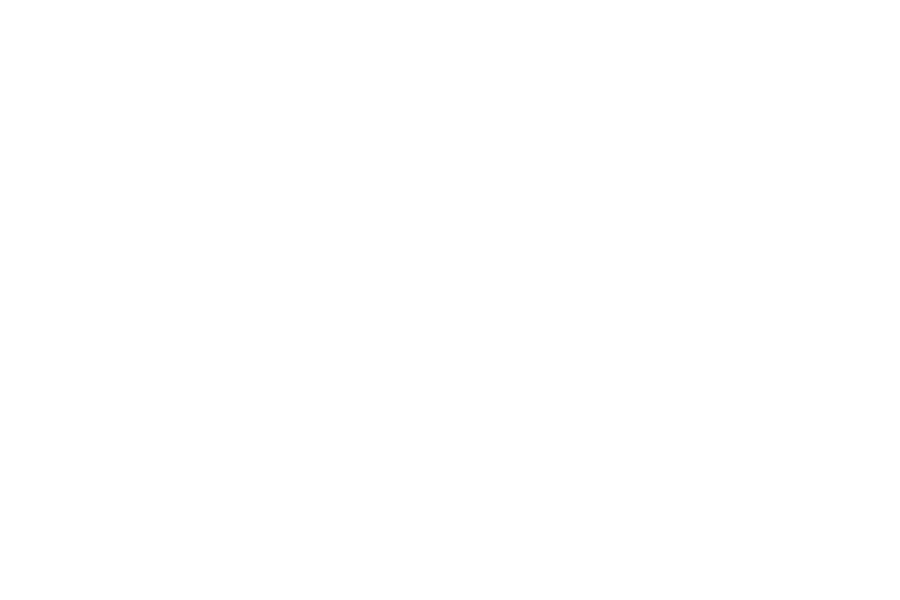

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.066950939230671
MAE(best):  0.059178868988118
MAE(best):  0.022679447961909
MAE(best):  0.014038439344060


<IPython.core.display.Javascript object>


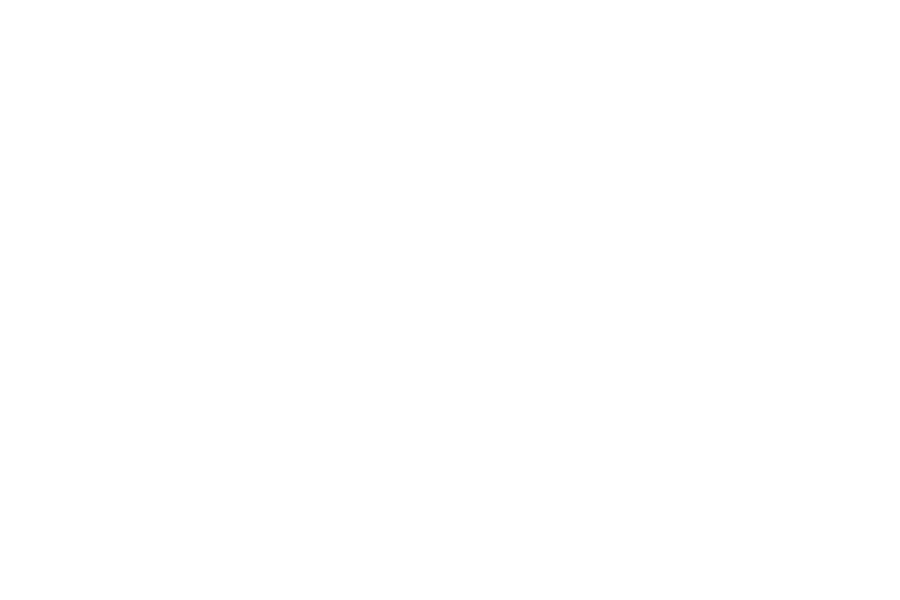

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 82


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


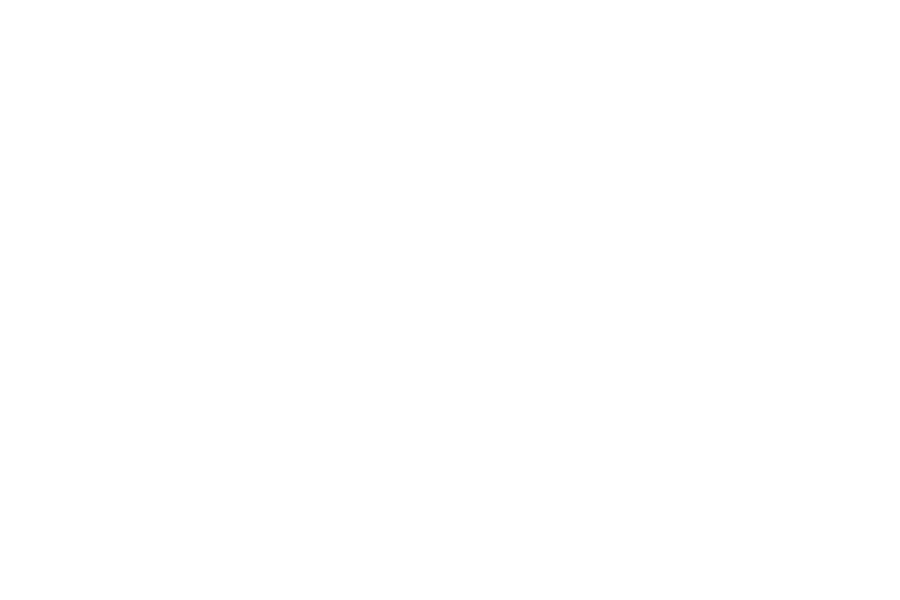

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.012529153815361


<IPython.core.display.Javascript object>


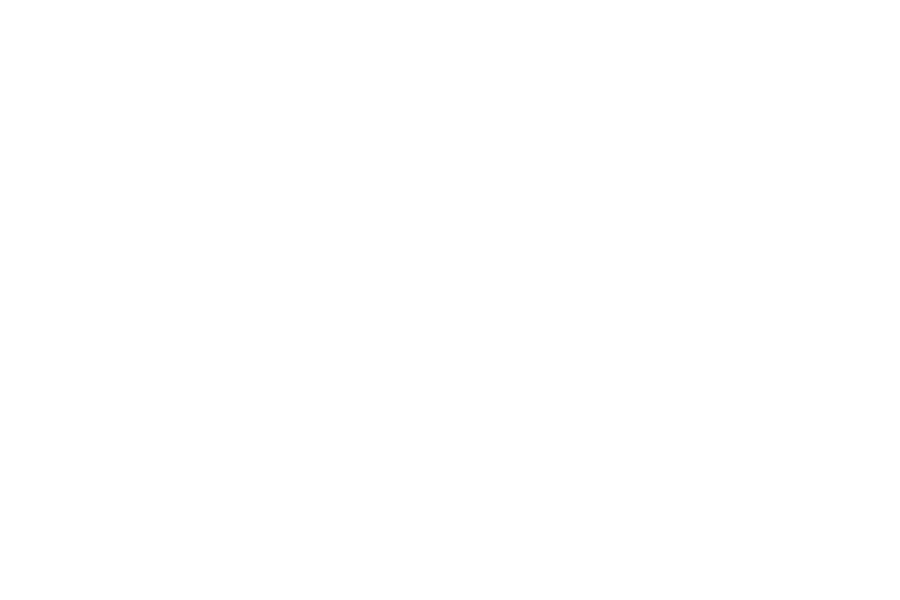

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 83


<IPython.core.display.Javascript object>

[DOWN, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


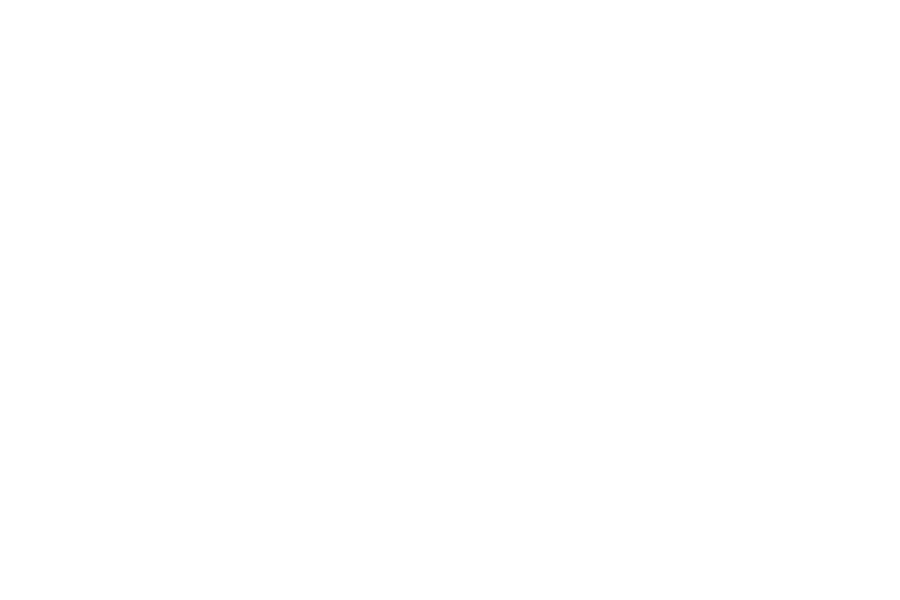

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.032385128795101
MAE(best):  0.029364005032508
MAE(best):  0.013610122789580
MAE(best):  0.013075499625775
MAE(best):  0.011126006330743


<IPython.core.display.Javascript object>


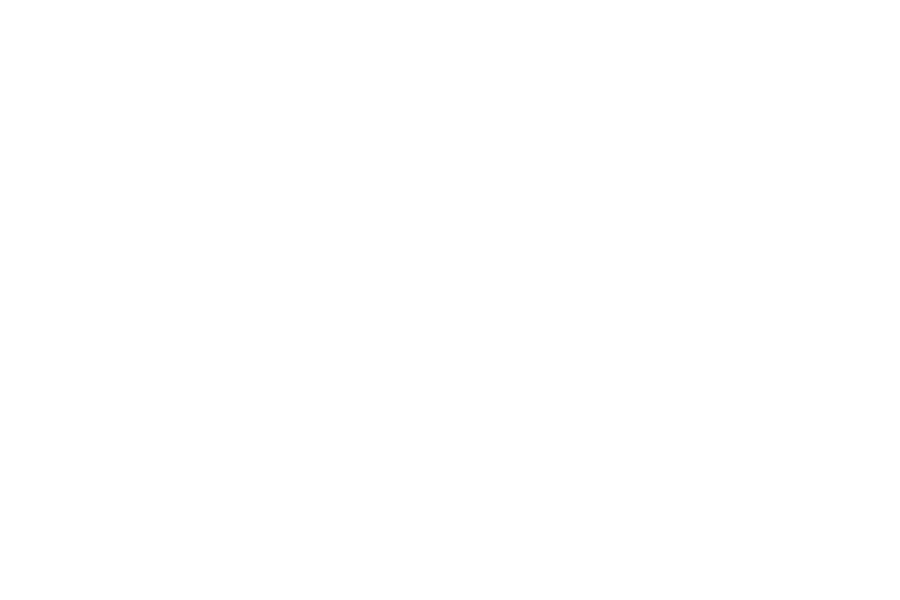

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 84


<IPython.core.display.Javascript object>

[DOWN_LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


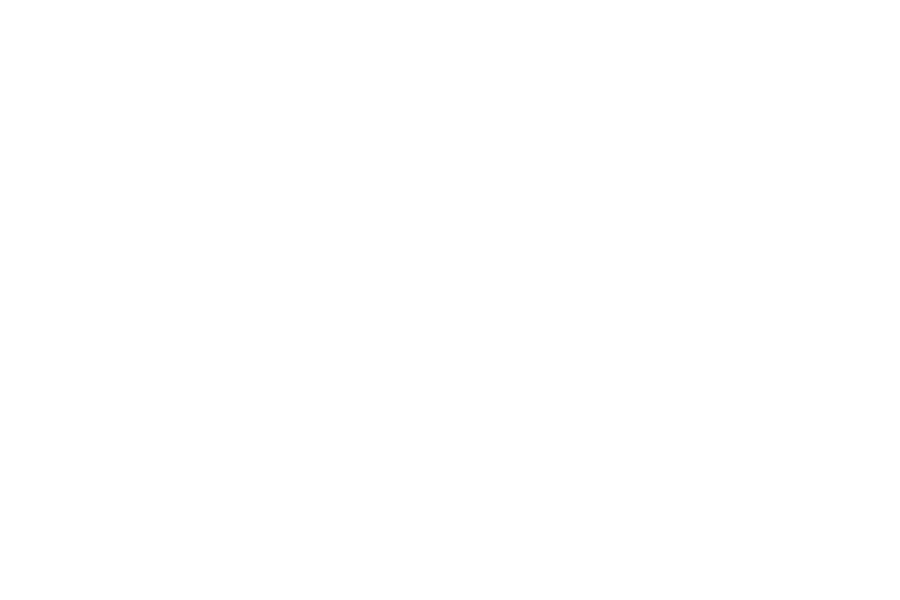

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.282754372615678
MAE(best):  0.048529243751384
MAE(best):  0.025962196527393
MAE(best):  0.017433315143704
MAE(best):  0.016328369704582


<IPython.core.display.Javascript object>


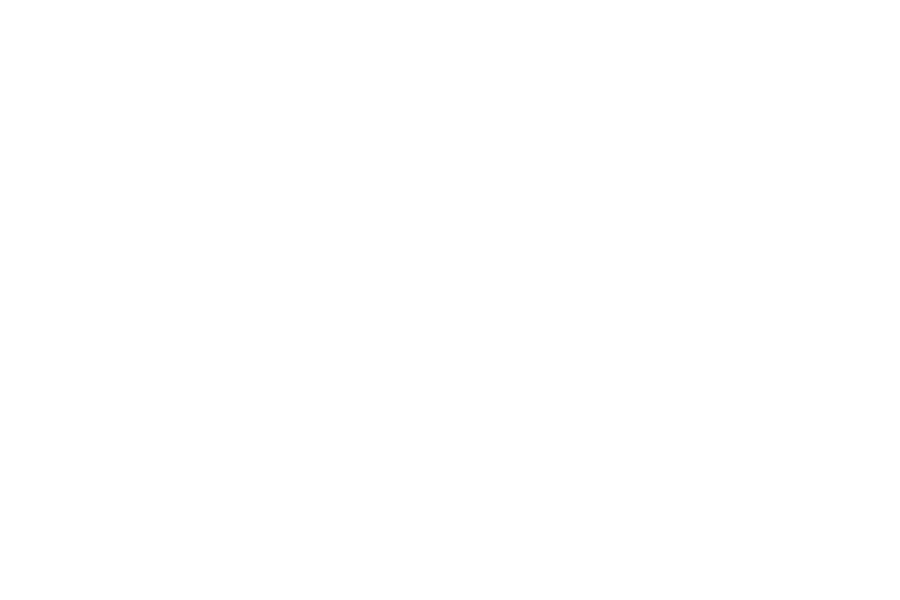

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 85


<IPython.core.display.Javascript object>

[RIGHT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


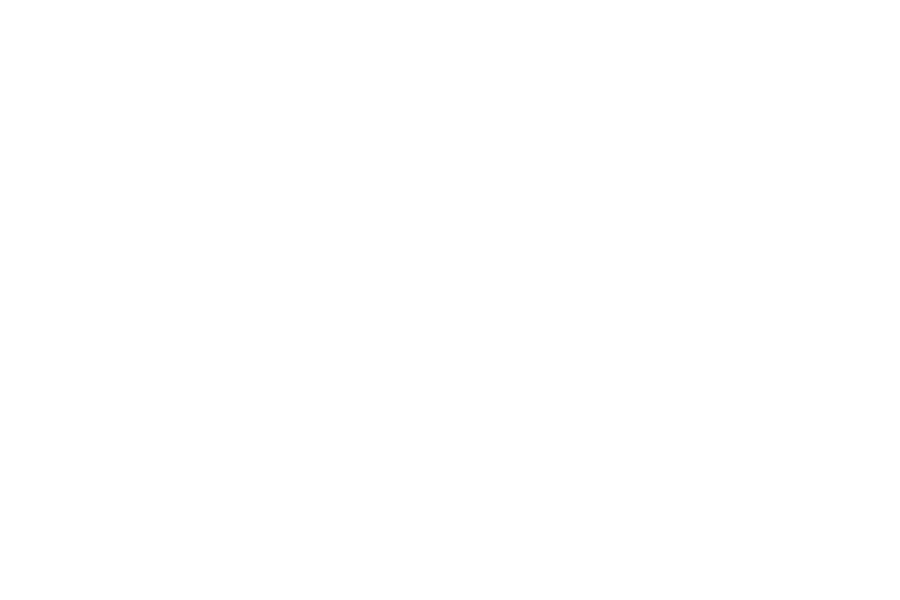

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.432098134356609
MAE(best):  0.277650972721196
MAE(best):  0.202760016851157
MAE(best):  0.121321958538618
MAE(best):  0.108748946073913


<IPython.core.display.Javascript object>


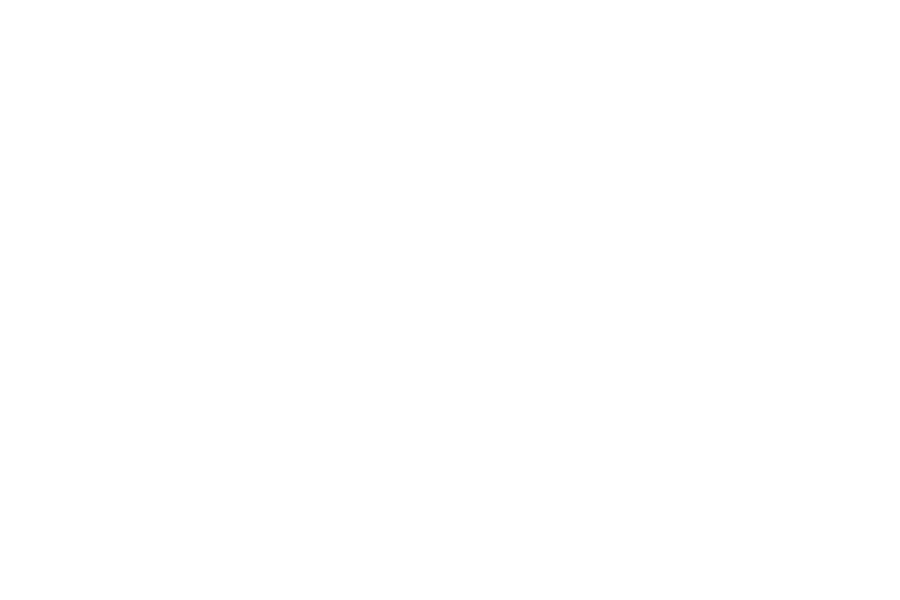

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 86


<IPython.core.display.Javascript object>

[DOWN_LEFT, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


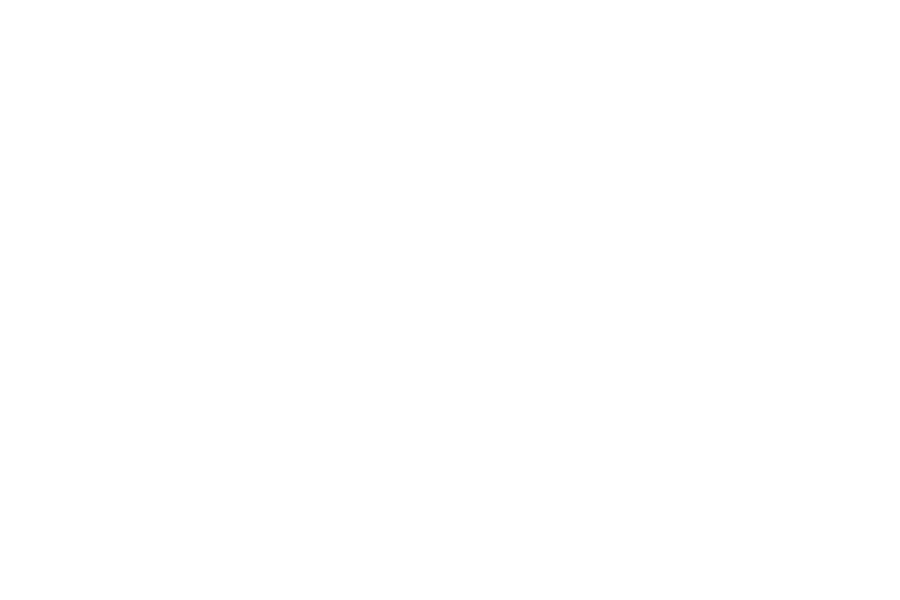

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.054758187703185
MAE(best):  0.019357671407551


<IPython.core.display.Javascript object>


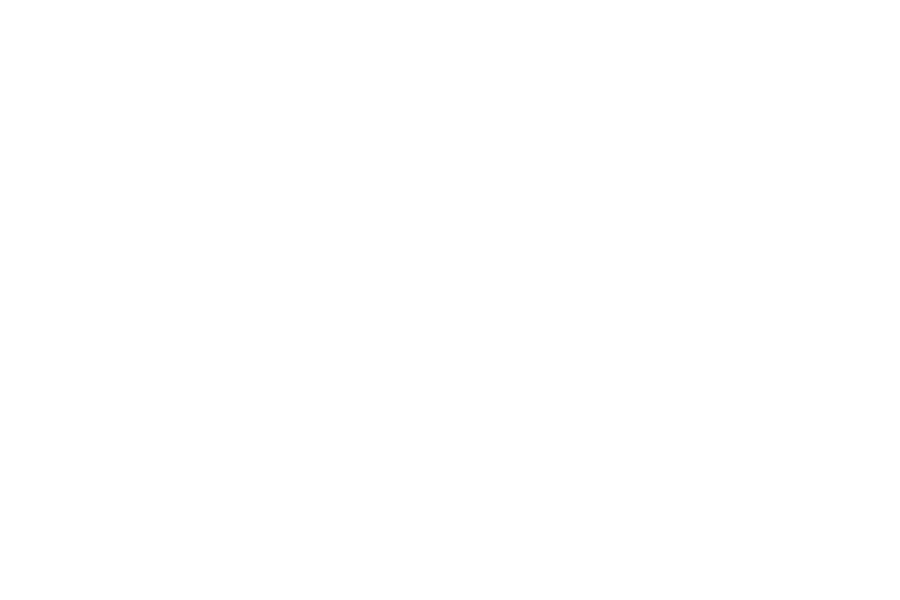

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 87


<IPython.core.display.Javascript object>

[LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


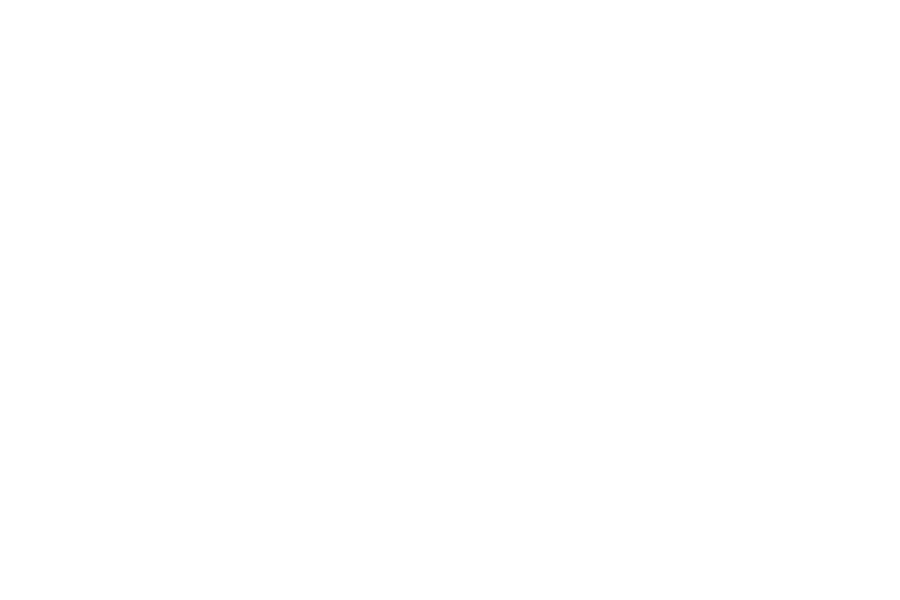

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.042492925073861
MAE(best):  0.039364476557010


<IPython.core.display.Javascript object>


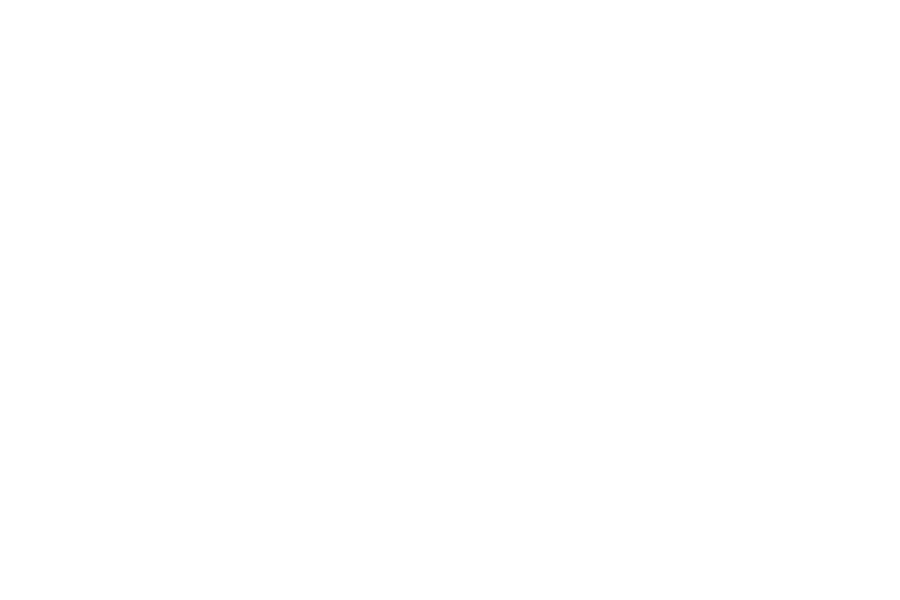

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 88


<IPython.core.display.Javascript object>

[DOWN, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


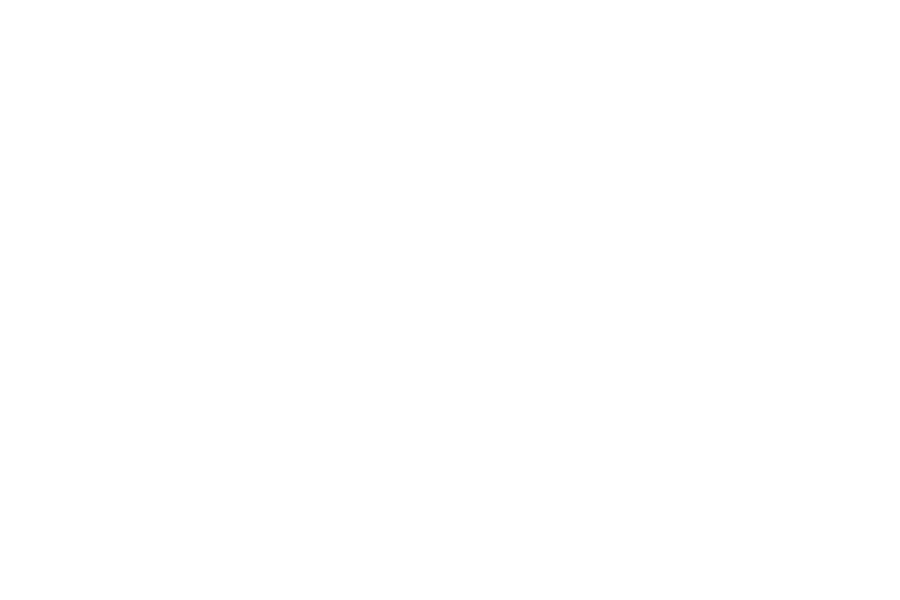

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.250349564034817
MAE(best):  0.110630059100393
MAE(best):  0.016726551104828
MAE(best):  0.014684043702861
MAE(best):  0.014192887115536


<IPython.core.display.Javascript object>


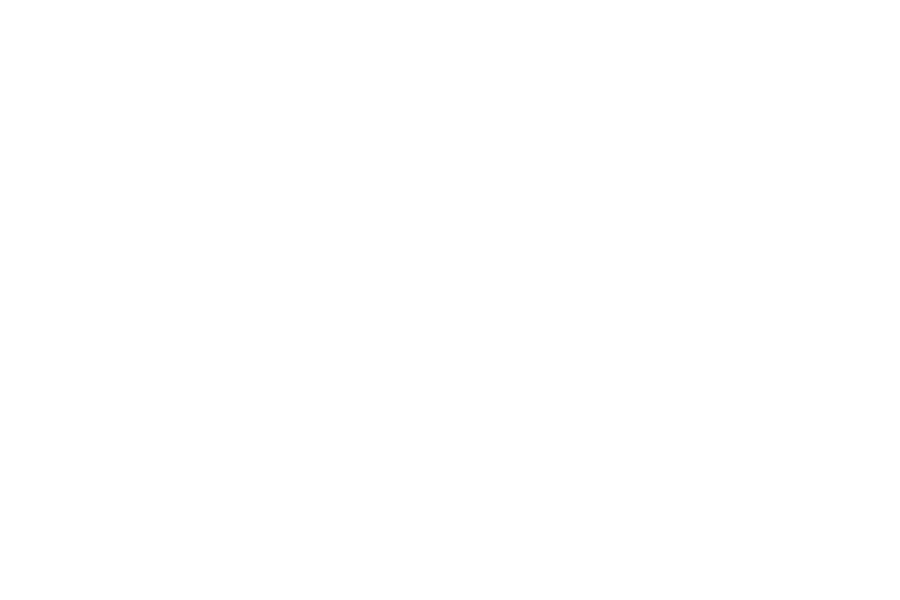

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 89


<IPython.core.display.Javascript object>

[UP, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


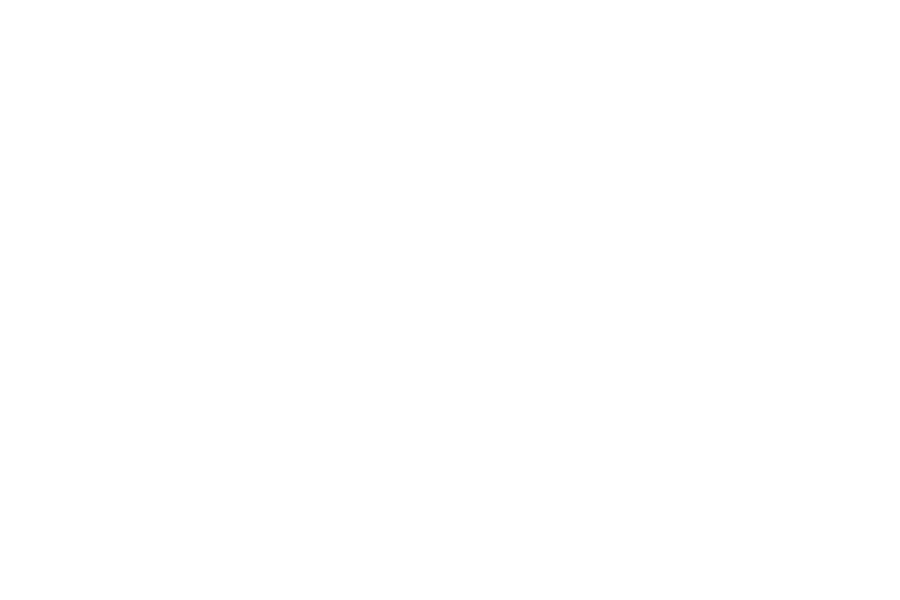

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.097364581401623
MAE(best):  0.023385158888200
MAE(best):  0.023237826550803
MAE(best):  0.022388901456155
MAE(best):  0.014739437827155


<IPython.core.display.Javascript object>


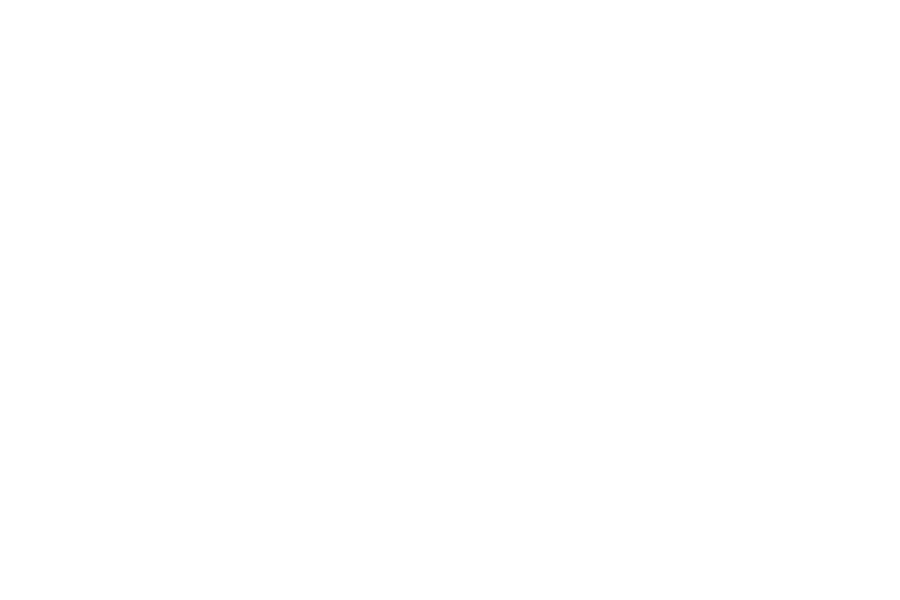

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 90


<IPython.core.display.Javascript object>

[LEFT, DOWN_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


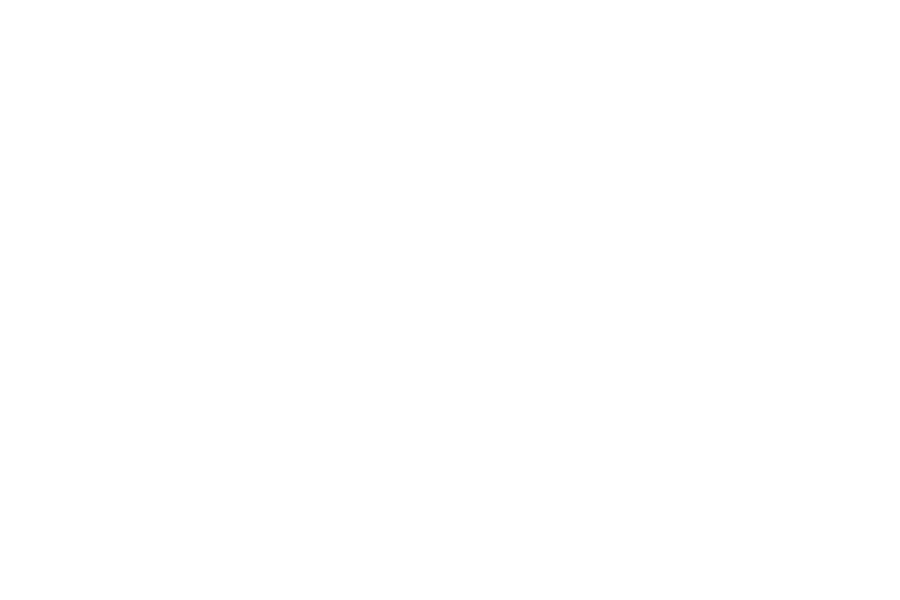

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.143465230529580
MAE(best):  0.093344799179280
MAE(best):  0.017096632307499


<IPython.core.display.Javascript object>


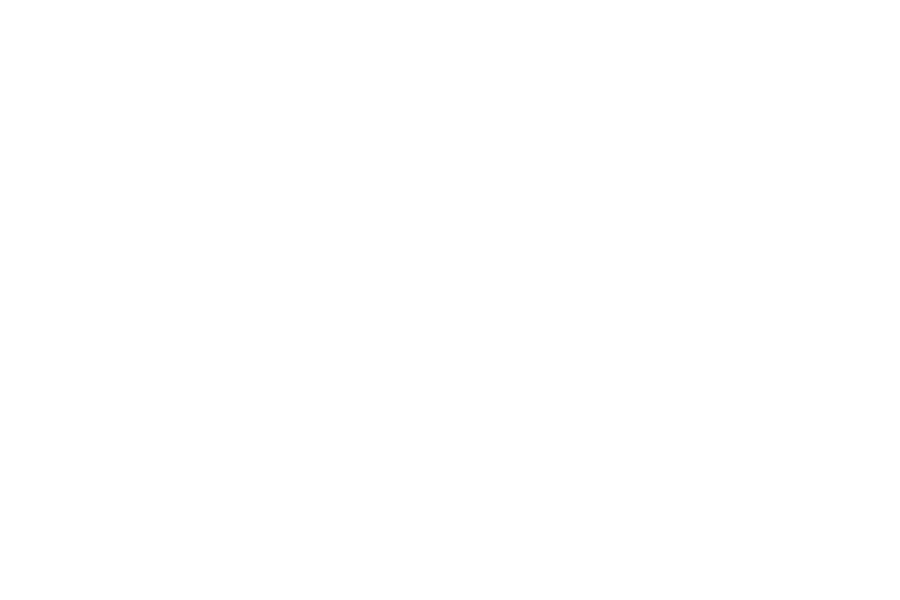

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 91


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


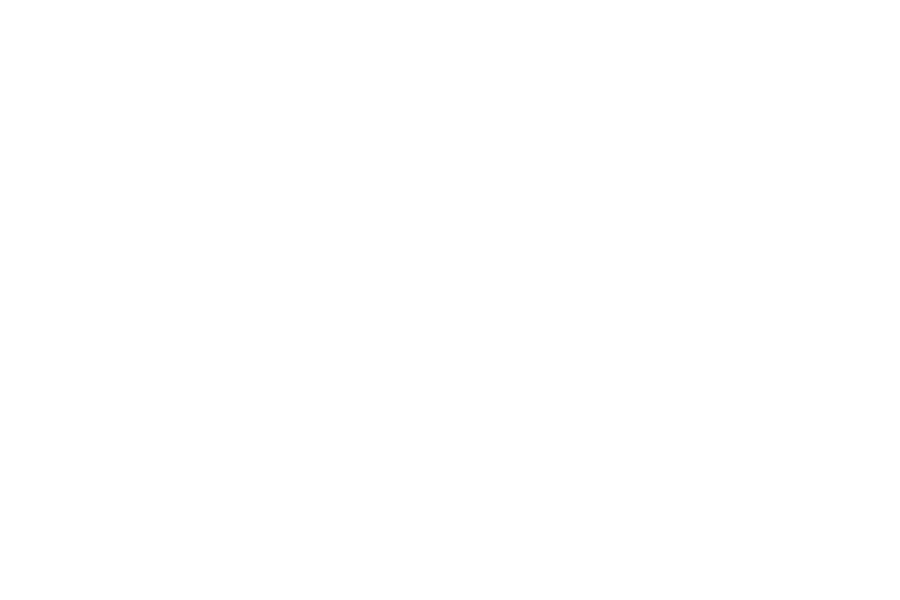

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.020108186536657
MAE(best):  0.020062690697120


<IPython.core.display.Javascript object>


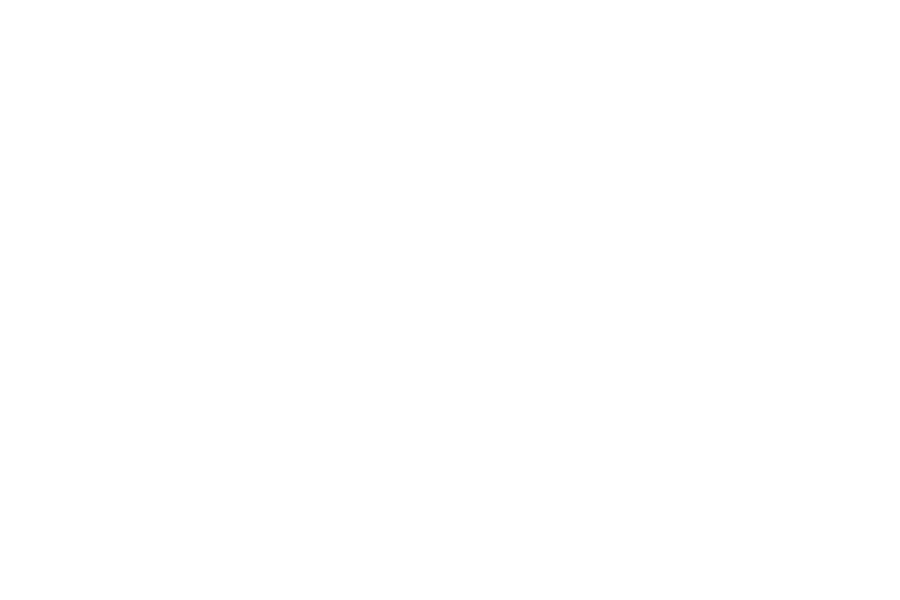

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 92


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


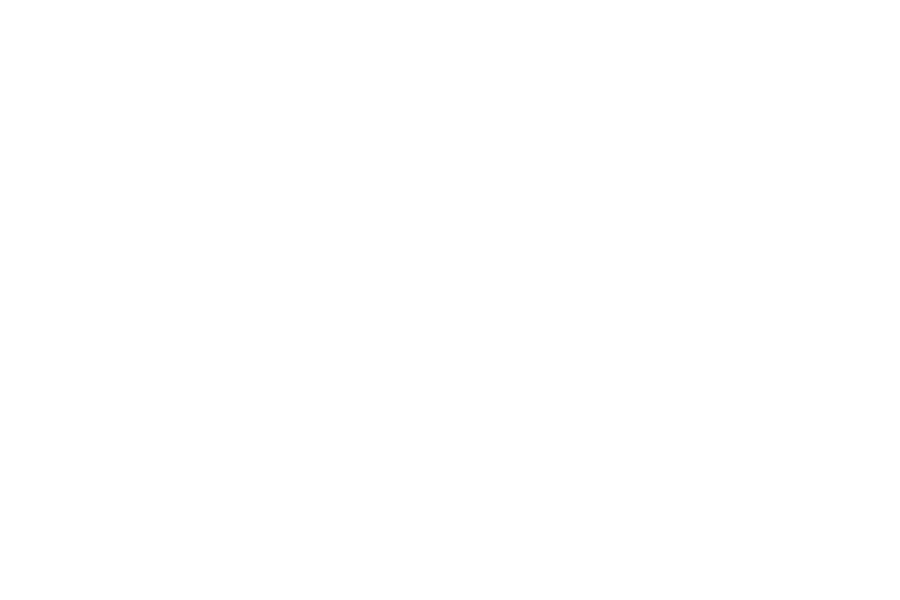

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.051703668862071
MAE(best):  0.039392228678649
MAE(best):  0.014228883543454
MAE(best):  0.012049366146807
MAE(best):  0.011471598247995


<IPython.core.display.Javascript object>


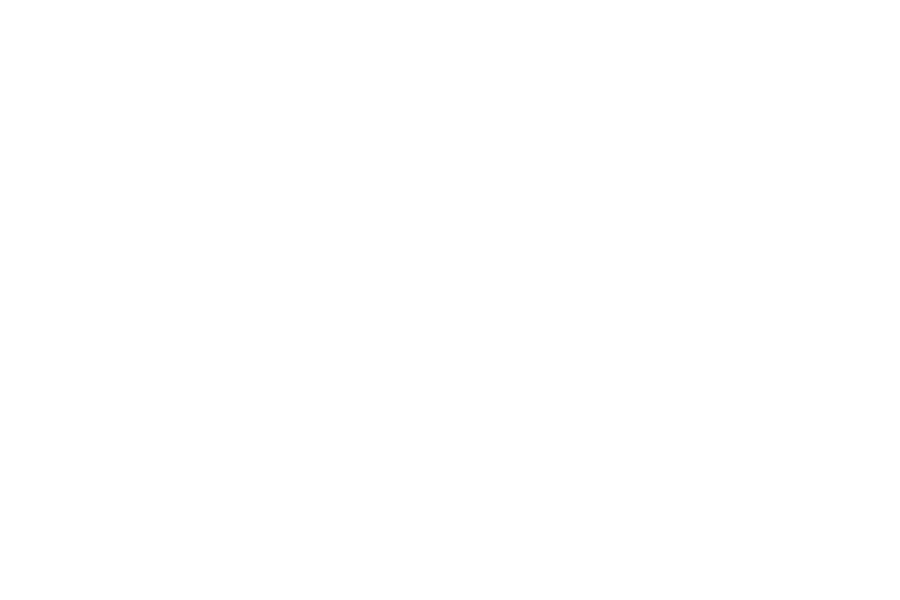

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 93


<IPython.core.display.Javascript object>

[DOWN_RIGHT, DOWN]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


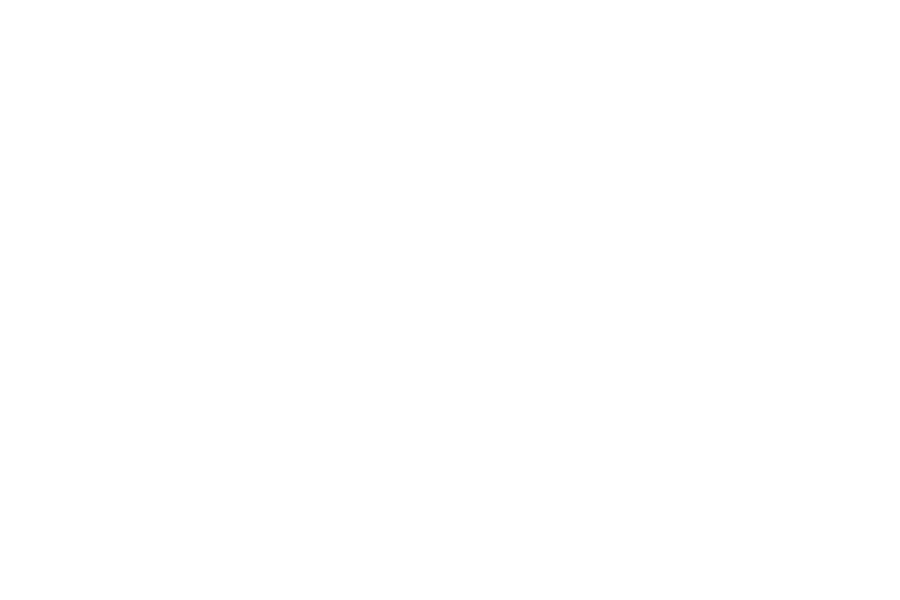

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  6.650098408645202


<IPython.core.display.Javascript object>


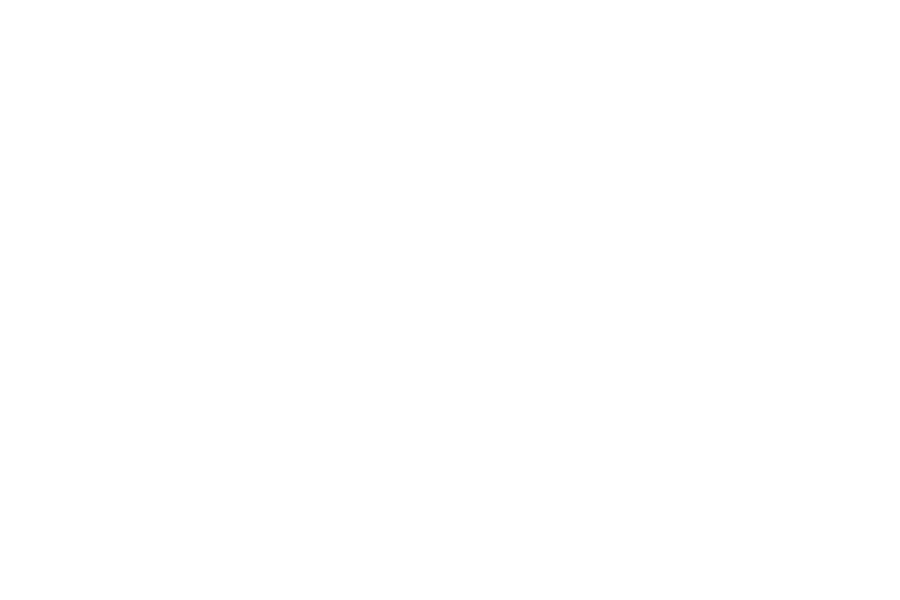

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 94


<IPython.core.display.Javascript object>

[DOWN_RIGHT, UP]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


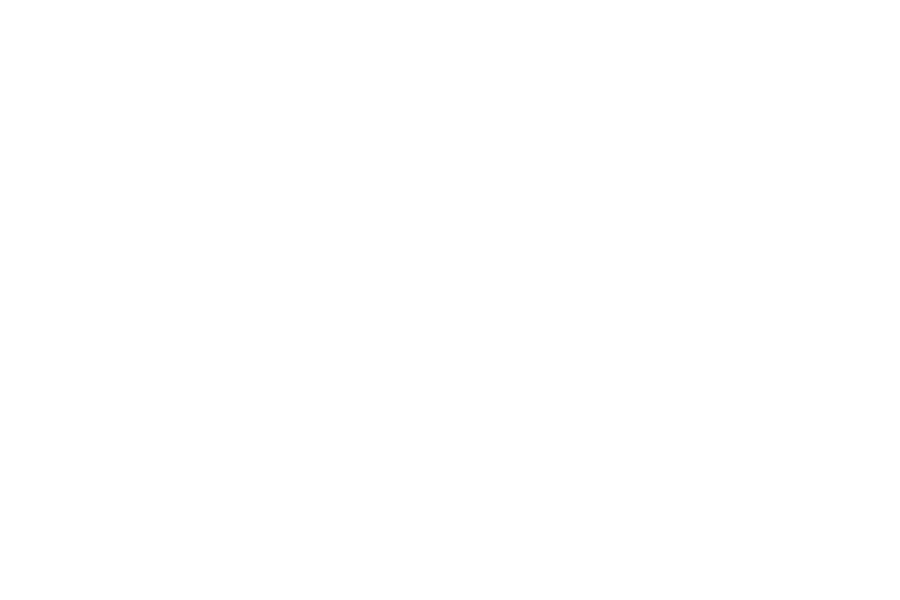

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.124749195553357
MAE(best):  0.034272167101005
MAE(best):  0.025800758092765
MAE(best):  0.012631958673657
MAE(best):  0.011346503528978


<IPython.core.display.Javascript object>


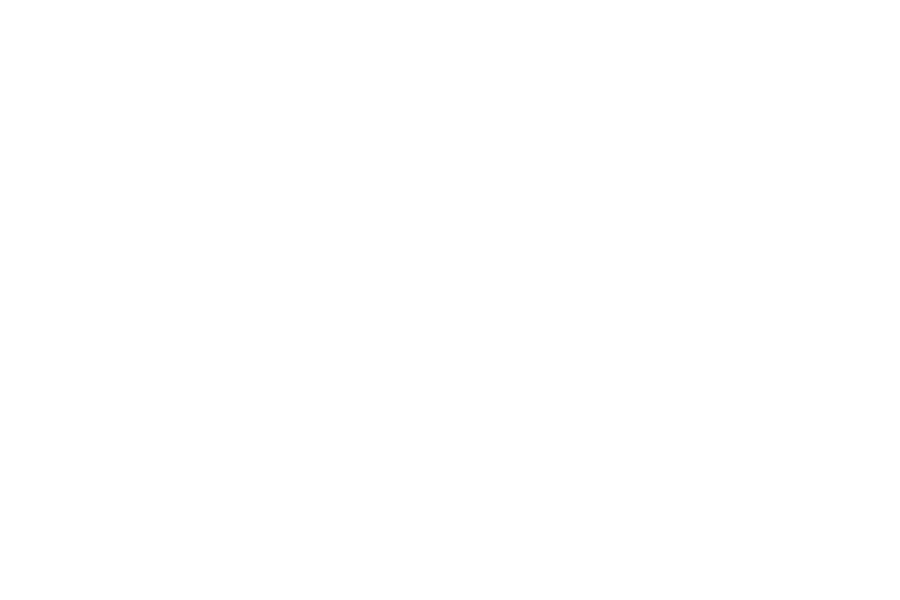

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 95


<IPython.core.display.Javascript object>

[DOWN, LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


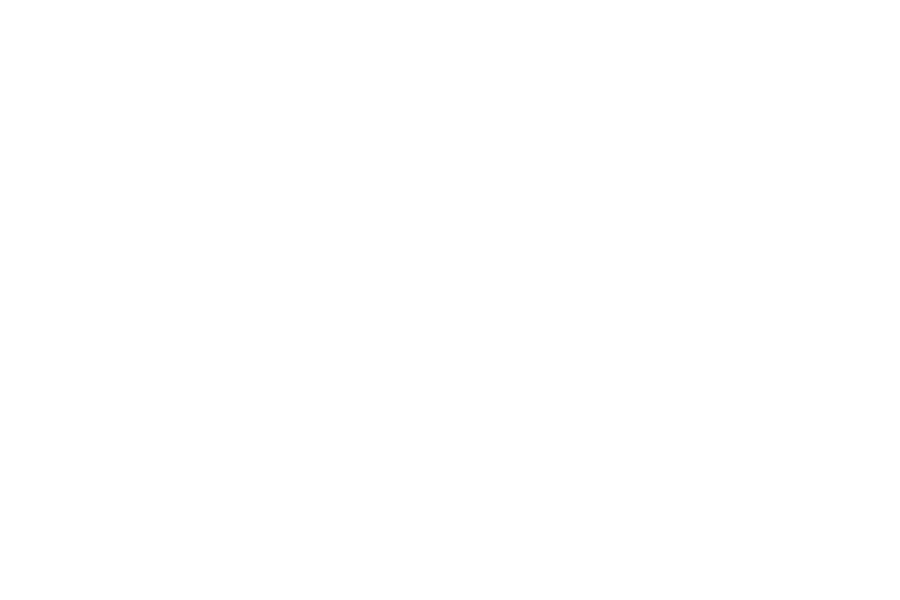

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.010528302615809


<IPython.core.display.Javascript object>


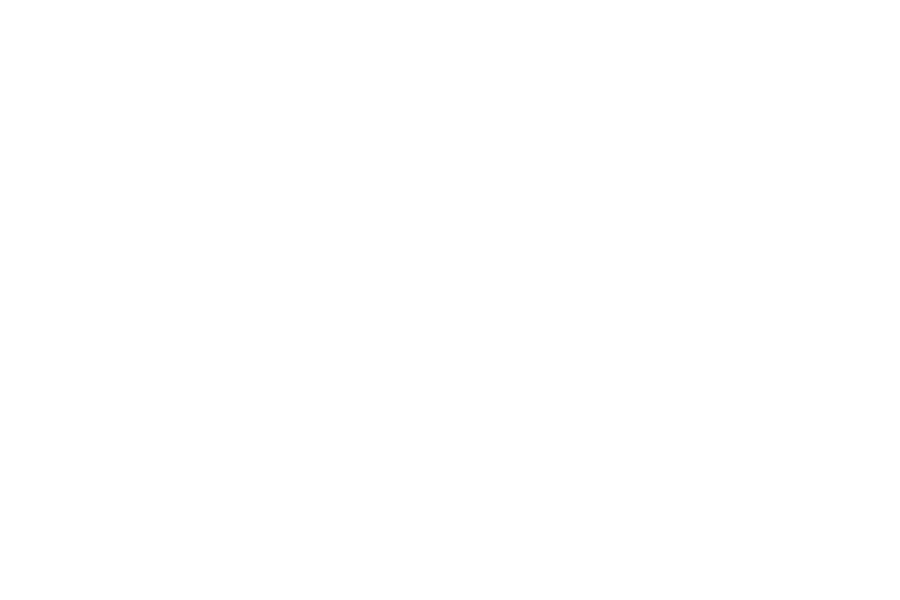

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 96


<IPython.core.display.Javascript object>

[LEFT, RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


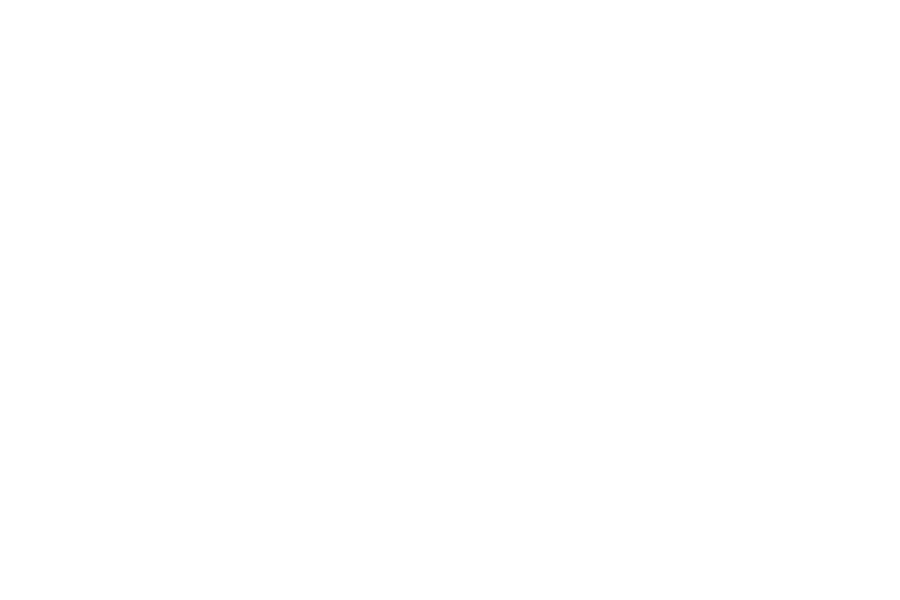

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.229541397746923
MAE(best):  0.072459579348536
MAE(best):  0.039032474519016
MAE(best):  0.022269861939851
MAE(best):  0.019806063568807


<IPython.core.display.Javascript object>


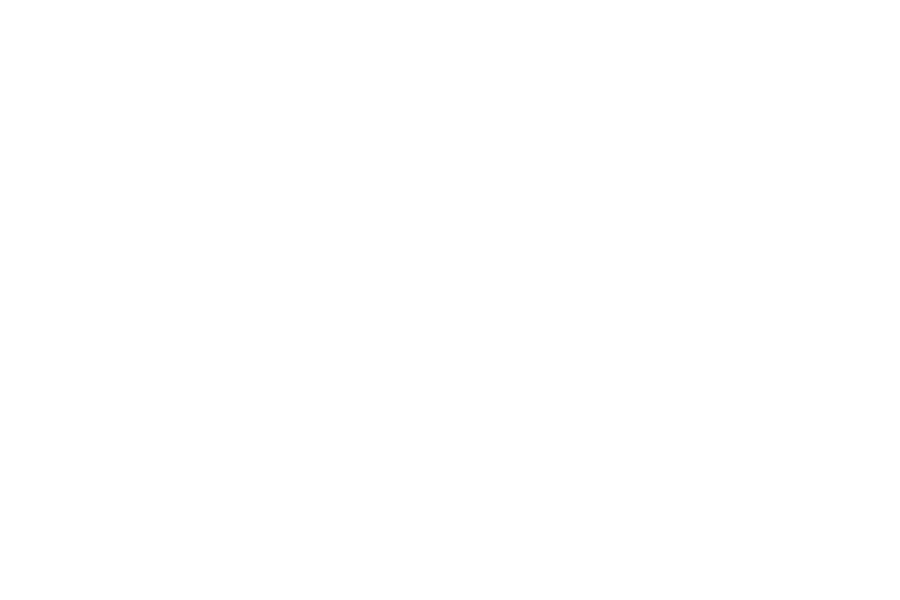

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 97


<IPython.core.display.Javascript object>

[UP, UP_RIGHT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


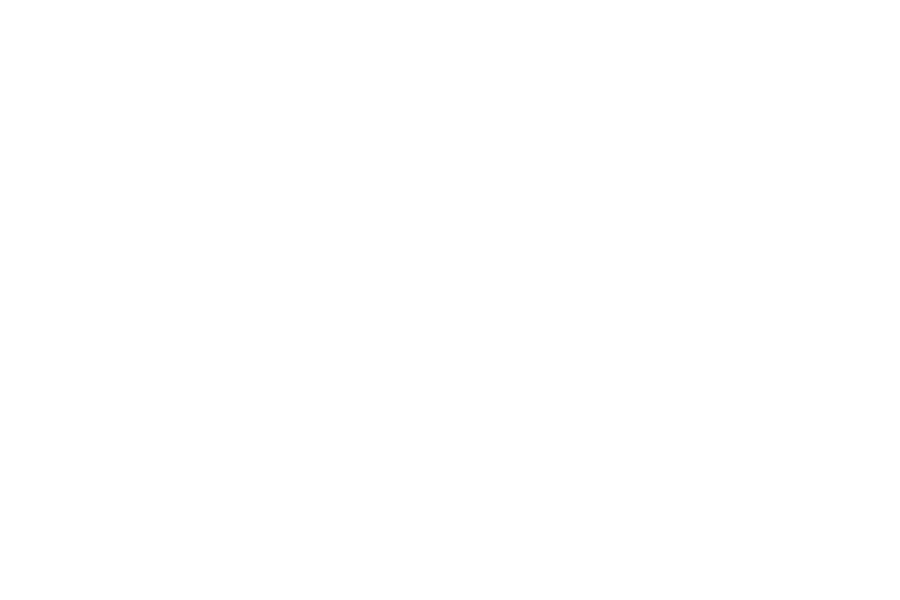

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.093543244822007
MAE(best):  0.075185519446908
MAE(best):  0.032854838490317
MAE(best):  0.016989848591913
MAE(best):  0.014337417034736


<IPython.core.display.Javascript object>


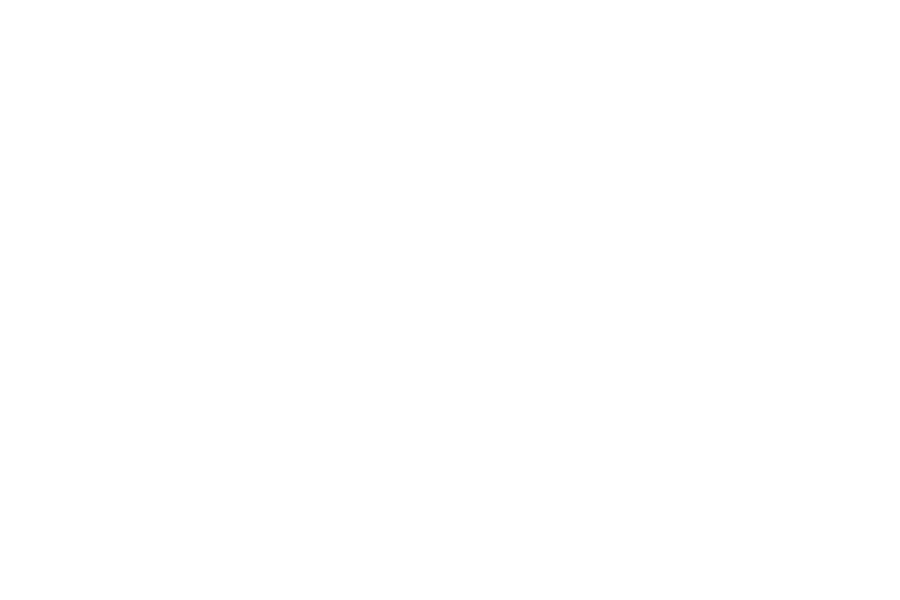

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 98


<IPython.core.display.Javascript object>

[DOWN_LEFT, UP_LEFT]
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>


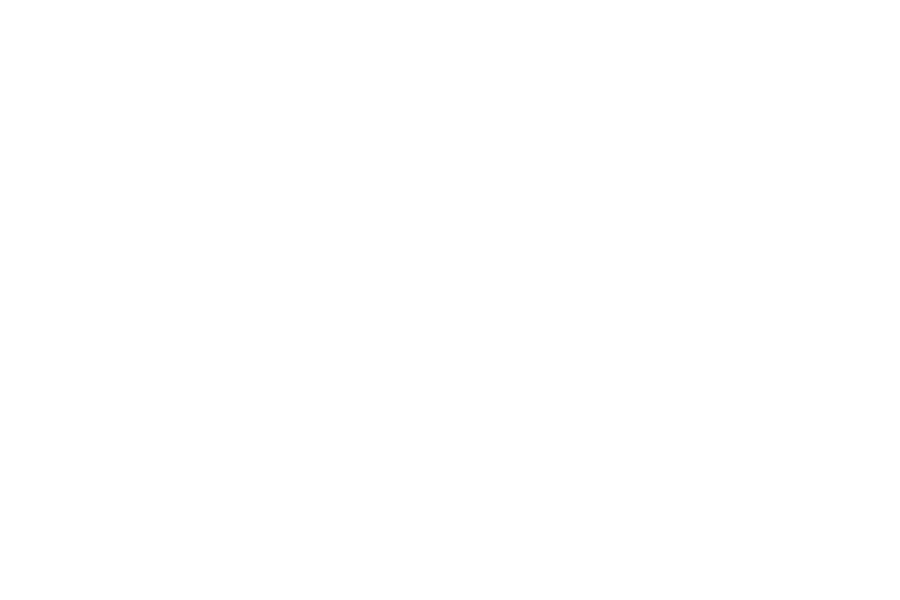

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
MAE(best):  0.138715371071016
MAE(best):  0.046913345190405
MAE(best):  0.032092361481678


<IPython.core.display.Javascript object>


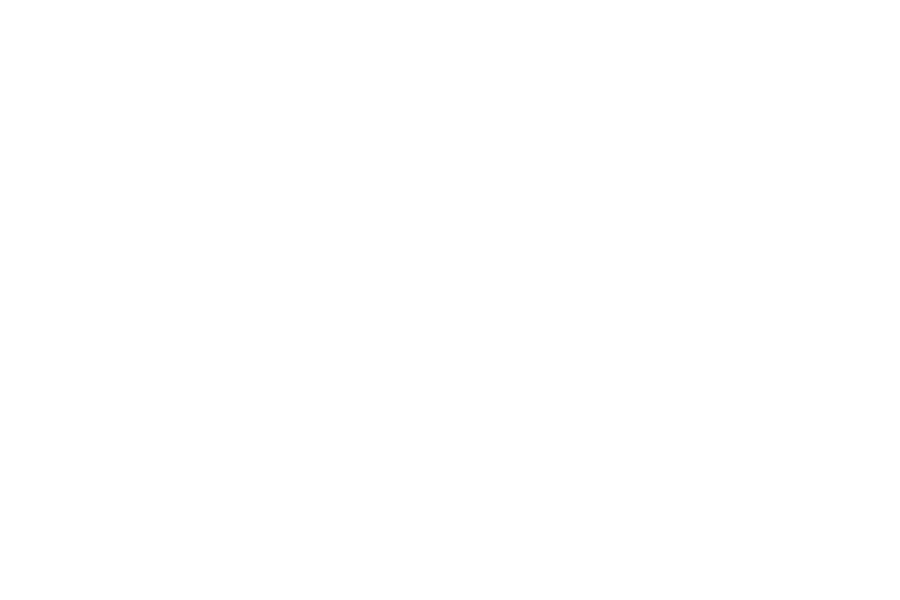

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
number of world: 99


In [7]:
n_tests = 100
fig = plt.figure(figsize=(9, 5 * n_tests))
axis = fig.subplots(n_tests, 3)
show = True

worlds =[]
nominal_matrix=[]
constrained_matrix=[]
learnt_matrix=[]

# GENERATE 9 NOMINAL WORLDS
for i in range(n_tests):
    fig = plt.figure(figsize=(15, 5 * 1))
    axis = fig.subplots(1, 3)
    blue, green, cs, ca, start, goal = generate_constraints(9)
    print(ca)

    plt.ioff()
    n, n_cfg, demo_n, f1 = create_world('Nominal', blue, green, start=start, goal=goal)

    plt.close()
    plt.ion()
    canvas = FigureCanvas(f1)
    canvas.draw()
    X = np.array(canvas.renderer.buffer_rgba())
    
    x = 0
    y = 0 
    axis[y].axis('off')   
    axis[y].set_title(f'Nominal {i}', fontsize=7)
    if show: axis[y].imshow(X)
    
    #cs = [31, 39, 41, 47, 51]  # constrained states
    #ca = [Directions.UP_LEFT, Directions.UP_RIGHT]  # constrained actions
    cc = [1, 2]  # constrained colors

    c, c_cfg, demo_c, f2 = create_world('Constrained', blue, green, cs, ca, cc, start=start, goal=goal)
    
    #FIRST COMPUTE STATISTICS FOR NOMINAL WORLD TRAJECTORIES IN CONSTRAINED WORLD
    temp_matrix, avg_length, avg_reward, avg_reward_n, avg_violated, counters = count_states(demo_n.trajectories, c_cfg, n_cfg, {'blue': blue, 'green': green, 'cs':cs, 'ca':ca})
    nominal_matrix.append({i: {'temp_matrix': temp_matrix, 'demo': demo_n, 'avg_length': avg_length, 'avg_reward':avg_reward, 'avg_reward_n':avg_reward_n, 'avg_violated': avg_violated, 'counters': counters}})

    #THEN COMPUTE STATISTICS FOR CONSTRAINED WORLD TRAJECTORIES IN CONSTRAINED WORLD
    temp_matrix, avg_length, avg_reward, avg_reward_n, avg_violated, counters = count_states(demo_c.trajectories, c_cfg, n_cfg, {'blue': blue, 'green': green, 'cs':cs, 'ca':ca})
    constrained_matrix.append({i: {'temp_matrix': temp_matrix, 'demo': demo_c, 'avg_length': avg_length, 'avg_reward':avg_reward, 'avg_reward_n':avg_reward_n, 'avg_violated': avg_violated, 'counters': counters}})

    
    plt.close()
    plt.ion()
    canvas = FigureCanvas(f2)
    canvas.draw()
    X = np.array(canvas.renderer.buffer_rgba())
    
    x = 0
    y = 1 
    axis[y].axis('off')   
    axis[y].set_title(f'Constrained {i}', fontsize=7)
    if show: axis[y].imshow(X)
    
    learned_params = G.learn_constraints(n.reward, c.world, c.terminal, demo_c.trajectories)
    learned_mdp = G.MDP(c.world, learned_params.reward, c.terminal, c.start)
    demo_l = G.generate_trajectories(c.world, learned_params.reward, c.start, c.terminal)
    #THEN COMPUTE STATISTICS FOR CONSTRAINED WORLD TRAJECTORIES IN CONSTRAINED WORLD
    
    temp_matrix, avg_length, avg_reward, avg_reward_n, avg_violated, counters = count_states(demo_l.trajectories, c_cfg, n_cfg, {'blue': blue, 'green': green, 'cs':cs, 'ca':ca})
    learnt_matrix.append({i: {'temp_matrix': temp_matrix, 'demo': demo_l, 'avg_length': avg_length, 'avg_reward':avg_reward, 'avg_reward_n':avg_reward_n, 'avg_violated': avg_violated, 'counters': counters}})


    #print(c.world)
    #rl_matrix, avg_rl, avg_reward, avg_violated = count_states(demo_l[0], c)
    #print(avg_reward)
    #print(avg_violated)

    p = G.plot_world('Learned Constrained', learned_mdp, learned_params.state_weights, 
                  learned_params.action_weights, learned_params.color_weights, 
                  demo_l, c_cfg.blue, c_cfg.green, vmin=-50, vmax=10)
    
    plt.close()
    plt.ion()
    canvas = FigureCanvas(p)
    canvas.draw()
    X = np.array(canvas.renderer.buffer_rgba())
    
    x = 0
    y = 2 
    axis[y].axis('off')   
    axis[y].set_title(f'Learned {i}', fontsize=7)
    if show: axis[y].imshow(X)
    
    print(f"number of world: {i}")
    fig.tight_layout()
    fig.savefig(os.path.join(save_path, f"nominal_{i}.png")) 
    worlds.append({'n': n_cfg,'c': c_cfg,'learned_params': learned_params,'learned_mdp': learned_mdp, \
                   'demo_n': demo_n, 'demo_c': demo_c, 'demo_l': demo_l, 'constraints': {'blue': blue, 'green': green, 'cs':cs, 'ca':ca}})

    


## Learn constraints

In [8]:
nominal_matrix


[{0: {'temp_matrix': array([[[[[1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             [1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             [1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             ...,
             [1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             [1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             [1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13]],
   
            [[1.33333332e-13, 1.33333332e-13, 1.33333332e-13, ...,
              1.33333332e-13, 1.33333332e-13, 1.33333332e-13],
             [1.33333332e-13, 1.33333332e-13, 1.3

In [9]:
wrl_matrix = []   

#[n, c, learned_params, learned_mdp]

for test in range(n_tests):
    fig = plt.figure(figsize=(15, 15))
    axis = fig.subplots(3, 3)

    n_cfg = worlds[test]['n']
    c_cfg = worlds[test]['c']
    constraints = worlds[test]['constraints']
    n = n_cfg.mdp
    c = c_cfg.mdp
    learned_params = worlds[test]['learned_params']
    learned_mdp = worlds[test]['learned_mdp']
    
    wrl_matrix.append([])

    for i in range(9):
        w = [(i+1)/10, 1 - (i+1)/10]
        demo_wrl = G.generate_weighted_average_trajectories(c.world, n.reward, learned_params.reward, c.start, c.terminal, w)
        temp_matrix, avg_length, avg_reward, avg_reward_n, avg_violated, counters = count_states(demo_wrl.trajectories, c_cfg, n_cfg, constraints)

        wrl_matrix[test].append({i: {'temp_matrix': temp_matrix, 'demo': demo_wrl, 'avg_length': avg_length, 'avg_reward':avg_reward, 'avg_reward_n':avg_reward_n, 'avg_violated': avg_violated, 'counters': counters}})
        
        plt.ioff()
        f1 = G.plot_world(f'w = ({w[0]:0.1f}, {w[1]:0.1f})', learned_mdp, learned_params.state_weights, 
                      learned_params.action_weights, learned_params.color_weights, 
                      demo_wrl, c_cfg.blue, c_cfg.green, vmin=-50, vmax=10)
        plt.close()
        plt.ion()
        canvas = FigureCanvas(f1)
        canvas.draw()
        X = np.array(canvas.renderer.buffer_rgba())

        x = i // 3
        y = i % 3
        axis[x,y].axis('off')   
        axis[x,y].set_title(f'w = ({w[0]:0.1f}, {w[1]:0.1f})', fontsize=14)
        axis[x,y].imshow(X)



    fig.tight_layout()
    fig.savefig(os.path.join(save_path, f"wrl_{test}.png")) 

/Users/aloreggia/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>

/Users/aloreggia/Documents/GitHub/soft_constraint_irl/max_ent/examples/grid_9_by_9.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(num=title, figsize=fsize)


{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


## MDFT as orchestrator

In [10]:
mdft_matrix = []   

#[n, c, learned_params, learned_mdp]

for test in range(n_tests):
    fig = plt.figure(figsize=(15, 15))
    axis = fig.subplots(3, 3)

    n_cfg = worlds[test]['n']
    c_cfg = worlds[test]['c']
    constraints = worlds[test]['constraints']
    n = n_cfg.mdp
    c = c_cfg.mdp
    learned_params = worlds[test]['learned_params']
    learned_mdp = worlds[test]['learned_mdp']
    
    mdft_matrix.append([])
    
    for i in range(9):
        w = [(i+1)/10, 1 - (i+1)/10]
        demo_mdft = G.generate_mdft_trajectories(n.world, n.reward, learned_params.reward, n.start, n.terminal, w)

        #temp_matrix, avg_mdft, avg_reward, avg_violated = count_states(demo_mdft[0], c)
        temp_matrix, avg_length, avg_reward, avg_reward_n, avg_violated, counters = count_states(demo_mdft.trajectories, c_cfg, n_cfg, constraints)
        mdft_matrix[test].append({i: {'temp_matrix': temp_matrix, 'demo': demo_mdft, 'avg_length': avg_length, 'avg_reward':avg_reward, 'avg_reward_n':avg_reward_n, 'avg_violated': avg_violated, 'counters':counters}})
        
        plt.ioff()
        f1 = G.plot_world(f'w = ({w[0]:0.1f}, {w[1]:0.1f})', learned_mdp, learned_params.state_weights, 
                      learned_params.action_weights, learned_params.color_weights, 
                      demo_mdft, c_cfg.blue, c_cfg.green, vmin=-50, vmax=10)
        plt.close()
        plt.ion()
        canvas = FigureCanvas(f1)
        canvas.draw()
        X = np.array(canvas.renderer.buffer_rgba())

        x = i // 3
        y = i % 3
        axis[x,y].axis('off')   
        axis[x,y].set_title(f'w = ({w[0]:0.1f}, {w[1]:0.1f})', fontsize=14)
        axis[x,y].imshow(X)


    fig.tight_layout()
    fig.savefig(os.path.join(save_path, f"mdft_{test}.png")) 

/Users/aloreggia/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>

/Users/aloreggia/Documents/GitHub/soft_constraint_irl/max_ent/examples/grid_9_by_9.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(num=title, figsize=fsize)


{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}
{'vmin': -50, 'vmax': 10, 'cmap': <matplotlib.colors.LinearSegmentedColormap object at 0x10c5b0550>}


In [11]:
for test in range(n_tests):
    fig = plt.figure(figsize=(15, 15))
    axis = fig.subplots(3, 3)

    n_cfg = worlds[test]['n']
    c_cfg = worlds[test]['c']
    n = n_cfg.mdp
    c = c_cfg.mdp
    learned_params = worlds[test]['learned_params']
    learned_mdp = worlds[test]['learned_mdp']

    for i in range(9):
        w = [(i+1)/10, 1 - (i+1)/10]
        demo_mdft = mdft_matrix[test][i][i]['demo']
        demo_wrl = wrl_matrix[test][i][i]['demo']
        
        
        plt.ioff()
        f1 = G.plot_trajectory_comparison(f"w ={w[0]:0.1f}/{w[1]:0.1f}", 
                                          learned_mdp, learned_params.state_weights, 
                      learned_params.action_weights, learned_params.color_weights, 
                      demo_wrl, demo_mdft, c_cfg.blue, c_cfg.green, vmin=-50, vmax=10)
        plt.close()
        plt.ion()
        canvas = FigureCanvas(f1)
        canvas.draw()
        X = np.array(canvas.renderer.buffer_rgba())

        x = i // 3
        y = i % 3
        axis[x,y].axis('off')   
        #axis[x,y].set_title(f"w ={w[0]:0.1f}/{w[1]:0.1f}\
        #    L:{wrl_matrix[test][i][i]['avg_length']:0.2f}/{mdft_matrix[test][i][i]['avg_length']:0.2f}\n\
        #    R:{wrl_matrix[test][i][i]['avg_reward']:0.2f}/{mdft_matrix[test][i][i]['avg_reward']:0.2f}\
        #    V:{wrl_matrix[test][i][i]['avg_violated']:0.2f}/{mdft_matrix[test][i][i]['avg_violated']:0.2f}\n\
        #    C:{wrl_matrix[test][i][i]['counters']}/{mdft_matrix[test][i][i]['counters']}", fontsize=14)
        axis[x,y].set_title(f"w ={w[0]:0.1f}/{w[1]:0.1f}", fontsize=14)
        axis[x,y].imshow(X)


    fig.tight_layout()
    fig.savefig(os.path.join(save_path, f"compare_{test}.png")) 

/Users/aloreggia/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>

/Users/aloreggia/Documents/GitHub/soft_constraint_irl/max_ent/examples/grid_9_by_9.py:58: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(num=title, figsize=fsize)


{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


<IPython.core.display.Javascript object>

{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}
{'vmin': -50, 'vmax': 10}


In [12]:
print(f"\t\t MDFT \t\t WRL")

for i in range(9):
    avg_length_mdft = []
    avg_length_wrl = []
    avg_rew_mdft = []
    avg_rew_wrl = []
    avg_vc_mdft = []
    avg_vc_wrl = []
    avg_js_divergence = []
    avg_js_distance = []
    w = [(i+1)/10, 1 - (i+1)/10]
    print(f'w = ({w[0]:0.1f}, {w[1]:0.1f})')
    for test in range(n_tests):
    
        #print(mdft_matrix[test][i][i]['temp_matrix'])
        p = np.reshape(wrl_matrix[test][i][i]['temp_matrix'], (-1,1))
        q = np.reshape(mdft_matrix[test][i][i]['temp_matrix'], (-1,1))

        #print(f"SUM: {np.sum(p)}")

        #w ={w[0]:0.1f}/{w[1]:0.1f}\
        #L:{wrl_matrix[test][i][i]['avg_length']:0.2f}/{mdft_matrix[test][i][i]['avg_length']:0.2f}\n\
        #R:{wrl_matrix[test][i][i]['avg_reward']:0.2f}/{c:0.2f}\
        #V:{wrl_matrix[test][i][i]['avg_violated']:0.2f}/{mdft_matrix[test][i][i]['avg_violated']:0.2f}\n\
        #C:{wrl_matrix[test][i][i]['counters']}/{mdft_matrix[test][i][i]['counters']}

        avg_length_mdft.append(mdft_matrix[test][i][i]['avg_length'])
        avg_length_wrl.append(wrl_matrix[test][i][i]['avg_length'])
        avg_rew_mdft.append(mdft_matrix[test][i][i]['avg_reward'])
        avg_rew_wrl.append(wrl_matrix[test][i][i]['avg_reward'])
        avg_vc_mdft.append(mdft_matrix[test][i][i]['avg_violated'])
        avg_vc_wrl.append(wrl_matrix[test][i][i]['avg_violated'])
        avg_js_divergence.append(js_divergence(p,q))
        avg_js_distance.append(distance.jensenshannon(p,q))
     
    #print(avg_js_divergence)
    print(f"AVG LENGTH: \t{np.mean(avg_length_mdft):0.4f} ({np.std(avg_length_mdft):0.4f})\t\t {np.mean(avg_length_wrl):0.4f} ({np.std(avg_length_wrl):0.4f})")
    print(f"AVG REWARD: \t{np.mean(avg_rew_mdft):0.4f} ({np.std(avg_rew_mdft):0.4f})\t\t {np.mean(avg_rew_wrl):0.4f} ({np.std(avg_rew_wrl):0.4f})")
    print(f"AVG VC: \t{np.mean(avg_vc_mdft):0.4f} ({np.std(avg_vc_mdft):0.4f})\t\t {np.mean(avg_vc_wrl):0.4f} ({np.std(avg_vc_wrl):0.4f})")
    print(f"KL(RL||MDFT) {kl_divergence(p,q)} \t KL(MDFT||RL) {kl_divergence(q,p)}")
    print(f"JS(RL||MDFT) {np.mean(avg_js_divergence):0.4f} ({np.std(avg_js_divergence):0.4f}) \t JS DISTANCE {np.mean(avg_js_distance):0.4f} ({np.std(avg_js_distance):0.4f})")
    print(f"CONF INT: {conf_interval(avg_js_distance)}")
    print("---------------------------------------------------------\n")

		 MDFT 		 WRL
w = (0.1, 0.9)
AVG LENGTH: 	6.7759 (2.5034)		 7.0467 (2.7778)
AVG REWARD: 	-45.0347 (70.1348)		 -48.6915 (75.7544)
AVG VC: 	0.4894 (1.4465)		 0.5398 (1.5514)
KL(RL||MDFT) [6.10972504] 	 KL(MDFT||RL) [2.13891745]
JS(RL||MDFT) 0.1656 (0.0989) 	 JS DISTANCE 0.3240 (0.0989)
CONF INT: 0.010253022045584648
---------------------------------------------------------

w = (0.2, 0.8)
AVG LENGTH: 	6.7370 (2.5175)		 7.0050 (2.7086)
AVG REWARD: 	-46.2425 (69.8908)		 -49.6467 (75.5027)
AVG VC: 	0.5218 (1.4462)		 0.5633 (1.5460)
KL(RL||MDFT) [8.32571939] 	 KL(MDFT||RL) [2.23334255]
JS(RL||MDFT) 0.1708 (0.1009) 	 JS DISTANCE 0.3291 (0.1002)
CONF INT: 0.010386786977105655
---------------------------------------------------------

w = (0.3, 0.7)
AVG LENGTH: 	6.6709 (2.5022)		 6.9823 (2.6946)
AVG REWARD: 	-47.9921 (69.4550)		 -51.5172 (74.0160)
AVG VC: 	0.5647 (1.4362)		 0.6048 (1.5132)
KL(RL||MDFT) [11.17359573] 	 KL(MDFT||RL) [2.02529434]
JS(RL||MDFT) 0.1710 (0.0999) 	 JS DISTANCE 0.3298 

In [21]:
endline="&"
import pandas as pd
df = pd.DataFrame()

print(f"W {endline} AVG LENGTH MDFT {endline} AVG LENGTH WRL {endline} AVG REWARD MDFT {endline} AVG REWARD WRL {endline} AVG VC MDFT {endline} AVG VC WRL {endline} AVG JS DIST \\\\")
for i in range(9):
    avg_length_mdft = []
    avg_length_wrl = []
    avg_rew_mdft = []
    avg_rew_wrl = []
    avg_vc_mdft = []
    avg_vc_wrl = []
    avg_js_divergence = []
    avg_js_distance = []
    
    avg_length_nominal = []
    avg_length_constrained = []
    avg_rew_nominal = []
    avg_rew_constrained = []
    avg_vc_nominal = []
    avg_vc_constrained = []
    
    avg_js_divergence_nominal_wrl = []
    avg_js_divergence_constrained_wrl = []
    avg_js_divergence_nominal_mdft = []
    avg_js_divergence_constrained_mdft = []
    
    avg_js_distance_nominal_wrl = []
    avg_js_distance_nominal_mdft = []
    avg_js_distance_constrained_wrl = []
    avg_js_distance_constrained_mdft = []
    
    w = [(i+1)/10, 1 - (i+1)/10]
    print(f'({w[0]:0.1f}, {w[1]:0.1f})', end=endline)
    for test in range(n_tests):
    
        #print(mdft_matrix[test][i][i]['temp_matrix'])
        c = np.reshape(constrained_matrix[test][test]['temp_matrix'], (-1,1))
        n = np.reshape(nominal_matrix[test][test]['temp_matrix'], (-1,1))
        p = np.reshape(wrl_matrix[test][i][i]['temp_matrix'], (-1,1))
        q = np.reshape(mdft_matrix[test][i][i]['temp_matrix'], (-1,1))

        #x = stats.kstest(np.ravel(p),np.ravel(q))
        #print(f"K-test: {0.01 >= x[1]}")

        #w ={w[0]:0.1f}/{w[1]:0.1f}\
        #L:{wrl_matrix[test][i][i]['avg_length']:0.2f}/{mdft_matrix[test][i][i]['avg_length']:0.2f}\n\
        #R:{wrl_matrix[test][i][i]['avg_reward']:0.2f}/{c:0.2f}\
        #V:{wrl_matrix[test][i][i]['avg_violated']:0.2f}/{mdft_matrix[test][i][i]['avg_violated']:0.2f}\n\
        #C:{wrl_matrix[test][i][i]['counters']}/{mdft_matrix[test][i][i]['counters']}

        avg_length_mdft.append(mdft_matrix[test][i][i]['avg_length'])
        avg_length_wrl.append(wrl_matrix[test][i][i]['avg_length'])
        avg_rew_mdft.append(mdft_matrix[test][i][i]['avg_reward'])
        avg_rew_wrl.append(wrl_matrix[test][i][i]['avg_reward'])
        avg_vc_mdft.append(mdft_matrix[test][i][i]['avg_violated'])
        avg_vc_wrl.append(wrl_matrix[test][i][i]['avg_violated'])
        avg_js_divergence.append(js_divergence(p,q))
        avg_js_distance.append(distance.jensenshannon(p,q))
        
        avg_length_nominal.append(nominal_matrix[test][test]['avg_length'])
        avg_length_constrained.append(constrained_matrix[test][test]['avg_length'])
        avg_rew_nominal.append(nominal_matrix[test][test]['avg_reward'])
        avg_rew_constrained.append(constrained_matrix[test][test]['avg_reward'])
        avg_vc_nominal.append(nominal_matrix[test][test]['avg_violated'])
        avg_vc_constrained.append(constrained_matrix[test][test]['avg_violated'])
        
        avg_js_divergence_nominal_wrl.append(js_divergence(p,n))
        avg_js_divergence_nominal_mdft.append(js_divergence(q,n))
        avg_js_divergence_constrained_wrl.append(js_divergence(p,c))
        avg_js_divergence_constrained_mdft.append(js_divergence(q,c))
        
        avg_js_distance_nominal_wrl.append(distance.jensenshannon(n,p))
        avg_js_distance_nominal_mdft.append(distance.jensenshannon(n,q))
        avg_js_distance_constrained_wrl.append(distance.jensenshannon(c,p))
        avg_js_distance_constrained_mdft.append(distance.jensenshannon(c,q))
        
    temp_df_mdft = pd.DataFrame(data={"i":i,"type":"mdft","avg_length":avg_length_mdft,"avg_reward":avg_rew_mdft,"avg_vc":avg_vc_mdft,"avg_js_dist":avg_js_distance, "avg_js_dist_nominal":avg_js_distance_nominal_mdft, "avg_js_dist_constrained":avg_js_distance_constrained_mdft, "avg_js_div_nominal":avg_js_divergence_nominal_mdft, "avg_js_div_constrained":avg_js_divergence_constrained_mdft})
    temp_df_wrl = pd.DataFrame(data={"i":i,"type":"wrl","avg_length":avg_length_wrl,"avg_reward":avg_rew_wrl,"avg_vc":avg_vc_wrl,"avg_js_dist":avg_js_distance, "avg_js_dist_nominal":avg_js_distance_nominal_wrl, "avg_js_dist_constrained":avg_js_distance_constrained_wrl, "avg_js_div_nominal":avg_js_divergence_nominal_wrl, "avg_js_div_constrained":avg_js_divergence_constrained_wrl})
    
    temp_df_nominal = pd.DataFrame(data={"i":i,"type":"nominal","avg_length":avg_length_nominal,"avg_reward":avg_rew_nominal,"avg_vc":avg_vc_nominal,"avg_js_dist":avg_js_distance, "avg_js_dist_nominal":avg_js_distance_nominal_wrl, "avg_js_dist_constrained":avg_js_distance_constrained_wrl, "avg_js_div_nominal":avg_js_divergence_nominal_wrl, "avg_js_div_constrained":avg_js_divergence_constrained_wrl})
    temp_df_constrained = pd.DataFrame(data={"i":i,"type":"constrained","avg_length":avg_length_constrained,"avg_reward":avg_rew_constrained,"avg_vc":avg_vc_constrained,"avg_js_dist":avg_js_distance , "avg_js_dist_nominal":avg_js_distance_nominal_wrl, "avg_js_dist_constrained":avg_js_distance_constrained_wrl, "avg_js_div_nominal":avg_js_divergence_nominal_wrl, "avg_js_div_constrained":avg_js_divergence_constrained_wrl})
     
    df = pd.concat([df, temp_df_mdft, temp_df_wrl, temp_df_nominal, temp_df_constrained], ignore_index = True)
    #print(avg_js_divergence)
    print(f"\t{np.mean(avg_length_mdft):0.2f} ($\\pm$ {conf_interval(avg_length_mdft):0.2f})", end=endline) 
    print(f"{np.mean(avg_length_wrl):0.2f} ($\\pm$ {conf_interval(avg_length_wrl):0.2f})", end=endline)
    print(f"{np.mean(avg_rew_mdft):0.2f} ($\\pm$ {conf_interval(avg_rew_mdft):0.2f})", end=endline) 
    print(f"{np.mean(avg_rew_wrl):0.2f} ($\\pm$ {conf_interval(avg_rew_wrl):0.2f})", end=endline)
    print(f"{np.mean(avg_vc_mdft):0.2f} ($\\pm$ {conf_interval(avg_vc_mdft):0.2f})", end=endline) 
    print(f"{np.mean(avg_vc_wrl):0.2f} ($\\pm$ {conf_interval(avg_vc_wrl):0.2f})", end=endline)
    #print(f"KL(RL||MDFT) {kl_divergence(p,q)} \t KL(MDFT||RL) {kl_divergence(q,p)}")
    #print(f"JS(RL||MDFT) {np.mean(avg_js_divergence):0.4f} ({np.std(avg_js_divergence):0.4f}) \t JS DISTANCE {np.mean(avg_js_distance):0.4f} ({np.std(avg_js_distance):0.4f})", endline="\n")
    print(f"{np.mean(avg_js_distance):0.2f} ($\\pm$ {conf_interval(avg_js_distance):0.2f})", end="\\\\\n")
    #print("---------------------------------------------------------\n")
df.to_csv('statistics.csv')

W & AVG LENGTH MDFT & AVG LENGTH WRL & AVG REWARD MDFT & AVG REWARD WRL & AVG VC MDFT & AVG VC WRL & AVG JS DIST \\
(0.1, 0.9)&	6.78 ($\pm$ 0.26)&7.05 ($\pm$ 0.29)&-45.03 ($\pm$ 7.27)&-48.69 ($\pm$ 7.85)&0.49 ($\pm$ 0.15)&0.54 ($\pm$ 0.16)&0.32 ($\pm$ 0.01)\\
(0.2, 0.8)&	6.74 ($\pm$ 0.26)&7.01 ($\pm$ 0.28)&-46.24 ($\pm$ 7.24)&-49.65 ($\pm$ 7.83)&0.52 ($\pm$ 0.15)&0.56 ($\pm$ 0.16)&0.33 ($\pm$ 0.01)\\
(0.3, 0.7)&	6.67 ($\pm$ 0.26)&6.98 ($\pm$ 0.28)&-47.99 ($\pm$ 7.20)&-51.52 ($\pm$ 7.67)&0.56 ($\pm$ 0.15)&0.60 ($\pm$ 0.16)&0.33 ($\pm$ 0.01)\\
(0.4, 0.6)&	6.56 ($\pm$ 0.25)&6.90 ($\pm$ 0.27)&-50.69 ($\pm$ 7.22)&-55.42 ($\pm$ 7.76)&0.63 ($\pm$ 0.15)&0.70 ($\pm$ 0.16)&0.34 ($\pm$ 0.01)\\
(0.5, 0.5)&	6.44 ($\pm$ 0.24)&6.78 ($\pm$ 0.26)&-54.47 ($\pm$ 7.16)&-61.21 ($\pm$ 7.77)&0.73 ($\pm$ 0.15)&0.83 ($\pm$ 0.16)&0.34 ($\pm$ 0.01)\\
(0.6, 0.4)&	6.28 ($\pm$ 0.23)&6.59 ($\pm$ 0.25)&-62.06 ($\pm$ 7.38)&-69.56 ($\pm$ 7.87)&0.91 ($\pm$ 0.15)&1.04 ($\pm$ 0.16)&0.35 ($\pm$ 0.01)\\
(0.7, 0.3)&	6.06 ($\

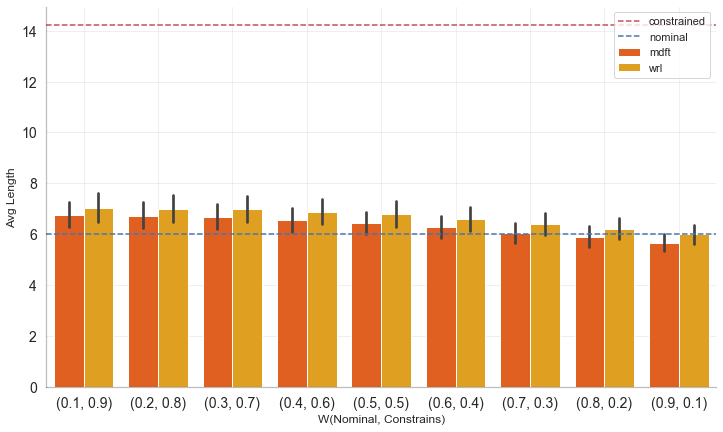

In [59]:
import seaborn as sns
%matplotlib inline
label = "avg_length"

fig=plt.figure(figsize=(12, 7))
#sns.set(font_scale=1.5)
#sns.color_palette("white", as_cmap=True)
#sns.relplot(x="i", y="avg_vc", hue="type", kind="line", ci="sd", data=df);
sns.set_style("white")
g = sns.barplot(x="i", y=label, hue="type", data=df.loc[(df['type']!="constrained") & (df['type']!="nominal")], palette="autumn", ci=95);
g.set_xticks(range(9)) # <--- set the ticks first
g.set_xticklabels([f"({(i+1)/10:0.1f}, {1 - (i+1)/10:0.1f})" for i in range(9)])

constrained_avg_length= np.mean(df.loc[(df['type']=="constrained") & (df['i']==8)][label])
nominal_avg_length= np.mean(df.loc[(df['type']=="nominal") & (df['i']==8)][label])

g.axhline(constrained_avg_length, color='r', linestyle='--', label="constrained")
g.axhline(nominal_avg_length, color='b', linestyle='--', label="nominal")
plt.legend()
plt.grid(alpha=0.3)

plt.gca().spines["top"].set_alpha(0)
plt.gca().spines["bottom"].set_alpha(.3)
plt.gca().spines["right"].set_alpha(0)
plt.gca().spines["left"].set_alpha(.3)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel("W(Nominal, Constrains)")
plt.ylabel("Avg Length")


plt.show()
fig.savefig(os.path.join(save_path, f"avg_length.png"), bbox_inches = 'tight') 

In [ ]:
df.loc[(df['type']!="constrained") & (df['type']!="nominal")]

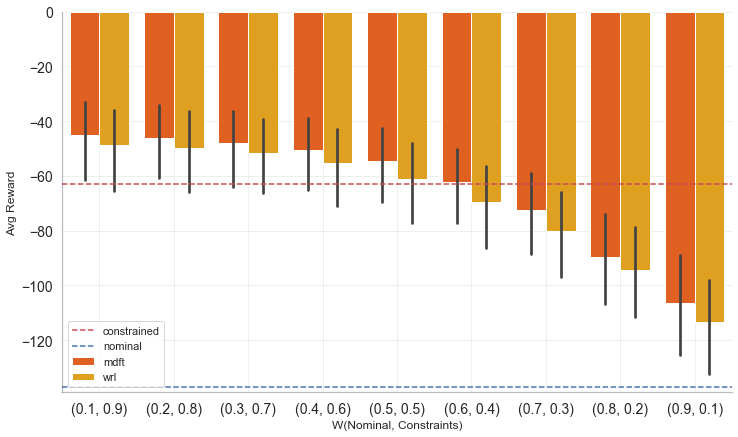

In [60]:
label = "avg_reward"
fig=plt.figure(figsize=(12, 7))
sns.set_theme(style="whitegrid")
#sns.set(font_scale=1.5)
#sns.color_palette("white", as_cmap=True)
#sns.relplot(x="i", y="avg_vc", hue="type", kind="line", ci="sd", data=df);
sns.set_style("white")
g = sns.barplot(x="i", y=label, hue="type", data=df.loc[(df['type']!="constrained") & (df['type']!="nominal")], palette="autumn", ci=95);
g.set_xticks(range(9)) # <--- set the ticks first
g.set_xticklabels([f"({(i+1)/10:0.1f}, {1 - (i+1)/10:0.1f})" for i in range(9)])

constrained_avg_length= np.mean(df.loc[(df['type']=="constrained") & (df['i']==8)][label])
nominal_avg_length= np.mean(df.loc[(df['type']=="nominal") & (df['i']==8)][label])

g.axhline(constrained_avg_length, color='r', linestyle='--', label="constrained")
g.axhline(nominal_avg_length, color='b', linestyle='--', label="nominal")
plt.legend()
plt.grid(alpha=0.3)

plt.gca().spines["top"].set_alpha(0)
plt.gca().spines["bottom"].set_alpha(.3)
plt.gca().spines["right"].set_alpha(0)
plt.gca().spines["left"].set_alpha(.3)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel("W(Nominal, Constraints)")
plt.ylabel("Avg Reward")
plt.show()
fig.savefig(os.path.join(save_path, f"avg_reward.png"), bbox_inches = 'tight') 

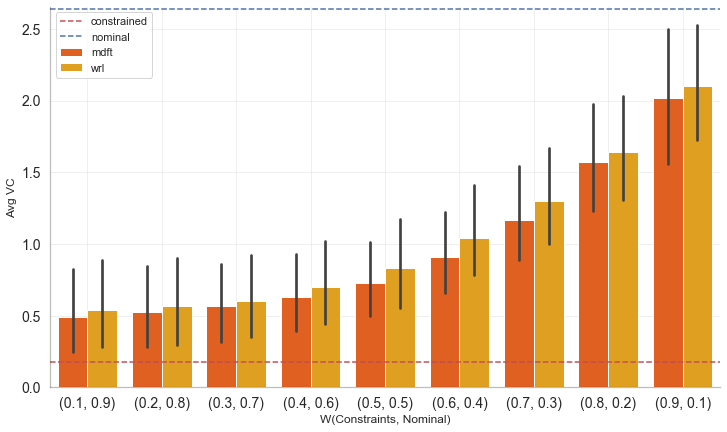

In [56]:
label = "avg_vc"

fig=plt.figure(figsize=(12, 7))
sns.set_theme(style="whitegrid")
#sns.set(font_scale=1.5)
#sns.color_palette("white", as_cmap=True)
#sns.relplot(x="i", y="avg_vc", hue="type", kind="line", ci="sd", data=df);
sns.set_style("white")
g = sns.barplot(x="i", y=label, hue="type", data=df.loc[(df['type']!="constrained") & (df['type']!="nominal")], palette="autumn", ci=95);
g.set_xticks(range(9)) # <--- set the ticks first
g.set_xticklabels([f"({(i+1)/10:0.1f}, {1 - (i+1)/10:0.1f})" for i in range(9)])

constrained_avg_length= np.mean(df.loc[(df['type']=="constrained") & (df['i']==8)][label])
nominal_avg_length= np.mean(df.loc[(df['type']=="nominal") & (df['i']==8)][label])

g.axhline(constrained_avg_length, color='r', linestyle='--', label="constrained")
g.axhline(nominal_avg_length, color='b', linestyle='--', label="nominal")
plt.legend()
plt.grid(alpha=0.3)

plt.gca().spines["top"].set_alpha(0)
plt.gca().spines["bottom"].set_alpha(.3)
plt.gca().spines["right"].set_alpha(0)
plt.gca().spines["left"].set_alpha(.3)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel("W(Constraints, Nominal)")
plt.ylabel("Avg VC")
plt.show()
fig.savefig(os.path.join(save_path, f"avg_vc.png"), bbox_inches = 'tight') 

In [ ]:
fig=plt.figure(figsize=(12, 7))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.set_theme(style="whitegrid")
sns.set(font_scale=2)
sns.color_palette("viridis", as_cmap=True)
#sns.relplot(x="i", y="avg_vc", hue="type", kind="line", ci="sd", data=df);
g=sns.relplot(x="i", y=[i[0] for i in df['avg_js_dist']],  kind="line", data=df, palette="Greens", height=7, aspect=2);
#g.set_xticks(range(9)) # <--- set the ticks first

for ax in g.axes.flat:
    labels = ax.get_xticklabels() # get x labels
    #for i,l in enumerate(labels):
    #    if(i%2 == 0): labels[i] = '' # skip even labels
    ax.set_xticklabels([""]+[f"({(i+1)/10:0.1f}, {1 - (i+1)/10:0.1f})" for i in range(9)]) # set new labels
    
#g.set(xticks=[f"({(i+1)/10:0.1f}, {1 - (i+1)/10:0.1f})" for i in range(9)])

plt.xlabel("W(Constraints, Nominal)")
plt.ylabel("Avg JS dist")
plt.show()
g.savefig(os.path.join(save_path, f"avg_js_dist.png"), bbox_inches = 'tight') 

In [66]:
#learned_params 
#learned_mdp
#demo_l
#n_cfg

ICRL_Result(omega=array([1.01690151e-06, 1.10161537e-06, 1.66949241e-06, 4.93508024e-06,
       1.47157093e-02, 7.40076174e-01, 2.08812299e-01, 2.60021535e-01,
       9.99935244e-07, 1.03045947e-06, 9.28782630e-07, 8.15475323e-07,
       1.08572093e+00, 2.46510751e-03, 3.61047199e-04, 6.10905850e-01,
       4.00334911e-11, 4.34092968e-07, 1.04602722e-06, 2.08245731e-06,
       9.47963896e-07, 3.31585353e+00, 2.40399302e-03, 4.23922438e+00,
       1.48616060e-15, 6.34659209e-08, 1.74387854e-06, 1.03365172e-06,
       6.67259926e-07, 1.09725109e-06, 2.87065331e-19, 1.60960210e-13,
       4.38457995e-21, 9.01290565e-08, 5.97428588e-07, 1.06880701e-06,
       1.01663505e-06, 1.08087174e-06, 6.36846550e-07, 4.47348607e-07,
       5.21649110e-11, 2.60888236e-07, 4.63994411e-07, 7.28786364e-07,
       1.01015252e-06, 1.00182009e-06, 1.01350364e-06, 1.04786830e-06,
       1.19539664e-06, 1.12999847e-06, 1.09856926e-06, 1.01843952e-06,
       1.00517783e-06, 1.00089936e-06, 1.00025873e-06, 1.00

In [ ]:
nominal_matrix['demo_']